# Project 2: First approaches to MultiModal Transformers: Bridging Text with Vision, Audio, and Video

# Objective: 

Instead of treating text, audio, and video as separate streams of information, you will design a **Transformer-based model that intelligently fuses two modalities**—text with images, text with audio, or text with video. Your challenge is to harness the power of deep learning to create a system where each modality enhances the other, unlocking richer, more meaningful insights.

This is more than just training a model—it’s about innovation. How will you design a fusion strategy that truly captures cross-modal relationships? Will your model generate creative text from images, answer questions from audio, or retrieve videos based on descriptions? The decisions are yours to make.

Even if you and your peers work with similar datasets, your approach must be unique. Whether through data choices, architectural modifications, or fusion techniques, your model should push the boundaries of multimodal AI. Experiment boldly, optimize strategically, and most importantly—create something exciting.



# Deliverables:

- A working model (hybrid architecture)
- A structured report (including visuals & reflections) **Required: Include details about your hybrid architecture!!!!**
- A GitHub repository with clean, documented code
---

# Step 1: Select your own adventure

Below is a concise, high-level breakdown of three main multimodal “adventures,” each with several task options and brief notes about potential datasets and implementation tips. This structure makes it easy to pick a project that best fits your interests and available resources—whether you prefer images, audio, or video combined with text. **Required in your reports regardless of the choice picked: Include details about your hybrid architecture!!!!**

## **Choice 1: Images + Text**

### 1. **Image Captioning**
- **Goal:** Automatically generate textual descriptions (captions) for given images.  
- **Potential Datasets:**  
  - **MS COCO** – Large-scale, ~330k images with multiple captions per image.  
  - **Flickr8k/30k** – Smaller datasets; useful for quick iteration.  
- **Implementation Tips:**  
  - Use a **CNN or Vision Transformer** to encode images, then a Transformer decoder for generating text.  
  - Evaluate output with **BLEU, METEOR, or CIDEr**.

### 2. **Visual Question Answering (VQA)**
- **Goal:** Answer open-ended questions about image content (e.g., “How many dogs are in this picture?”).  
- **Potential Datasets:**  
  - **VQA v2** – 204k images and ~1 million Q&A pairs.  
  - **GQA** – Emphasizes compositional reasoning.  
- **Implementation Tips:**  
  - Fuse **image features** (from a CNN/ViT) with **question embeddings** (Transformer for text).  
  - Evaluate with **accuracy** for classification-based answers or **language metrics** for open-ended answers.


### 3. **Image-Text Retrieval**
- **Goal:** Retrieve the most relevant images given a text query, or vice versa.  
- **Potential Datasets:**  
  - **MS COCO** – Commonly used for both captioning and retrieval.  
  - **Flickr30k** – Includes structures suited to retrieval tasks.  
- **Implementation Tips:**  
  - Use **dual encoders** for image and text, trained with a **contrastive loss** to align modalities.  
  - Evaluate with **Recall@K** or **mean rank** metrics.

---

## **Choice 2: Audio + Text**

### 1. **Speech Recognition**
- **Goal:** Convert spoken language (waveforms) into written text transcripts.  
- **Potential Datasets:**  
  - **LibriSpeech** – ~1,000 hours of English audiobook recordings.  
  - **Mozilla Common Voice** – Crowd-sourced, multilingual speech data.  
- **Implementation Tips:**  
  - Convert waveforms into **Mel spectrograms**, or use **wav2vec2** (pretrained).  
  - Evaluate with **Word Error Rate (WER)**.

### 2. **Audio-Text Alignment**
- **Goal:** Match spoken words or segments in an audio file to their written transcripts (often down to timestamps).  
- **Potential Datasets:**  
  - **TEDLIUM** – TED talks with aligned transcripts.  
  - **YouTube** auto-transcripts (though noisier).  
- **Implementation Tips:**  
  - Segment audio frames; align with text tokens.  
  - Use **CTC-based** approaches or techniques like Dynamic Time Warping (DTW).  
  - Applications: **karaoke-style** subtitles, real-time captioning.


### 3. **Spoken Command Classification**
- **Goal:** Identify short, predefined voice commands like “Turn on the light.”  
- **Potential Datasets:**  
  - **Google Speech Commands** – Tens of thousands of short utterances for specific commands.  
- **Implementation Tips:**  
  - A **classification task** (label each audio clip with the intended command).  
  - Evaluate with **accuracy** or **F1 score**.

---

## **Choice 3: Video + Text**

### 1. **Video Captioning**
- **Goal:** Generate textual descriptions for short videos (e.g., “A person cooking pasta”).  
- **Potential Datasets:**  
  - **MSR-VTT** – ~10k short video clips, each with multiple captions.  
  - **YouCook2** – Cooking videos with detailed instructions.  
- **Implementation Tips:**  
  - Sample frames (e.g., 1 fps) for each video.  
  - Encode frames (CNN/ViT) and use a Transformer decoder for text.  
  - Evaluate with **BLEU, METEOR, or CIDEr**.


### 2. **Video Question Answering (Video QA)**
- **Goal:** Answer questions based on video content (objects, actions, context).  
- **Potential Datasets:**  
  - **TVQA** – TV show clips plus questions about dialogue and visuals.  
  - **LSMDC** – Movie clips with descriptions/questions.  
- **Implementation Tips:**  
  - Extract **visual features** from sampled frames; optionally include **subtitles/transcripts**.  
  - Fuse them with question embeddings in a multimodal Transformer.  
  - Evaluate with **accuracy** or open-ended **language metrics**.


### 3. **Text-Based Video Retrieval**
- **Goal:** Find relevant video clips from a database based on a text query (e.g., “Videos of someone playing guitar”).  
- **Potential Datasets:**  
  - **MSR-VTT** – Contains clips plus textual metadata.  
  - **ActivityNet Captions** – Videos with temporal captions.  
- **Implementation Tips:**  
  - Use **dual encoders** or a **joint embedding** space.  
  - Evaluate with **Recall@K**, **MRR** (Mean Reciprocal Rank), or similar retrieval metrics.

---


## **General Reccomendations**


#### 1. **Transformer Architecture**

- **Separate Encoders:** Build one encoder for text and another for your chosen modality. Fuse the resulting embeddings either through cross-attention or by concatenating them, then feeding them into further layers.

- **Learned Modality Embeddings:** Introduce special learned tokens (e.g., [IMAGE], [AUDIO], [VIDEO]) to flag which modality a token or embedding belongs to. This can help the Transformer distinguish between, say, a text token vs. an image patch embedding.

- **Cross-Attention:** If you’re using an encoder–decoder structure (common for generation tasks like captioning), the decoder can attend to both text representations and other modality representations. This is especially potent if your final output is text (e.g., describing an image or transcribing an audio snippet).

- **Positional or Spatial Embeddings:**
Images/Videos: 2D positional embeddings to capture spatial layout.
Audio: Time–frequency positional embeddings to reflect temporal progression.
Text: Standard 1D positional embeddings or relative positioning can suffice.

#### 2. **Fusion Strategy for Multimodality**

- **Concatenation:** The simplest method—just stack text embeddings and modality embeddings along the sequence dimension. Make sure each chunk has a clear positional signal.

- **Attention-based Fusion:**
Let each modality have its own encoder.
Combine them via cross-attention in later layers, where the text representation attends to the image/audio/video representation or vice versa.
You might even try mutual cross-attention for an even richer representation.

- **Late Fusion**: Encode each modality separately, then merge the final embeddings (e.g., by averaging, concatenation, or a learnable projection) to feed into a classification or decoding head.

#### 3. **Training Loop and Objective**

- **Loss Functions**
Text Generation (e.g., captioning): Cross-entropy on the predicted tokens.
Classification (VQA, spoken command classification): Cross-entropy or binary cross-entropy.
Retrieval (matching text to images/ audio/video): Contrastive or triplet loss.

- **Masking**
Carefully handle [PAD] tokens so the attention mechanism ignores those placeholders. Use key padding masks in PyTorch for both the source and target.

- **Training Details**
Use AdamW or a similar optimizer with a suitable learning rate scheduler (e.g., warmup + decay).
Watch your GPU memory usage. If your model or data is large, consider gradient checkpointing or reduce batch size.

---

## **Summary**
Each **Choice** (Images + Text, Audio + Text, or Video + Text) comes with **three distinct tasks** of escalating complexity. Select the modality and task that excite you most and that fit your available computing resources. Focus on building a solid **data pipeline**, leveraging **pretrained models**, and performing **continuous evaluation** to ensure tangible progress over your project timeline. 

### **You will need to research some of the approaches reccomended here, but, believe me, that is the way real world works! Frustration is always allowed!**


---

## Clarification

You **don't** need to develop an interactive application for this project. The demo will serve as a platform to communicate your results.

# Step 2: Submit Your Work

Your submission package should include:

1. **GitHub Repository** (Well-documented code). ``add`` and ``commit`` the final version of your work, and ``push`` your code to your GitHub repository. You can have multiple notebooks. It is up to you.
2. **Project Report** – 4-page IEEE-format paper. Write a paper with no more than 4 pages addressing the architecture, tasks outcomes and reflections. When writing this report, consider a business-oriented person as your reader (e.g. your PhD advisor, your internship manager, etc.). Tell the story for each datasets' goal and tasks covered. **Required: Include details about your hybrid architecture!!!!** Also, include insights about:
- Significance of your implementation
- Accuracy, loss curves, feature importance.
- What worked, what didn’t, what’s next?
- Where could this be applied?

3. **Demo Link or Video** (Showcasing your model’s workflow)
4. **README.md file.** Edit the readme.md file in your repository and how to use your code. Ensure reproducibility (environment requirements, requirements.txt, or environment.yml)


**``Submit the URL of your GitHub Repository as your assignment submission on Canvas.``**



### I am choosing the first option: Image + Text

#### 1. Image Captioning

In [1]:
import pandas as pd
import os
# os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
# os.environ['PYCARET_CUSTOM_LOGGING_LEVEL'] = 'CRITICAL'
import warnings
warnings.filterwarnings('ignore')
import re
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from PIL import Image
# import tensorflow as tf
# import keras
# from keras import layers
# from keras.applications import efficientnet
# from keras.layers import TextVectorization
# from keras.preprocessing.image import load_img, img_to_array
from sklearn.model_selection import train_test_split
from nltk.translate.bleu_score import corpus_bleu
from tqdm import tqdm_notebook
from collections import Counter

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.models as models
from torch.utils.data import DataLoader, Subset
from torch.optim.lr_scheduler import ReduceLROnPlateau
import random

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_gpus = torch.cuda.device_count()
print(device, num_gpus)

#os.environ['CUDA_VISIBLE_DEVICES'] = '0'  # or the ID of the specific GPU you want to use
#os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'


cuda 1


In [23]:
!pip install nltk

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 11.9 MB/s eta 0:00:00


#### Let's understand the data by plotting the captions

Index(['image_name', ' comment_number', ' comment'], dtype='object')


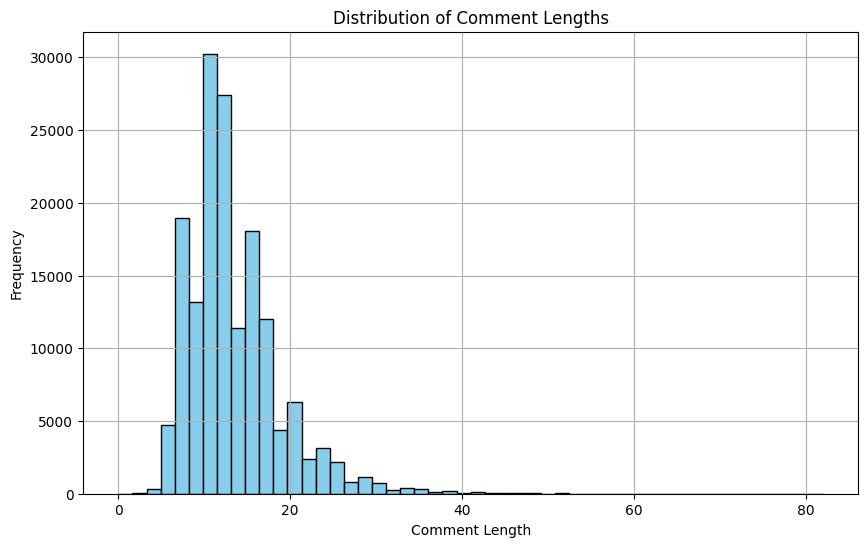

Number of unique words: 20321
longest captions:  Four young adults sit outside on a wooden deck near a building around a small round table , while another person stands on the edge of the deck , leaning on the wooden railing , with the sun shining on one of them and the rest of them are in the shade , two of them crossing their legs , one holding a cellphone out in front of himself and another holding a green and red soda can . 
---------------------------------------------------------------------------
longest captions:  A man wearing a helmet , red pants with white stripes going down the sides and a white and red shirt is on a small bicycle using only his hands while his legs are up in the air , while another man wearing a light blue shirt with dark blue trim and black pants with red stripes going up the sides is standing nearby , gesturing toward the first man and holding a small figurine of one of the seven dwarves . 
----------------------------------------------------------------

In [2]:
# Load the CSV into a pandas DataFrame
CAPTIONS_PATH = "flickr_dataset/flickr30k_images/results.csv"
captions_df = pd.read_csv(CAPTIONS_PATH, on_bad_lines='skip', sep = "|")

# Display the first few rows to inspect the data
print(captions_df.columns)

captions_df['comment'] = captions_df[' comment'].fillna('').astype(str)

#captions_df['comment_length'] = captions_df['comment'].apply(len)
captions_df['comment_length'] = captions_df['comment'].apply(lambda x: len(x.split()))

#Plot the distribution of comment lengths
plt.figure(figsize=(10, 6))
plt.hist(captions_df['comment_length'], bins=50, color='skyblue', edgecolor='black')
plt.title('Distribution of Comment Lengths')
plt.xlabel('Comment Length')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

import nltk
from nltk.tokenize import word_tokenize

# Convert to lowercase and split on spaces
all_words = ' '.join(captions_df['comment'].fillna('')).lower().split()

# Get unique words
unique_words = set(all_words)

# Get the count
num_unique_words = len(unique_words)
print(f'Number of unique words: {num_unique_words}')

for comment in captions_df[captions_df['comment_length'] > 75]['comment']:
    print("longest captions:", comment, "\n" + "-"*75)

In [3]:
# from PIL import Image
# import os

# Get input image size for first 5 images:
IMAGES_PATH='flickr_dataset/flickr30k_images/flickr30k_images'
for i in range(5):

    sample_image_path = os.path.join(IMAGES_PATH, os.listdir(IMAGES_PATH)[i])
    
    # Open the image
    image = Image.open(sample_image_path)
    
    # Get image size (width, height)
    width, height = image.size
    print(f"Image dimensions: {width}x{height}")


Image dimensions: 500x281
Image dimensions: 500x314
Image dimensions: 500x375
Image dimensions: 275x500
Image dimensions: 500x383



#### The word distribution is peaked at ~15. I will choose a cutoff of 30 as majority of the images have caption length less than 30
#### The image sizes are also variable, we will convert everything to 224x224 to make it standardized

In [5]:
IMAGE_SIZE = (224,224)  ### Varible image size in the input images. We have to resize to a fixed size
SEQ_LENGTH = 30   ## remove the images with captions more than 30 words and add paddinf if it is less

#### Prepare train, test and validation dataset

In [6]:
def load_captions_data(filename):
    with open(filename) as caption_file:
        caption_data = caption_file.readlines()[1:]
        caption_mapping = {}
        text_data = []
        images_to_skip = set()

        for line in caption_data:
            line = line.rstrip("\n")
            try:
                img_name, _, caption = line.split("| ")
            except ValueError:
                img_name, caption = line.split("| ")
                caption = caption[4:]
            img_name = os.path.join(IMAGES_PATH, img_name.strip())
            tokens = caption.strip().split()
            if len(tokens) < 4 or len(tokens) > SEQ_LENGTH:
                images_to_skip.add(img_name)
                continue
            if img_name.endswith("jpg") and img_name not in images_to_skip:
                caption = "<start> " + caption.strip() + " <end>"
                text_data.append(caption)

                if img_name in caption_mapping:
                    caption_mapping[img_name].append(caption)
                else:
                    caption_mapping[img_name] = [caption]

        for img_name in images_to_skip:
            if img_name in caption_mapping:
                del caption_mapping[img_name]

        return caption_mapping, text_data

# Split dataset into train, validation, and test sets
def train_val_split(caption_data, validation_size=0.2, test_size=0.02, shuffle=True):
    all_images = list(caption_data.keys())
    if shuffle:
        np.random.seed(42)
        np.random.shuffle(all_images)

    train_keys, validation_keys = train_test_split(all_images, test_size=validation_size, random_state=42)
    validation_keys, test_keys = train_test_split(validation_keys, test_size=test_size, random_state=42)
    
    training_data = {img_name: caption_data[img_name] for img_name in train_keys}
    validation_data = {img_name: caption_data[img_name] for img_name in validation_keys}
    test_data = {img_name: caption_data[img_name] for img_name in test_keys}

    return training_data, validation_data, test_data

In [7]:
# Loading the dataset
captions_mapping, text_data = load_captions_data(CAPTIONS_PATH)
train_data, validation_data, test_data = train_val_split(captions_mapping)
print(f"Total samples: {len(captions_mapping)}")
print(f"Train samples: {len(train_data)}")
print(f"Validation samples: {len(validation_data)}")
print(f"Test samples: {len(test_data)}")

Total samples: 29868
Train samples: 23894
Validation samples: 5854
Test samples: 120


#### Visualize some the entries from the training set

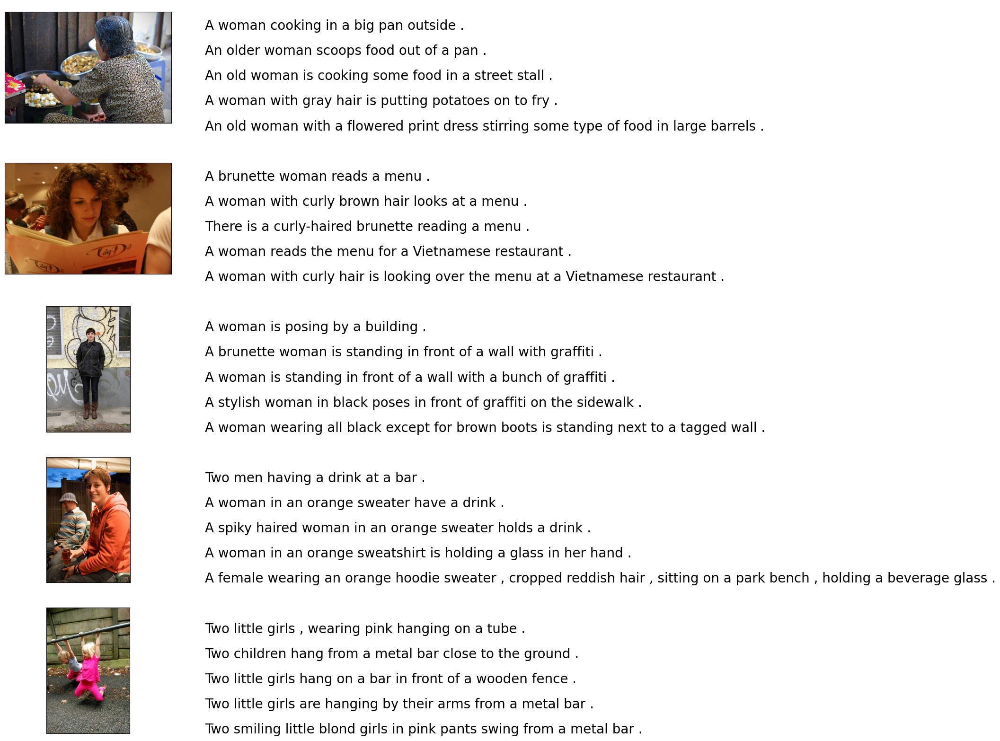

In [8]:
def visualaization(data, num_of_images):
    count = 1
    fig = plt.figure(figsize=(10,20))
    for filename in list(data.keys())[100:100+num_of_images]:
        captions = data[filename]
        image_load = Image.open(filename)

        ax = fig.add_subplot(num_of_images,2,count,xticks=[],yticks=[])
        ax.imshow(image_load)
        count += 1

        ax = fig.add_subplot(num_of_images,2,count)
        plt.axis('off')
        ax.plot()
        ax.set_xlim(0,1)
        ax.set_ylim(0,len(captions))
        for i, caption in enumerate(captions):
            #ax.text(0,i,caption,fontsize=20)
            ax.text(0, i, caption.replace('<start>', '').replace('<end>', '').strip(), fontsize=20)
        plt.savefig('Images_with_original_caption.pdf')
        count += 1
    plt.show()
    
visualaization(train_data, 5)

#### Tokenize the data and prepare it for training

In [9]:
from torch.utils.data import Dataset
from torchvision import transforms
from PIL import Image
import torch
from transformers import BertTokenizer


class Flickr30kDataset(torch.utils.data.Dataset):
    def __init__(self, data_dict, transform, tokenizer, max_length=30):
        self.data_dict = data_dict
        self.transform = transform
        self.tokenizer = tokenizer
        self.max_length = max_length
        self.image_paths = list(data_dict.keys())
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        captions = self.data_dict[img_path]
        
        # Randomly select one caption for the image
        caption = random.choice(captions)
        
        # Load and transform the image
        try:
            image = Image.open(img_path).convert("RGB")
            image = self.transform(image)
        except Exception as e:
            print(f"Error loading image {img_path}: {str(e)}")
            # Return a placeholder image
            image = torch.zeros((3, 224, 224))
        
        # Tokenize the caption
        tokens = self.tokenizer.encode(
            caption,
            add_special_tokens=True,
            max_length=self.max_length,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        ).squeeze(0)
        
        return image, tokens



In [10]:
# Image transformation
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # ImageNet stats
])

# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Create datasets
train_dataset = Flickr30kDataset(data_dict=train_data, transform=transform, tokenizer=tokenizer)
val_dataset = Flickr30kDataset(data_dict=validation_data, transform=transform, tokenizer=tokenizer)
test_dataset = Flickr30kDataset(data_dict=test_data, transform=transform, tokenizer=tokenizer)

# Create DataLoader
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)

print(train_loader)


#### Build a model for image caption generation. For the image part, we are useing pretrained resnet50 for encoding the image and for the text part, we are building a transformer decoder. We are using attention on individual space and texts are updated based on images as static memory. However, we are not using sophistifaced cross attention where both image and text emdedding updates one another

In [95]:
import torch.nn as nn
import torchvision.models as models


class ImageEncoder(nn.Module):
    def __init__(self, embed_size):
        super(ImageEncoder, self).__init__()
        resnet = models.resnet50(pretrained=True)
        modules = list(resnet.children())[:-2]  # Remove fully connected layer
        self.cnn = nn.Sequential(*modules)
        self.adaptive_pool = nn.AdaptiveAvgPool2d((1, 1))  # Ensure output is (batch, 2048, 1, 1)
        self.fc = nn.Linear(2048, embed_size)  # Reduce to embedding size
        
    def forward(self, images):
        features = self.cnn(images)  # Output shape: (batch, 2048, 7, 7)
        #print("CNN output shape:", features.shape)
        features = self.adaptive_pool(features)  # Now shape is (batch, 2048, 1, 1)
        #print("CNN output shape after pool:", features.shape)
        features = features.view(features.size(0), -1)  # Flatten to (batch, 2048)
        #print("CNN output shape flattening:", features.shape)
        features = self.fc(features)  # Output shape: (batch, embed_size)
        return features
        

In [96]:
import torch
import torch.nn.functional as F

class TransformerDecoder(nn.Module):
    def __init__(self, embed_size, vocab_size, embedding_dim, nhead, num_layers):
        super(TransformerDecoder, self).__init__()
        
        # Embedding layer for captions
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        
        # Positional encoding
        self.embed_size = embedding_dim
        max_len = 100  # Maximum sequence length
        pe = torch.zeros(max_len, embedding_dim)
        position = torch.arange(0, max_len).unsqueeze(1).float()
        div_term = torch.exp(torch.arange(0, embedding_dim, 2).float() * -(torch.log(torch.tensor(10000.0)) / embedding_dim))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe.unsqueeze(0))  # Shape: [1, max_len, embedding_dim]
        
        # Transformer decoder
        decoder_layer = nn.TransformerDecoderLayer(d_model=embedding_dim, nhead=nhead)
        self.transformer_decoder = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)
        
        # Output linear layer
        self.fc_out = nn.Linear(embedding_dim, vocab_size)

    def forward(self, image_features, captions):
        # Embedding captions
        embedded = self.embedding(captions)  # Shape: [batch_size, seq_len, embedding_dim]
        
        # Add positional encoding
        seq_len = embedded.size(1)
        positional_encoding = self.pe[:, :seq_len, :]  # Shape: [1, seq_len, embedding_dim]
        embedded = embedded + positional_encoding
        
        # Prepare for transformer (requires [seq_len, batch_size, embedding_dim])
        embedded = embedded.permute(1, 0, 2)
        
        # Prepare image features as memory for the transformer decoder
        # Need to repeat the image features to act as memory for each position
        # Shape of image_features: [batch_size, embed_size]
        memory = image_features.unsqueeze(0).repeat(seq_len, 1, 1)  # Shape: [seq_len, batch_size, embed_size]
        
        # Create a mask to prevent attention to future tokens
        mask = self.generate_square_subsequent_mask(seq_len).to(embedded.device)
        
        # Transformer decoder (output shape: [seq_len, batch_size, embedding_dim])
        transformer_output = self.transformer_decoder(embedded, memory, tgt_mask=mask)
        
        # Permute back to [batch_size, seq_len, embedding_dim]
        transformer_output = transformer_output.permute(1, 0, 2)
        
        # Project to vocabulary size
        output = self.fc_out(transformer_output)  # Shape: [batch_size, seq_len, vocab_size]
        
        return output
        
    def generate_square_subsequent_mask(self, sz):
        # Generate a square mask for the sequence to prevent attending to future tokens
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask


## Cross attention: more expensive. We are not using here

class CrossAttentionTransformerDecoder(nn.Module):
    def __init__(self, embed_size, vocab_size, embedding_dim, nhead, num_layers, max_text_len=100):
        super().__init__()
        
        # Text embedding
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        
        # Image projection to match text embedding dimensions
        self.image_projection = nn.Linear(embed_size, embedding_dim)
        
        # Positional encoding
        self.positional_encoding = self.create_positional_encoding(embedding_dim, max_text_len + 1)  # +1 for image token
        
        # Transformer decoder layers with cross-attention
        decoder_layer = nn.TransformerDecoderLayer(
            d_model=embedding_dim, 
            nhead=nhead,
            dim_feedforward=embedding_dim * 4,  # Typically 4x embedding dim
            dropout=0.1
        )
        self.transformer_decoder = nn.TransformerDecoder(decoder_layer, num_layers)
        
        # Output layer
        self.fc_out = nn.Linear(embedding_dim, vocab_size)
    
    def create_positional_encoding(self, embed_size, max_len=101):
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, embed_size, 2).float() * -(torch.log(torch.tensor(10000.0)) / embed_size))
        pe = torch.zeros(max_len, embed_size)
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        return pe.unsqueeze(0)
    
    def forward(self, image_features, captions):
        # Project image features to text embedding dimension
        projected_image = self.image_projection(image_features)  # [batch_size, embedding_dim]
        
        # Embed captions
        text_embeds = self.embedding(captions)  # [batch_size, seq_len, embedding_dim]
        
        # Concatenate image token with text tokens
        # Add a special image token at the beginning
        image_token = projected_image.unsqueeze(1)  # [batch_size, 1, embedding_dim]
        combined_embeds = torch.cat([image_token, text_embeds], dim=1)
        
        # Add positional encoding
        seq_len = combined_embeds.size(1)
        pos_encoding = self.positional_encoding[:, :seq_len, :].to(combined_embeds.device)
        combined_embeds = combined_embeds + pos_encoding
        
        # Prepare for transformer (requires [seq_len, batch_size, embedding_dim])
        combined_embeds = combined_embeds.permute(1, 0, 2)
        
        # Create mask to prevent attending to future tokens (now including the image token)
        mask = self.generate_square_subsequent_mask(seq_len).to(combined_embeds.device)
        
        # Transformer decoder
        # Use combined_embeds as both target and memory to enable cross-attention
        transformer_output = self.transformer_decoder(
            tgt=combined_embeds,  # Target sequence (image + text)
            memory=combined_embeds,  # Memory (same as target for cross-attention)
            tgt_mask=mask  # Mask to prevent attending to future tokens
        )
        
        # Permute back and remove image token
        transformer_output = transformer_output.permute(1, 0, 2)[:, 1:, :]
        
        # Project to vocabulary size
        output = self.fc_out(transformer_output)
        
        return output
    
    def generate_square_subsequent_mask(self, sz):
        # Generate a square mask for the sequence to prevent attending to future tokens
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask

In [23]:
# If we want to use the cross attention, this class need to be modified. 
class ImageCaptioningModel(nn.Module):
    def __init__(self, vocab_size, embed_size, embedding_dim, nhead, num_layers):
        super(ImageCaptioningModel, self).__init__()
        self.image_encoder = ImageEncoder(embed_size)
        self.transformer_decoder = TransformerDecoder(
        #self.transformer_decoder = CrossAttentionTransformerDecoder(
            embed_size=embed_size,
            vocab_size=vocab_size,
            embedding_dim=embedding_dim,
            nhead=nhead,
            num_layers=num_layers
        )
        
    def forward(self, images, captions):
        image_features = self.image_encoder(images)
        output = self.transformer_decoder(image_features, captions)
        return output


In [16]:
def train(model, train_loader, val_loader, criterion, optimizer, num_epochs, device, vocab_size):
    # Lists to store losses for plotting
    train_losses = []
    val_losses = []
    
    for epoch in range(num_epochs):
        model.train()
        total_train_loss = 0
        
        for images, captions in tqdm(iter(train_loader), total=len(train_loader)):
            images = images.to(device)
            captions = captions.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass (exclude last token from input)
            outputs = model(images, captions[:, :-1])
            
            # Reshape outputs and captions for loss calculation
            outputs = outputs.contiguous().view(-1, vocab_size)
            targets = captions[:, 1:].contiguous().view(-1)  # Skip the first token (usually BOS)
            
            # Calculate loss
            loss = criterion(outputs, targets)
            loss.backward()
            
            # Clip gradients to avoid exploding gradients
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            
            total_train_loss += loss.item()
        
        avg_train_loss = total_train_loss / len(train_loader)
        
        # Validate the model
        model.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, captions in tqdm(iter(val_loader), total=len(val_loader)):
                images = images.to(device)
                captions = captions.to(device)
                
                # Forward pass
                outputs = model(images, captions[:, :-1])
                
                # Reshape outputs and captions for loss calculation
                outputs = outputs.contiguous().view(-1, vocab_size)
                targets = captions[:, 1:].contiguous().view(-1)
                
                # Calculate loss
                loss = criterion(outputs, targets)
                total_val_loss += loss.item()
        
        avg_val_loss = total_val_loss / len(val_loader)
        
        # Save the losses for plotting
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
        
        # Save checkpoint
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, f"checkpoint_epoch_{epoch+1}.pth")
    
    return train_losses, val_losses

    

In [17]:
# Initialize model parameters
embed_size = 512        # Embedding size for image features
embedding_dim = 512     # Embedding dimension for captions
nhead = 8               # Number of attention heads
num_layers = 6          # Number of transformer layers
vocab_size = tokenizer.vocab_size

# Create the image captioning model
model = ImageCaptioningModel(
    vocab_size=vocab_size,
    embed_size=embed_size,
    embedding_dim=embedding_dim,
    nhead=nhead,
    num_layers=num_layers
)
print(model)

ImageCaptioningModel(
  (image_encoder): ImageEncoder(
    (cnn): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inpl

In [76]:
# Move model to device (GPU if available, otherwise CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# Now you can start training
train_losses, val_losses = train(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    num_epochs=10,
    device=device,
    vocab_size=vocab_size
)


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [06:47<00:00,  2.23s/it]


Epoch 1/10, Train Loss: 3.2162, Val Loss: 2.6845


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [03:57<00:00,  1.30s/it]


Epoch 2/10, Train Loss: 2.5762, Val Loss: 2.4546


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [05:32<00:00,  1.82s/it]


Epoch 3/10, Train Loss: 2.3801, Val Loss: 2.3451


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [04:08<00:00,  1.36s/it]


Epoch 4/10, Train Loss: 2.2581, Val Loss: 2.2736


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [04:00<00:00,  1.32s/it]


Epoch 5/10, Train Loss: 2.1709, Val Loss: 2.1998


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [04:21<00:00,  1.43s/it]


Epoch 6/10, Train Loss: 2.0858, Val Loss: 2.1554


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [04:10<00:00,  1.37s/it]


Epoch 7/10, Train Loss: 2.0162, Val Loss: 2.1253


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [04:24<00:00,  1.44s/it]


Epoch 8/10, Train Loss: 1.9657, Val Loss: 2.1094


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [06:22<00:00,  2.09s/it]


Epoch 9/10, Train Loss: 1.9152, Val Loss: 2.0915


100%|████████████████████████████████████████████████████████████████████████████████████| 183/183 [03:57<00:00,  1.30s/it]


Epoch 10/10, Train Loss: 1.8733, Val Loss: 2.0576


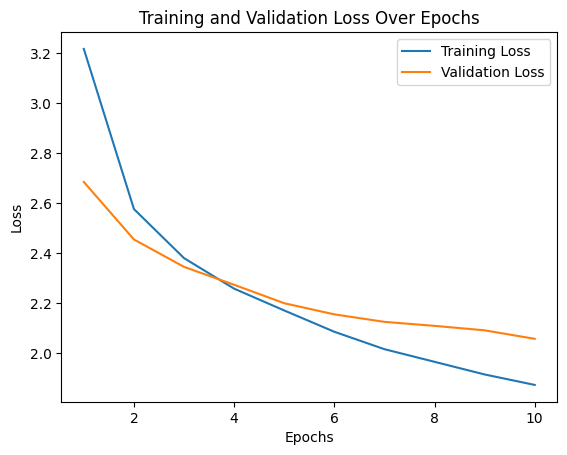

In [77]:
# After training, you can plot the losses
import matplotlib.pyplot as plt
num_epochs=10
plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.savefig('training_curve.png')
plt.show()

#### So, training for 10 epochs are done. Training loss still seems to reduce significantly, however, validation loss does not decrease much. It could be a sign of overfitting. Let's see how the train model perform using different metrices such as BLEUs and METEOR

[nltk_data] Downloading package punkt to /home/amondal2/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amondal2/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amondal2/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
2025-04-04 15:07:13.648327: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-04 15:07:18.428785: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743800839.704173 4010958 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plu

Evaluation Metrics:
BLEU-1: 33.76%
BLEU-2: 20.96%
BLEU-3: 13.31%
BLEU-4: 7.86%
METEOR: 31.68%


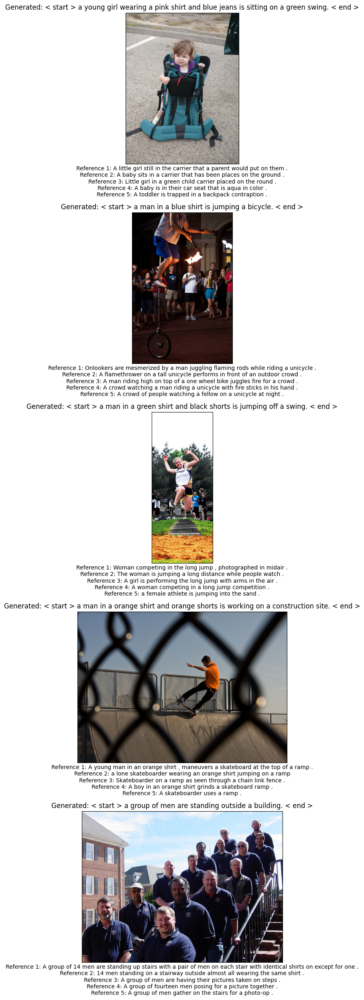

In [18]:
import torch
import numpy as np
from PIL import Image
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu
from nltk.translate.meteor_score import meteor_score
from tqdm import tqdm
import os

def load_model(model_path, model_class, device):
    """
    Load a trained model from checkpoint
    """
    checkpoint = torch.load(model_path, map_location=device)
    model = model_class(
        vocab_size=tokenizer.vocab_size,
        embed_size=512,
        embedding_dim=512,
        nhead=8,
        num_layers=6
    )
    model.load_state_dict(checkpoint['model_state_dict'])
    model = model.to(device)
    model.eval()
    return model

def generate_caption(model, image_path, tokenizer, transform, max_length=30, device="cuda"):
    """
    Generate a caption for a given image
    """
    # Load and preprocess the image
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0).to(device)
    
    # Initialize caption generation with start token
    start_token_id = tokenizer.convert_tokens_to_ids(['[CLS]'])[0]
    caption = torch.tensor([[start_token_id]]).to(device)
    
    # Image encoding
    with torch.no_grad():
        image_features = model.image_encoder(image)
    
    # Generate caption word by word
    for _ in range(max_length):
        with torch.no_grad():
            output = model(image, caption)
            # Get the next word prediction (last token)
            predicted = output[:, -1, :].argmax(dim=1, keepdim=True)
            
            # Append the predicted word to the caption
            caption = torch.cat([caption, predicted], dim=1)
            
            # Stop if end token is predicted
            if predicted.item() == tokenizer.sep_token_id:
                break
    
    # Convert caption from token ids to text
    caption_text = tokenizer.decode(caption[0].tolist(), skip_special_tokens=True)
    return caption_text

def evaluate_model(model, test_data, tokenizer, transform, device="cuda"):
    """
    Evaluate the model on test data and calculate BLEU scores
    """
    references = []
    hypotheses = []
    
    for img_path, captions in tqdm(test_data.items()):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Process reference captions
        reference_captions = []
        for caption in captions:
            # Clean up reference caption - remove <start> and <end>
            clean_caption = caption.replace("<start>", "").replace("<end>", "").strip()
            reference_captions.append(clean_caption.split())
        
        # Process generated caption
        generated_caption = generated_caption.split()
        
        # Add to lists for corpus calculation
        references.append(reference_captions)
        hypotheses.append(generated_caption)
    
    # Calculate BLEU scores
    bleu1 = corpus_bleu(references, hypotheses, weights=(1, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    
    # Calculate METEOR score
    meteor_scores = []
    for i in range(len(references)):
        score = meteor_score(references[i], hypotheses[i])
        meteor_scores.append(score)
    meteor_avg = np.mean(meteor_scores)
    
    return {
        'BLEU-1': bleu1 * 100,
        'BLEU-2': bleu2 * 100,
        'BLEU-3': bleu3 * 100,
        'BLEU-4': bleu4 * 100,
        'METEOR': meteor_avg * 100
    }

def visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device="cuda"):
    """
    Visualize some example predictions
    """
    import matplotlib.pyplot as plt
    import random
    
    # Select random images from test data
    img_paths = list(test_data.keys())
    selected_paths = random.sample(img_paths, min(num_examples, len(img_paths)))
    
    fig, axes = plt.subplots(num_examples, 1, figsize=(15, 5*num_examples))
    
    for i, img_path in enumerate(selected_paths):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Reference captions
        reference_captions = [caption.replace("<start>", "").replace("<end>", "").strip() 
                             for caption in test_data[img_path]]
        
        # Display image and captions
        img = Image.open(img_path).convert("RGB")
        if num_examples > 1:
            ax = axes[i]
        else:
            ax = axes
            
        ax.imshow(img)
        ax.set_title(f"Generated: {generated_caption}")
        caption_text = "\n".join([f"Reference {j+1}: {ref}" for j, ref in enumerate(reference_captions)])
        ax.set_xlabel(caption_text)
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.savefig("caption_examples.png")
    plt.show()


def prepare_nltk_data():
    """
    Download and verify required NLTK data packages
    """
    import nltk
    import ssl
    
    # Try to work around SSL certificate issues that sometimes occur
    try:
        _create_unverified_https_context = ssl._create_unverified_context
    except AttributeError:
        pass
    else:
        ssl._create_default_https_context = _create_unverified_https_context
    
    # Download required packages
    nltk.download('punkt', quiet=False)
    nltk.download('wordnet', quiet=False)
    nltk.download('omw-1.4', quiet=False)
    
    # Verify packages are properly installed
    try:
        from nltk.corpus import wordnet
        synsets = wordnet.synsets('test')
        if not synsets:
            print("WARNING: WordNet seems installed but returned no synsets - this may indicate a problem")
    except LookupError:
        print("ERROR: WordNet isn't properly installed despite download attempt")
        print("If you're running in a restricted environment, you may need to:")
        print("1. Download the data manually on another machine")
        print("2. Copy the 'nltk_data' directory to one of the search paths listed in the error")

# Alternative evaluation function without METEOR to avoid WordNet dependency
def evaluate_model_bleu_only(model, test_data, tokenizer, transform, device="cuda"):
    """
    Evaluate the model on test data using only BLEU scores (no METEOR)
    """
    references = []
    hypotheses = []
    
    for img_path, captions in tqdm(test_data.items()):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Process reference captions
        reference_captions = []
        for caption in captions:
            # Clean up reference caption - remove <start> and <end>
            clean_caption = caption.replace("<start>", "").replace("<end>", "").strip()
            reference_captions.append(clean_caption.split())
        
        # Process generated caption
        generated_caption = generated_caption.split()
        
        # Add to lists for corpus calculation
        references.append(reference_captions)
        hypotheses.append(generated_caption)
    
    # Calculate BLEU scores
    bleu1 = corpus_bleu(references, hypotheses, weights=(1, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    
    return {
        'BLEU-1': bleu1 * 100,
        'BLEU-2': bleu2 * 100,
        'BLEU-3': bleu3 * 100,
        'BLEU-4': bleu4 * 100
    }

# Update in your main function:
def main():
    # Prepare NLTK data
    prepare_nltk_data()
    
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Load model
    checkpoint_path = "checkpoint_epoch_10.pth"  # Update with your checkpoint path
    model = load_model(checkpoint_path, ImageCaptioningModel, device)
    
    try:
        # Try to evaluate with BLEU and METEOR
        metrics = evaluate_model(model, test_data, tokenizer, transform, device=device)
    except LookupError as e:
        print(f"Error with full evaluation: {e}")
        print("Falling back to BLEU-only evaluation")
        # Fall back to BLEU-only evaluation
        metrics = evaluate_model_bleu_only(model, test_data, tokenizer, transform, device=device)
    
    print("Evaluation Metrics:")
    for metric_name, score in metrics.items():
        print(f"{metric_name}: {score:.2f}%")
    
    # Visualize some examples
    visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device=device)

if __name__ == "__main__":
    main()

In [19]:
### Let's see how it performs on a image outside this dataset

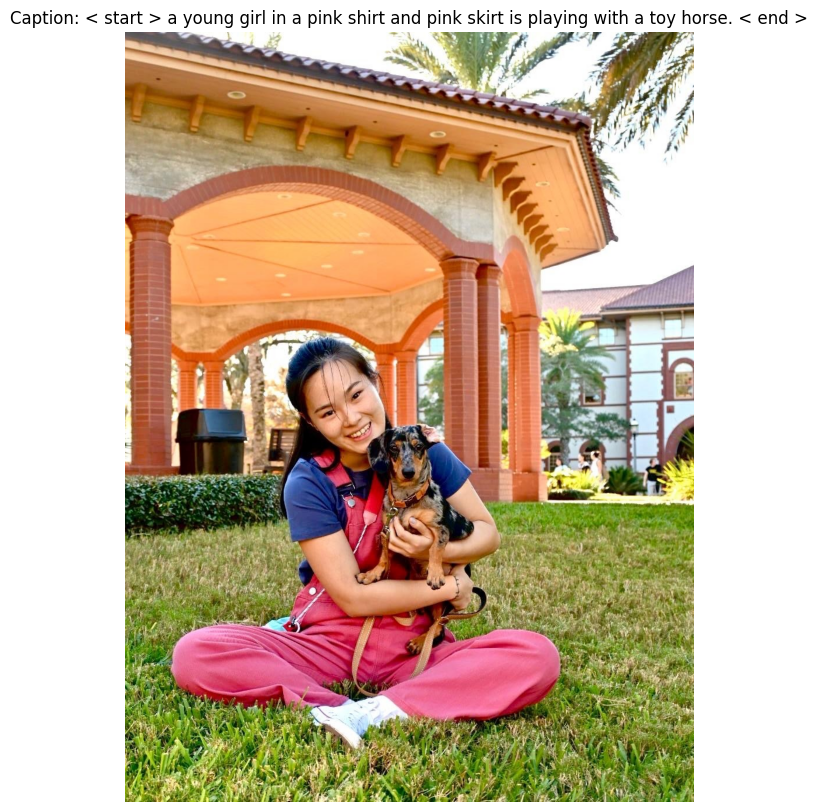

Generated caption: < start > a young girl in a pink shirt and pink skirt is playing with a toy horse. < end >


In [21]:
def caption_single_image(image_path, model, tokenizer, transform, max_length=30, device="cuda"):
    """
    Generate caption for a single custom image
    """
    # Load and preprocess the image
    try:
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image).unsqueeze(0).to(device)
        
        # Set model to evaluation mode
        model.eval()
        
        # Start with BERT's [CLS] token (equivalent to <start> in your training)
        start_token = tokenizer.cls_token_id
        caption = torch.tensor([[start_token]]).to(device)
        
        # Generate caption token by token
        with torch.no_grad():
            # Get image features
            image_features = model.image_encoder(image_tensor)
            
            # Generate tokens one by one
            for _ in range(max_length):
                # Get model prediction
                output = model.transformer_decoder(image_features, caption)
                
                # Get the next word prediction (last token)
                predicted = output[:, -1, :].argmax(dim=1, keepdim=True)
                
                # Append the predicted token to the caption
                caption = torch.cat([caption, predicted], dim=1)
                
                # Stop if end token is predicted (BERT's [SEP] token)
                if predicted.item() == tokenizer.sep_token_id:
                    break
        
        # Convert tokens to text
        caption_text = tokenizer.decode(caption[0], skip_special_tokens=True)
        
        # Display the image and caption
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.title(f"Caption: {caption_text}")
        plt.axis('off')
        plt.show()
        
        return caption_text
        
    except Exception as e:
        print(f"Error processing image: {str(e)}")
        return None

# Usage example:
# First load your model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
checkpoint_path = "checkpoint_epoch_10.pth"
model = load_model(checkpoint_path, ImageCaptioningModel, device)
#
# Then generate caption for your image
test_image_path = "generate_test.JPG"
caption = caption_single_image(test_image_path, model, tokenizer, transform, device=device)
print(f"Generated caption: {caption}")

#### Okay, the BLEU score and METEOR score above >30% is very good considering how small of a dataset we are using. However, there are still room for improvements. Let's try the cross attention model and see if we can improve 

In [13]:
class ImageEncoder(nn.Module):
    def __init__(self, embed_size):
        super(ImageEncoder, self).__init__()
        # Use a pre-trained ResNet model
        resnet = models.resnet50(pretrained=True)
        # Remove the last fully connected layer
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        
        # Add a projection layer to get the desired embedding size
        self.linear = nn.Linear(resnet.fc.in_features, embed_size)
        self.bn = nn.BatchNorm1d(embed_size)
        self.dropout = nn.Dropout(0.5)
        
        # Freeze the ResNet parameters to speed up training
        for param in self.resnet.parameters():
            param.requires_grad = False
            
    def forward(self, images):
        # Extract features from the image
        with torch.no_grad():
            features = self.resnet(images)
        
        # Reshape features to [batch_size, resnet.fc.in_features]
        features = features.view(features.size(0), -1)
        
        # Project features to embed_size dimension
        features = self.linear(features)
        features = self.bn(features)
        features = self.dropout(features)
        
        return features

In [14]:
class CrossAttentionTransformerDecoder(nn.Module):
    def __init__(self, embed_size, vocab_size, embedding_dim, nhead, num_layers):
        super(CrossAttentionTransformerDecoder, self).__init__()
        
        # Embedding layer for captions
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        
        # Positional encoding
        self.embed_size = embedding_dim
        max_len = 100  # Maximum sequence length
        pe = torch.zeros(max_len, embedding_dim)
        position = torch.arange(0, max_len).unsqueeze(1).float()
        div_term = torch.exp(torch.arange(0, embedding_dim, 2).float() * -(torch.log(torch.tensor(10000.0)) / embedding_dim))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe.unsqueeze(0))  # Shape: [1, max_len, embedding_dim]
        
        # Linear layer to project image features to match decoder dimensions
        self.img_projection = nn.Linear(embed_size, embedding_dim)
        
        # Custom transformer decoder layers with cross-attention
        self.decoder_layers = nn.ModuleList([
            DecoderLayerWithCrossAttention(embedding_dim, nhead)
            for _ in range(num_layers)
        ])
        
        # Output linear layer
        self.fc_out = nn.Linear(embedding_dim, vocab_size)
        
    def forward(self, image_features, captions):
        # Embedding captions
        embedded = self.embedding(captions)  # Shape: [batch_size, seq_len, embedding_dim]
        
        # Add positional encoding
        seq_len = embedded.size(1)
        positional_encoding = self.pe[:, :seq_len, :]  # Shape: [1, seq_len, embedding_dim]
        embedded = embedded + positional_encoding
        
        # Project image features to match embedding dimension
        image_features = self.img_projection(image_features)  # Shape: [batch_size, embedding_dim]
        
        # Create self-attention mask to prevent attention to future tokens
        tgt_mask = self.generate_square_subsequent_mask(seq_len).to(embedded.device)
        
        # Process through decoder layers
        output = embedded
        for decoder_layer in self.decoder_layers:
            output = decoder_layer(output, image_features, tgt_mask)
        
        # Project to vocabulary size
        output = self.fc_out(output)  # Shape: [batch_size, seq_len, vocab_size]
        
        return output
    
    def generate_square_subsequent_mask(self, sz):
        # Generate a square mask for the sequence to prevent attending to future tokens
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask


In [15]:
class DecoderLayerWithCrossAttention(nn.Module):
    def __init__(self, d_model, nhead, dropout=0.1):
        super(DecoderLayerWithCrossAttention, self).__init__()
        
        # Self-attention
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.norm1 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        
        # Cross-attention between text and image features
        self.cross_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.norm2 = nn.LayerNorm(d_model)
        self.dropout2 = nn.Dropout(dropout)
        
        # Feed-forward network
        self.ffn = nn.Sequential(
            nn.Linear(d_model, 4 * d_model),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(4 * d_model, d_model)
        )
        self.norm3 = nn.LayerNorm(d_model)
        self.dropout3 = nn.Dropout(dropout)
        
    def forward(self, tgt, memory, tgt_mask=None):
        # Self-attention
        tgt2 = self.self_attn(
            query=tgt.transpose(0, 1),
            key=tgt.transpose(0, 1),
            value=tgt.transpose(0, 1),
            attn_mask=tgt_mask
        )[0].transpose(0, 1)
        tgt = self.norm1(tgt + self.dropout1(tgt2))
        
        # Cross-attention between text and image
        # Expand image features to be compatible with text sequence
        batch_size, seq_len, d_model = tgt.size()
        expanded_memory = memory.unsqueeze(1).expand(-1, seq_len, -1)  # [batch_size, seq_len, d_model]
        
        # Prepare for cross-attention
        q = tgt.transpose(0, 1)  # [seq_len, batch_size, d_model]
        k = expanded_memory.transpose(0, 1)  # [seq_len, batch_size, d_model]
        v = expanded_memory.transpose(0, 1)  # [seq_len, batch_size, d_model]
        
        # Apply cross-attention
        tgt2 = self.cross_attn(q, k, v)[0].transpose(0, 1)
        tgt = self.norm2(tgt + self.dropout2(tgt2))
        
        # Feed-forward network
        tgt2 = self.ffn(tgt)
        tgt = self.norm3(tgt + self.dropout3(tgt2))
        
        return tgt


In [16]:
class ImageCaptioningModelWithCrossAttention(nn.Module):
    def __init__(self, vocab_size, embed_size, embedding_dim, nhead, num_layers):
        super(ImageCaptioningModelWithCrossAttention, self).__init__()
        
        self.image_encoder = ImageEncoder(embed_size)
        self.transformer_decoder = CrossAttentionTransformerDecoder(
            embed_size=embed_size,
            vocab_size=vocab_size,
            embedding_dim=embedding_dim,
            nhead=nhead,
            num_layers=num_layers
        )
        
    def forward(self, images, captions):
        image_features = self.image_encoder(images)
        output = self.transformer_decoder(image_features, captions)
        return output

In [27]:
def train(model, train_loader, val_loader, criterion, optimizer, num_epochs, device, vocab_size):
    # Lists to store losses for plotting
    train_losses = []
    val_losses = []
    
    for epoch in range(num_epochs):
        model.train()
        total_train_loss = 0
        
        for images, captions in tqdm(iter(train_loader), total=len(train_loader)):
            images = images.to(device)
            captions = captions.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass (exclude last token from input)
            outputs = model(images, captions[:, :-1])
            
            # Reshape outputs and captions for loss calculation
            outputs = outputs.contiguous().view(-1, vocab_size)
            targets = captions[:, 1:].contiguous().view(-1)  # Skip the first token (usually BOS)
            
            # Calculate loss
            loss = criterion(outputs, targets)
            loss.backward()
            
            # Clip gradients to avoid exploding gradients
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            
            total_train_loss += loss.item()
        
        avg_train_loss = total_train_loss / len(train_loader)
        
        # Validate the model
        model.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, captions in tqdm(iter(val_loader), total=len(val_loader)):
                images = images.to(device)
                captions = captions.to(device)
                
                # Forward pass
                outputs = model(images, captions[:, :-1])
                
                # Reshape outputs and captions for loss calculation
                outputs = outputs.contiguous().view(-1, vocab_size)
                targets = captions[:, 1:].contiguous().view(-1)
                
                # Calculate loss
                loss = criterion(outputs, targets)
                total_val_loss += loss.item()
        
        avg_val_loss = total_val_loss / len(val_loader)
        
        # Save the losses for plotting
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
        
        # Save checkpoint
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, f"CA2_checkpoint_epoch_{epoch+1}.pth")
    
    return train_losses, val_losses

# Initialize model parameters
embed_size = 512        # Embedding size for image features
embedding_dim = 512     # Embedding dimension for captions
nhead = 8               # Number of attention heads
num_layers = 6          # Number of transformer layers
vocab_size = tokenizer.vocab_size

# Create the image captioning model
model = ImageCaptioningModelWithCrossAttention(
    vocab_size=vocab_size,
    embed_size=embed_size,
    embedding_dim=embedding_dim,
    nhead=nhead,
    num_layers=num_layers
)
print(model)

ImageCaptioningModelWithCrossAttention(
  (image_encoder): ImageEncoder(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      

In [28]:
from tqdm import tqdm
# Move model to device (GPU if available, otherwise CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Define loss function and optimizer - this stays exactly the same
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

# Now you can start training with your existing train function
train_losses, val_losses = train(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    num_epochs=30,
    device=device,
    vocab_size=vocab_size
)

100%|██████████| 183/183 [05:20<00:00,  1.75s/it]


Epoch 1/30, Train Loss: 3.2358, Val Loss: 2.6924


100%|██████████| 183/183 [04:12<00:00,  1.38s/it]


Epoch 2/30, Train Loss: 2.5925, Val Loss: 2.4549


100%|██████████| 183/183 [03:14<00:00,  1.06s/it]


Epoch 3/30, Train Loss: 2.4169, Val Loss: 2.3535


100%|██████████| 183/183 [03:12<00:00,  1.05s/it]


Epoch 4/30, Train Loss: 2.3050, Val Loss: 2.2657


100%|██████████| 183/183 [03:05<00:00,  1.01s/it]


Epoch 5/30, Train Loss: 2.2295, Val Loss: 2.2029


100%|██████████| 183/183 [03:06<00:00,  1.02s/it]


Epoch 6/30, Train Loss: 2.1680, Val Loss: 2.1688


100%|██████████| 183/183 [03:07<00:00,  1.03s/it]


Epoch 7/30, Train Loss: 2.1181, Val Loss: 2.1415


100%|██████████| 183/183 [02:33<00:00,  1.19it/s]


Epoch 8/30, Train Loss: 2.0745, Val Loss: 2.1031


100%|██████████| 183/183 [03:09<00:00,  1.03s/it]


Epoch 9/30, Train Loss: 2.0360, Val Loss: 2.0990


100%|██████████| 183/183 [03:03<00:00,  1.00s/it]


Epoch 10/30, Train Loss: 1.9974, Val Loss: 2.0581


100%|██████████| 183/183 [03:04<00:00,  1.01s/it]


Epoch 11/30, Train Loss: 1.9649, Val Loss: 2.0509


100%|██████████| 183/183 [03:21<00:00,  1.10s/it]


Epoch 12/30, Train Loss: 1.9416, Val Loss: 2.0272


100%|██████████| 183/183 [03:16<00:00,  1.07s/it]


Epoch 13/30, Train Loss: 1.9154, Val Loss: 2.0222


100%|██████████| 183/183 [03:04<00:00,  1.01s/it]


Epoch 14/30, Train Loss: 1.8896, Val Loss: 1.9977


100%|██████████| 183/183 [03:13<00:00,  1.06s/it]


Epoch 15/30, Train Loss: 1.8682, Val Loss: 2.0027


100%|██████████| 183/183 [03:30<00:00,  1.15s/it]


Epoch 16/30, Train Loss: 1.8460, Val Loss: 1.9972


100%|██████████| 747/747 [11:43<00:00,  1.06it/s]
IOPub message rate exceeded.:50<01:16,  1.02s/it]
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

100%|██████████| 183/183 [03:03<00:00,  1.00s/it]


Epoch 18/30, Train Loss: 1.8023, Val Loss: 1.9801


100%|██████████| 183/183 [03:31<00:00,  1.16s/it]


Epoch 19/30, Train Loss: 1.7855, Val Loss: 1.9684


100%|██████████| 183/183 [03:32<00:00,  1.16s/it]


Epoch 20/30, Train Loss: 1.7701, Val Loss: 1.9636


100%|██████████| 183/183 [03:06<00:00,  1.02s/it]


Epoch 21/30, Train Loss: 1.7511, Val Loss: 1.9688


100%|██████████| 183/183 [03:27<00:00,  1.13s/it]


Epoch 22/30, Train Loss: 1.7354, Val Loss: 1.9815


100%|██████████| 183/183 [03:11<00:00,  1.05s/it]


Epoch 23/30, Train Loss: 1.7197, Val Loss: 1.9559


100%|██████████| 183/183 [03:11<00:00,  1.05s/it]


Epoch 24/30, Train Loss: 1.7013, Val Loss: 1.9633


100%|██████████| 183/183 [03:22<00:00,  1.11s/it]


Epoch 25/30, Train Loss: 1.6864, Val Loss: 1.9717


100%|██████████| 183/183 [02:57<00:00,  1.03it/s]


Epoch 26/30, Train Loss: 1.6734, Val Loss: 1.9677


100%|██████████| 183/183 [03:15<00:00,  1.07s/it]


Epoch 28/30, Train Loss: 1.6410, Val Loss: 1.9701


100%|██████████| 183/183 [02:57<00:00,  1.03it/s]


Epoch 29/30, Train Loss: 1.6327, Val Loss: 1.9665


100%|██████████| 183/183 [03:15<00:00,  1.07s/it]


Epoch 30/30, Train Loss: 1.6198, Val Loss: 1.9691


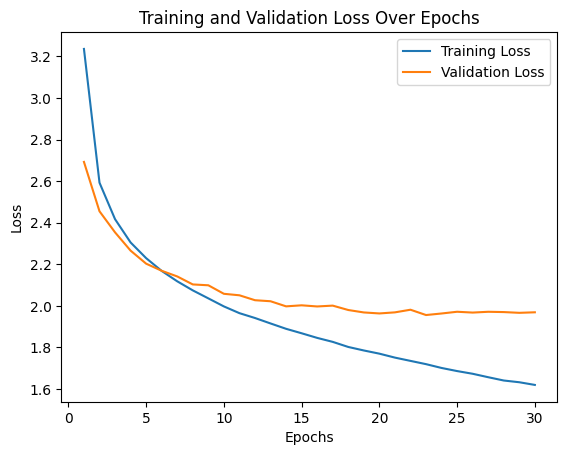

In [29]:
# After training, you can plot the losses
import matplotlib.pyplot as plt
num_epochs=30
plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.savefig('training_curve_cross_attention.png')
plt.show()

#### Interesting. This is a classic example of overfitting. Training loss reducing significantly, but validation loss is constant. Let's check the perfomance first. If we compare carefully, upto 10 epochs, the losses are pretty much similar as our previous model without cross attention.

[nltk_data] Downloading package punkt to /home/amondal2/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amondal2/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amondal2/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
100%|██████████| 120/120 [00:24<00:00,  4.91it/s]


Evaluation Metrics:
BLEU-1: 32.53%
BLEU-2: 20.72%
BLEU-3: 12.54%
BLEU-4: 6.87%
METEOR: 30.94%


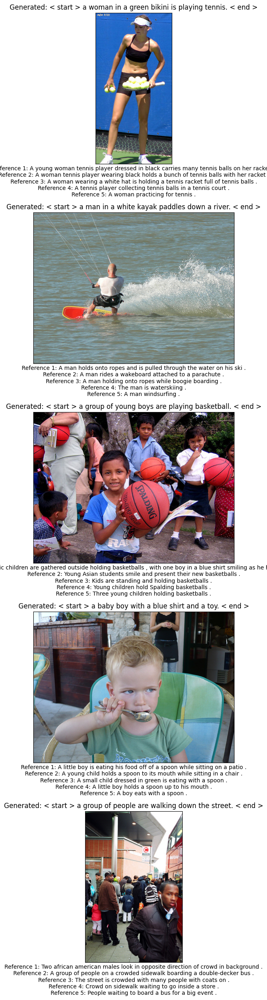

In [30]:
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu
from nltk.translate.meteor_score import meteor_score
import os

def load_model(model_path, model_class, device):
    """
    Load a trained cross-attention model from checkpoint
    """
    checkpoint = torch.load(model_path, map_location=device)
    model = model_class(
        vocab_size=tokenizer.vocab_size,
        embed_size=512,  # Ensure these match your training configuration
        embedding_dim=512,
        nhead=8,
        num_layers=6
    )
    model.load_state_dict(checkpoint['model_state_dict'])
    model = model.to(device)
    model.eval()
    return model

def generate_caption(model, image_path, tokenizer, transform, max_length=30, device="cuda"):
    """
    Generate a caption for a given image using cross-attention model
    """
    # Load and preprocess the image
    image = Image.open(image_path).convert("RGB")
    image = transform(image).unsqueeze(0).to(device)
    
    # Initialize caption generation with start token
    start_token_id = tokenizer.convert_tokens_to_ids(['[CLS]'])[0]
    caption = torch.tensor([[start_token_id]]).to(device)
    
    # Image encoding (get features before projection)
    with torch.no_grad():
        image_features = model.image_encoder(image)
    
    # Generate caption word by word
    for _ in range(max_length):
        with torch.no_grad():
            # Key change: Pass image features and current caption
            output = model.transformer_decoder(image_features, caption)
            
            # Get the next word prediction (last token)
            predicted = output[:, -1, :].argmax(dim=1, keepdim=True)
            
            # Append the predicted word to the caption
            caption = torch.cat([caption, predicted], dim=1)
            
            # Stop if end token is predicted
            if predicted.item() == tokenizer.sep_token_id:
                break
    
    # Convert caption from token ids to text
    caption_text = tokenizer.decode(caption[0].tolist(), skip_special_tokens=True)
    return caption_text


def evaluate_model(model, test_data, tokenizer, transform, device="cuda"):
    """
    Evaluate the model on test data and calculate BLEU scores
    """
    references = []
    hypotheses = []
    
    for img_path, captions in tqdm(test_data.items()):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Process reference captions
        reference_captions = []
        for caption in captions:
            # Clean up reference caption - remove <start> and <end>
            clean_caption = caption.replace("<start>", "").replace("<end>", "").strip()
            reference_captions.append(clean_caption.split())
        
        # Process generated caption
        generated_caption = generated_caption.split()
        
        # Add to lists for corpus calculation
        references.append(reference_captions)
        hypotheses.append(generated_caption)
    
    # Calculate BLEU scores
    bleu1 = corpus_bleu(references, hypotheses, weights=(1, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    
    # Calculate METEOR score
    meteor_scores = []
    for i in range(len(references)):
        score = meteor_score(references[i], hypotheses[i])
        meteor_scores.append(score)
    meteor_avg = np.mean(meteor_scores)
    
    return {
        'BLEU-1': bleu1 * 100,
        'BLEU-2': bleu2 * 100,
        'BLEU-3': bleu3 * 100,
        'BLEU-4': bleu4 * 100,
        'METEOR': meteor_avg * 100
    }

def visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device="cuda"):
    """
    Visualize some example predictions
    """
    import matplotlib.pyplot as plt
    import random
    
    # Select random images from test data
    img_paths = list(test_data.keys())
    selected_paths = random.sample(img_paths, min(num_examples, len(img_paths)))
    
    fig, axes = plt.subplots(num_examples, 1, figsize=(15, 5*num_examples))
    
    for i, img_path in enumerate(selected_paths):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Reference captions
        reference_captions = [caption.replace("<start>", "").replace("<end>", "").strip() 
                             for caption in test_data[img_path]]
        
        # Display image and captions
        img = Image.open(img_path).convert("RGB")
        if num_examples > 1:
            ax = axes[i]
        else:
            ax = axes
            
        ax.imshow(img)
        ax.set_title(f"Generated: {generated_caption}")
        caption_text = "\n".join([f"Reference {j+1}: {ref}" for j, ref in enumerate(reference_captions)])
        ax.set_xlabel(caption_text)
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.savefig("caption_examples_cross_attention.png")
    plt.show()


def prepare_nltk_data():
    """
    Download and verify required NLTK data packages
    """
    import nltk
    import ssl
    
    # Try to work around SSL certificate issues that sometimes occur
    try:
        _create_unverified_https_context = ssl._create_unverified_context
    except AttributeError:
        pass
    else:
        ssl._create_default_https_context = _create_unverified_https_context
    
    # Download required packages
    nltk.download('punkt', quiet=False)
    nltk.download('wordnet', quiet=False)
    nltk.download('omw-1.4', quiet=False)
    
    # Verify packages are properly installed
    try:
        from nltk.corpus import wordnet
        synsets = wordnet.synsets('test')
        if not synsets:
            print("WARNING: WordNet seems installed but returned no synsets - this may indicate a problem")
    except LookupError:
        print("ERROR: WordNet isn't properly installed despite download attempt")
        print("If you're running in a restricted environment, you may need to:")
        print("1. Download the data manually on another machine")
        print("2. Copy the 'nltk_data' directory to one of the search paths listed in the error")

# Alternative evaluation function without METEOR to avoid WordNet dependency
def evaluate_model_bleu_only(model, test_data, tokenizer, transform, device="cuda"):
    """
    Evaluate the model on test data using only BLEU scores (no METEOR)
    """
    references = []
    hypotheses = []
    
    for img_path, captions in tqdm(test_data.items()):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Process reference captions
        reference_captions = []
        for caption in captions:
            # Clean up reference caption - remove <start> and <end>
            clean_caption = caption.replace("<start>", "").replace("<end>", "").strip()
            reference_captions.append(clean_caption.split())
        
        # Process generated caption
        generated_caption = generated_caption.split()
        
        # Add to lists for corpus calculation
        references.append(reference_captions)
        hypotheses.append(generated_caption)
    
    # Calculate BLEU scores
    bleu1 = corpus_bleu(references, hypotheses, weights=(1, 0, 0, 0))
    bleu2 = corpus_bleu(references, hypotheses, weights=(0.5, 0.5, 0, 0))
    bleu3 = corpus_bleu(references, hypotheses, weights=(0.33, 0.33, 0.33, 0))
    bleu4 = corpus_bleu(references, hypotheses, weights=(0.25, 0.25, 0.25, 0.25))
    
    return {
        'BLEU-1': bleu1 * 100,
        'BLEU-2': bleu2 * 100,
        'BLEU-3': bleu3 * 100,
        'BLEU-4': bleu4 * 100
    }

# Update in your main function:
def main():
    # Prepare NLTK data
    prepare_nltk_data()
    
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Load model
    checkpoint_path = "CA2_checkpoint_epoch_30.pth"  # Update with your checkpoint path
    model = load_model(checkpoint_path, ImageCaptioningModelWithCrossAttention, device)
    
    try:
        # Try to evaluate with BLEU and METEOR
        metrics = evaluate_model(model, test_data, tokenizer, transform, device=device)
    except LookupError as e:
        print(f"Error with full evaluation: {e}")
        print("Falling back to BLEU-only evaluation")
        # Fall back to BLEU-only evaluation
        metrics = evaluate_model_bleu_only(model, test_data, tokenizer, transform, device=device)
    print("Evaluation Metrics:")
    for metric_name, score in metrics.items():
        print(f"{metric_name}: {score:.2f}%")
    
    # Visualize some examples
    visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device=device)

if __name__ == "__main__":
    main()

#### BLEU score of 32.53% and METEOR score of ~31% is not bad. But comparing to our previous model, it performs slighly worse. 

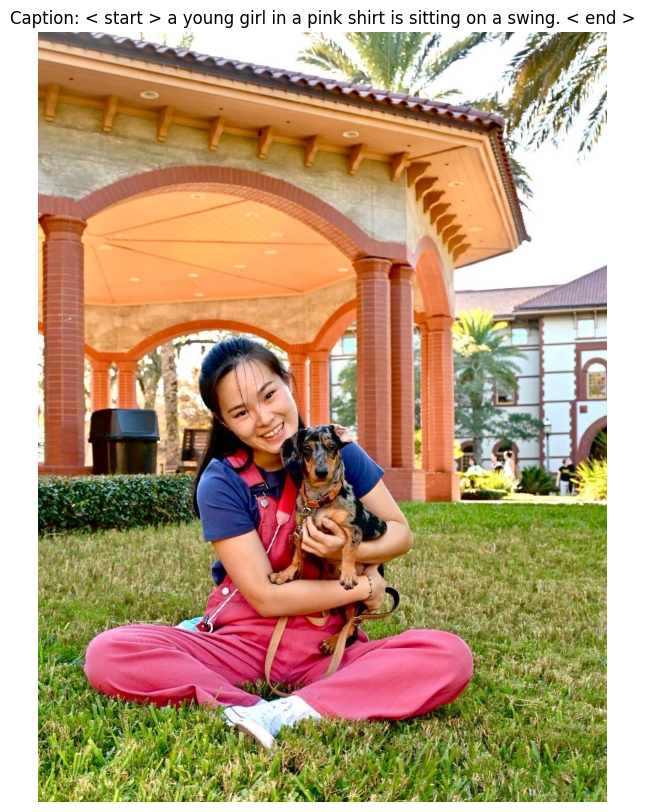

Generated caption: < start > a young girl in a pink shirt is sitting on a swing. < end >


In [31]:
def caption_single_image(image_path, model, tokenizer, transform, max_length=30, device="cuda"):
    """
    Generate caption for a single custom image
    """
    # Load and preprocess the image
    try:
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image).unsqueeze(0).to(device)
        
        # Set model to evaluation mode
        model.eval()
        
        # Start with BERT's [CLS] token (equivalent to <start> in your training)
        start_token = tokenizer.cls_token_id
        caption = torch.tensor([[start_token]]).to(device)
        
        # Generate caption token by token
        with torch.no_grad():
            # Get image features
            image_features = model.image_encoder(image_tensor)
            
            # Generate tokens one by one
            for _ in range(max_length):
                # Get model prediction
                output = model.transformer_decoder(image_features, caption)
                
                # Get the next word prediction (last token)
                predicted = output[:, -1, :].argmax(dim=1, keepdim=True)
                
                # Append the predicted token to the caption
                caption = torch.cat([caption, predicted], dim=1)
                
                # Stop if end token is predicted (BERT's [SEP] token)
                if predicted.item() == tokenizer.sep_token_id:
                    break
        
        # Convert tokens to text
        caption_text = tokenizer.decode(caption[0], skip_special_tokens=True)
        
        # Display the image and caption
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.title(f"Caption: {caption_text}")
        plt.axis('off')
        plt.show()
        
        return caption_text
        
    except Exception as e:
        print(f"Error processing image: {str(e)}")
        return None

# Usage example:
# First load your model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
checkpoint_path = "CA2_checkpoint_epoch_30.pth"
model = load_model(checkpoint_path, ImageCaptioningModelWithCrossAttention, device)
#
# Then generate caption for your image
test_image_path = "generate_test.JPG"
caption = caption_single_image(test_image_path, model, tokenizer, transform, device=device)
print(f"Generated caption: {caption}")

#### If we read generated caption from both models, we can feel model 1 did a better prediction. 

#### To improve the performance, let's try few things: use early stop, weight decay, learning rate schdular, dropout. These are standard approaches for tackle overfitting. Let's see if they improve the model

####

In [33]:
class CrossAttentionTransformerDecoder(nn.Module):
    def __init__(self, embed_size, vocab_size, embedding_dim, nhead, num_layers):
        super(CrossAttentionTransformerDecoder, self).__init__()
        
        # Embedding layer for captions
        self.embedding = nn.Embedding(vocab_size, embedding_dim)
        
        # Positional encoding
        self.embed_size = embedding_dim
        max_len = 100  # Maximum sequence length
        pe = torch.zeros(max_len, embedding_dim)
        position = torch.arange(0, max_len).unsqueeze(1).float()
        div_term = torch.exp(torch.arange(0, embedding_dim, 2).float() * -(torch.log(torch.tensor(10000.0)) / embedding_dim))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        self.register_buffer('pe', pe.unsqueeze(0))  # Shape: [1, max_len, embedding_dim]
        
        # Linear layer to project image features to match decoder dimensions
        self.img_projection = nn.Linear(embed_size, embedding_dim)
        
        # Custom transformer decoder layers with cross-attention
        self.decoder_layers = nn.ModuleList([
            DecoderLayerWithCrossAttention(embedding_dim, nhead)
            for _ in range(num_layers)
        ])
        
        # Output linear layer
        self.fc_out = nn.Linear(embedding_dim, vocab_size)
        
    def forward(self, image_features, captions):
        # Embedding captions
        embedded = self.embedding(captions)  # Shape: [batch_size, seq_len, embedding_dim]
        
        # Add positional encoding
        seq_len = embedded.size(1)
        positional_encoding = self.pe[:, :seq_len, :]  # Shape: [1, seq_len, embedding_dim]
        embedded = embedded + positional_encoding
        
        # Project image features to match embedding dimension
        image_features = self.img_projection(image_features)  # Shape: [batch_size, embedding_dim]
        
        # Create self-attention mask to prevent attention to future tokens
        tgt_mask = self.generate_square_subsequent_mask(seq_len).to(embedded.device)
        
        # Process through decoder layers
        output = embedded
        for decoder_layer in self.decoder_layers:
            output = decoder_layer(output, image_features, tgt_mask)
        
        # Project to vocabulary size
        output = self.fc_out(output)  # Shape: [batch_size, seq_len, vocab_size]
        
        return output
    
    def generate_square_subsequent_mask(self, sz):
        # Generate a square mask for the sequence to prevent attending to future tokens
        mask = (torch.triu(torch.ones(sz, sz)) == 1).transpose(0, 1)
        mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
        return mask


class DecoderLayerWithCrossAttention(nn.Module):
    def __init__(self, d_model, nhead, dropout=0.3):
        super(DecoderLayerWithCrossAttention, self).__init__()
        
        # Self-attention
        self.self_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.norm1 = nn.LayerNorm(d_model)
        self.dropout1 = nn.Dropout(dropout)
        
        # Cross-attention between text and image features
        self.cross_attn = nn.MultiheadAttention(d_model, nhead, dropout=dropout)
        self.norm2 = nn.LayerNorm(d_model)
        self.dropout2 = nn.Dropout(dropout)
        
        # Feed-forward network
        self.ffn = nn.Sequential(
            nn.Linear(d_model, 4 * d_model),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(4 * d_model, d_model)
        )
        self.norm3 = nn.LayerNorm(d_model)
        self.dropout3 = nn.Dropout(dropout)
        
    def forward(self, tgt, memory, tgt_mask=None):
        # Self-attention
        tgt2 = self.self_attn(
            query=tgt.transpose(0, 1),
            key=tgt.transpose(0, 1),
            value=tgt.transpose(0, 1),
            attn_mask=tgt_mask
        )[0].transpose(0, 1)
        tgt = self.norm1(tgt + self.dropout1(tgt2))
        
        # Cross-attention between text and image
        # Expand image features to be compatible with text sequence
        batch_size, seq_len, d_model = tgt.size()
        expanded_memory = memory.unsqueeze(1).expand(-1, seq_len, -1)  # [batch_size, seq_len, d_model]
        
        # Prepare for cross-attention
        q = tgt.transpose(0, 1)  # [seq_len, batch_size, d_model]
        k = expanded_memory.transpose(0, 1)  # [seq_len, batch_size, d_model]
        v = expanded_memory.transpose(0, 1)  # [seq_len, batch_size, d_model]
        
        # Apply cross-attention
        tgt2 = self.cross_attn(q, k, v)[0].transpose(0, 1)
        tgt = self.norm2(tgt + self.dropout2(tgt2))
        
        # Feed-forward network
        tgt2 = self.ffn(tgt)
        tgt = self.norm3(tgt + self.dropout3(tgt2))
        
        return tgt

class ImageCaptioningModelWithCrossAttention(nn.Module):
    def __init__(self, vocab_size, embed_size, embedding_dim, nhead, num_layers):
        super(ImageCaptioningModelWithCrossAttention, self).__init__()
        
        self.image_encoder = ImageEncoder(embed_size)
        self.transformer_decoder = CrossAttentionTransformerDecoder(
            embed_size=embed_size,
            vocab_size=vocab_size,
            embedding_dim=embedding_dim,
            nhead=nhead,
            num_layers=num_layers
        )
        
    def forward(self, images, captions):
        image_features = self.image_encoder(images)
        output = self.transformer_decoder(image_features, captions)
        return output

In [34]:
### Change the training to lower overfitting: use early stop, weight decay, learning rate schdular. 

def train(model, train_loader, val_loader, criterion, optimizer, num_epochs, device, vocab_size):
    # Lists to store losses for plotting
    train_losses = []
    val_losses = []
    
    # Early stopping parameters
    best_val_loss = float('inf')
    early_stopping_counter = 0
    early_stopping_patience = 5
    
    # Create learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='min', patience=3, factor=0.5, verbose=True
    )
    
    for epoch in range(num_epochs):
        model.train()
        total_train_loss = 0
        
        for images, captions in tqdm(iter(train_loader), total=len(train_loader)):
            images = images.to(device)
            captions = captions.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass (exclude last token from input)
            outputs = model(images, captions[:, :-1])
            
            # Reshape outputs and captions for loss calculation
            outputs = outputs.contiguous().view(-1, vocab_size)
            targets = captions[:, 1:].contiguous().view(-1)  # Skip the first token (usually BOS)
            
            # Calculate loss
            loss = criterion(outputs, targets)
            loss.backward()
             
            # Clip gradients to avoid exploding gradients
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            
            total_train_loss += loss.item()
        
        avg_train_loss = total_train_loss / len(train_loader)
        
        # Validate the model
        model.eval()
        total_val_loss = 0
        with torch.no_grad():
            for images, captions in tqdm(iter(val_loader), total=len(val_loader)):
                images = images.to(device)
                captions = captions.to(device)
                
                # Forward pass
                outputs = model(images, captions[:, :-1])
                
                # Reshape outputs and captions for loss calculation
                outputs = outputs.contiguous().view(-1, vocab_size)
                targets = captions[:, 1:].contiguous().view(-1)
                
                # Calculate loss
                loss = criterion(outputs, targets)
                total_val_loss += loss.item()
        
        avg_val_loss = total_val_loss / len(val_loader)
        
        # Update learning rate scheduler based on validation loss
        scheduler.step(avg_val_loss)
        
        # Save the losses for plotting
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
        
        # Check for best model and save it
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            early_stopping_counter = 0
            # Save best model
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, "CA2_best_model_modifed.pth")
            print(f"New best model saved with validation loss: {avg_val_loss:.4f}")
        else:
            early_stopping_counter += 1
            print(f"Validation loss did not improve. Early stopping counter: {early_stopping_counter}/{early_stopping_patience}")
        
        # Regular checkpoint saving
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, f"CA2_checkpoint_epoch_{epoch+1}_modified.pth")
        
        # Early stopping check
        if early_stopping_counter >= early_stopping_patience:
            print(f"Early stopping triggered after epoch {epoch+1}")
            break
    
    return train_losses, val_losses

# Initialize model parameters
embed_size = 512        # Embedding size for image features
embedding_dim = 512     # Embedding dimension for captions
nhead = 8               # Number of attention heads
num_layers = 6          # Number of transformer layers
vocab_size = tokenizer.vocab_size

# Create the image captioning model
model = ImageCaptioningModelWithCrossAttention(
    vocab_size=vocab_size,
    embed_size=embed_size,
    embedding_dim=embedding_dim,
    nhead=nhead,
    num_layers=num_layers
)
# Move model to device (GPU if available, otherwise CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Define loss function and optimizer with weight decay for regularization
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
optimizer = torch.optim.Adam(model.parameters(), lr=5e-5, weight_decay=1e-5)  # Lower learning rate and add weight decay

# Now you can start training with the improved train function
train_losses, val_losses = train(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    criterion=criterion,
    optimizer=optimizer,
    num_epochs=30,
    device=device,
    vocab_size=vocab_size
)


100%|██████████| 183/183 [05:23<00:00,  1.77s/it]


Epoch 1/30, Train Loss: 3.7166, Val Loss: 3.0000
New best model saved with validation loss: 3.0000


100%|██████████| 183/183 [04:11<00:00,  1.37s/it]


Epoch 2/30, Train Loss: 2.9207, Val Loss: 2.7626
New best model saved with validation loss: 2.7626


100%|██████████| 183/183 [03:30<00:00,  1.15s/it]


Epoch 3/30, Train Loss: 2.7463, Val Loss: 2.6251
New best model saved with validation loss: 2.6251


100%|██████████| 183/183 [03:32<00:00,  1.16s/it]


Epoch 4/30, Train Loss: 2.6284, Val Loss: 2.5241
New best model saved with validation loss: 2.5241


IOPub message rate exceeded.21<08:06,  1.49it/s]
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



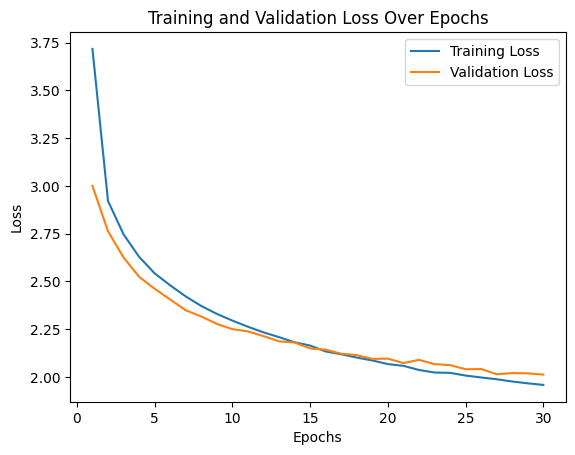

In [35]:
# After training, you can plot the losses
import matplotlib.pyplot as plt
num_epochs=30
plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.savefig('training_curve_cross_attention_2.png')
plt.show()

[nltk_data] Downloading package punkt to /home/amondal2/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/amondal2/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/amondal2/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
100%|██████████| 120/120 [00:19<00:00,  6.12it/s]


Evaluation Metrics:
BLEU-1: 32.79%
BLEU-2: 20.43%
BLEU-3: 12.28%
BLEU-4: 6.78%
METEOR: 29.74%


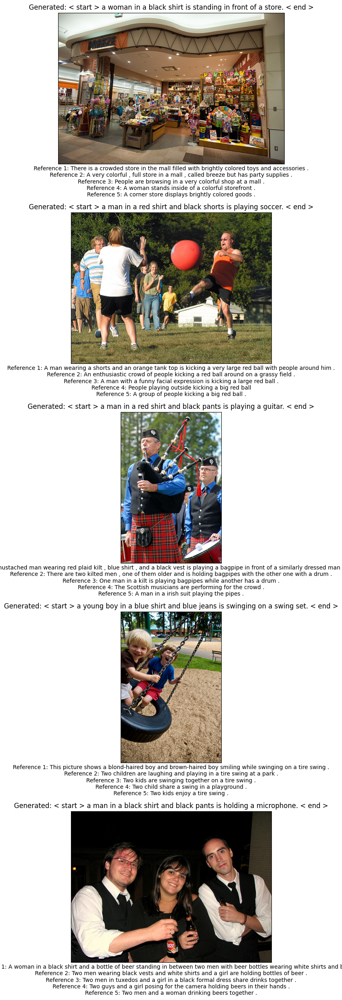

In [36]:
# Update in your main function:
def visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device="cuda"):
    """
    Visualize some example predictions
    """
    import matplotlib.pyplot as plt
    import random
    
    # Select random images from test data
    img_paths = list(test_data.keys())
    selected_paths = random.sample(img_paths, min(num_examples, len(img_paths)))
    
    fig, axes = plt.subplots(num_examples, 1, figsize=(15, 5*num_examples))
    
    for i, img_path in enumerate(selected_paths):
        if not os.path.exists(img_path):
            continue
            
        # Generate caption
        generated_caption = generate_caption(model, img_path, tokenizer, transform, device=device)
        
        # Reference captions
        reference_captions = [caption.replace("<start>", "").replace("<end>", "").strip() 
                             for caption in test_data[img_path]]
        
        # Display image and captions
        img = Image.open(img_path).convert("RGB")
        if num_examples > 1:
            ax = axes[i]
        else:
            ax = axes
            
        ax.imshow(img)
        ax.set_title(f"Generated: {generated_caption}")
        caption_text = "\n".join([f"Reference {j+1}: {ref}" for j, ref in enumerate(reference_captions)])
        ax.set_xlabel(caption_text)
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.tight_layout()
    plt.savefig("caption_examples_cross_attention2.png")
    plt.show()

def main():
    # Prepare NLTK data
    prepare_nltk_data()
    
    # Set device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Load model
    checkpoint_path = "CA2_best_model_modifed.pth"  # Update with your checkpoint path
    model = load_model(checkpoint_path, ImageCaptioningModelWithCrossAttention, device)
    
    try:
        # Try to evaluate with BLEU and METEOR
        metrics = evaluate_model(model, test_data, tokenizer, transform, device=device)
    except LookupError as e:
        print(f"Error with full evaluation: {e}")
        print("Falling back to BLEU-only evaluation")
        # Fall back to BLEU-only evaluation
        metrics = evaluate_model_bleu_only(model, test_data, tokenizer, transform, device=device)
    print("Evaluation Metrics:")
    for metric_name, score in metrics.items():
        print(f"{metric_name}: {score:.2f}%")
    
    # Visualize some examples
    visualize_examples(model, test_data, tokenizer, transform, num_examples=5, device=device)

if __name__ == "__main__":
    main()

#### Again the BLEU score and METEOR score do not seem to improve, in fact they are still worse compared to the our original model without cross attention. The reason could be that as we are incorporating cross-attention, we are making the model more complicated and harder to train. So perhaps we need to train it for a higher epochs or need to have a larger dataset.

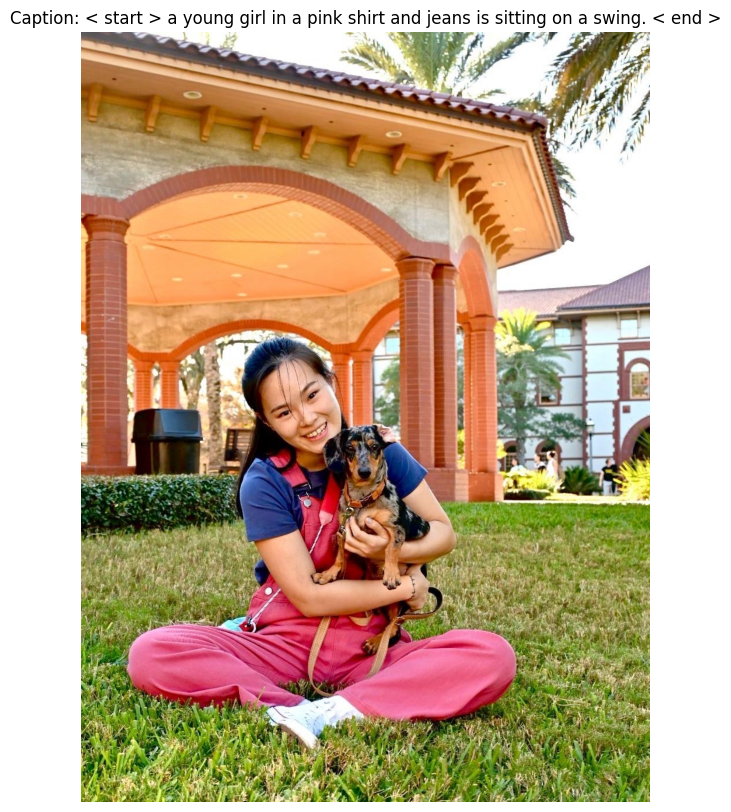

Generated caption: < start > a young girl in a pink shirt and jeans is sitting on a swing. < end >


In [38]:
def caption_single_image(image_path, model, tokenizer, transform, max_length=30, device="cuda"):
    """
    Generate caption for a single custom image
    """
    # Load and preprocess the image
    try:
        image = Image.open(image_path).convert("RGB")
        image_tensor = transform(image).unsqueeze(0).to(device)
        
        # Set model to evaluation mode
        model.eval()
        
        # Start with BERT's [CLS] token (equivalent to <start> in your training)
        start_token = tokenizer.cls_token_id
        caption = torch.tensor([[start_token]]).to(device)
        
        # Generate caption token by token
        with torch.no_grad():
            # Get image features
            image_features = model.image_encoder(image_tensor)
            
            # Generate tokens one by one
            for _ in range(max_length):
                # Get model prediction
                output = model.transformer_decoder(image_features, caption)
                
                # Get the next word prediction (last token)
                predicted = output[:, -1, :].argmax(dim=1, keepdim=True)
                
                # Append the predicted token to the caption
                caption = torch.cat([caption, predicted], dim=1)
                
                # Stop if end token is predicted (BERT's [SEP] token)
                if predicted.item() == tokenizer.sep_token_id:
                    break
        
        # Convert tokens to text
        caption_text = tokenizer.decode(caption[0], skip_special_tokens=True)
        
        # Display the image and caption
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        plt.title(f"Caption: {caption_text}")
        plt.axis('off')
        plt.show()
        
        return caption_text
        
    except Exception as e:
        print(f"Error processing image: {str(e)}")
        return None

# Usage example:
# First load your model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
checkpoint_path = "CA2_best_model_modifed.pth"
model = load_model(checkpoint_path, ImageCaptioningModelWithCrossAttention, device)
#
# Then generate caption for your image
test_image_path = "generate_test.JPG"
caption = caption_single_image(test_image_path, model, tokenizer, transform, device=device)
print(f"Generated caption: {caption}")

#### All three version of models are trained and evaluated. Let's plot their performances for comparision.

CA_mod=Evaluation Metrics:
BLEU-1: 32.79%
BLEU-2: 20.43%
BLEU-3: 12.28%
BLEU-4: 6.78%
METEOR: 29.74%

CA=Evaluation Metrics:
BLEU-1: 32.53%
BLEU-2: 20.72%
BLEU-3: 12.54%
BLEU-4: 6.87%
METEOR: 30.94%

no_CA=Evaluation Metrics:
BLEU-1: 33.76%
BLEU-2: 20.96%
BLEU-3: 13.31%
BLEU-4: 7.86%
METEOR: 31.68%

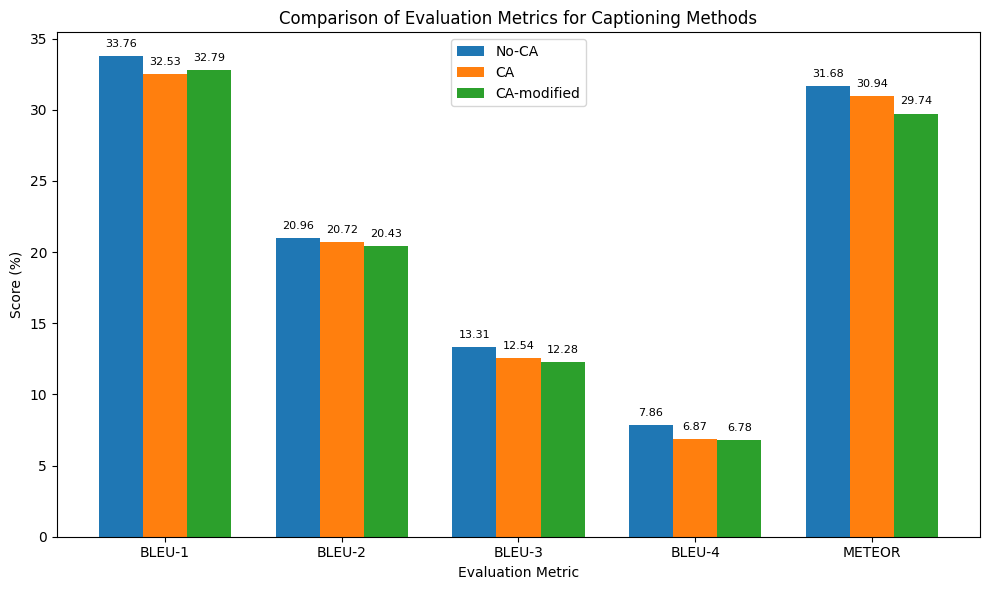

In [1]:
import matplotlib.pyplot as plt
import numpy as np

# Data
methods = ['No-CA', 'CA', 'CA-modified']
metrics = ['BLEU-1', 'BLEU-2', 'BLEU-3', 'BLEU-4', 'METEOR']

# Scores for each method
scores = {
    'No-CA': [33.76, 20.96, 13.31, 7.86, 31.68],
    'CA': [32.53, 20.72, 12.54, 6.87, 30.94],
    'CA-modified': [32.79, 20.43, 12.28, 6.78, 29.74]
}

# Setup for plotting
x = np.arange(len(metrics))  # Metric positions
width = 0.25  # Width of bars

fig, ax = plt.subplots(figsize=(10, 6))

# Plot each method
ax.bar(x - width, scores['No-CA'], width, label='No-CA')
ax.bar(x, scores['CA'], width, label='CA')
ax.bar(x + width, scores['CA-modified'], width, label='CA-modified')

# Labels and titles
ax.set_xlabel('Evaluation Metric')
ax.set_ylabel('Score (%)')
ax.set_title('Comparison of Evaluation Metrics for Captioning Methods')
ax.set_xticks(x)
ax.set_xticklabels(metrics)
ax.legend()

# Display scores on bars
for i, method in enumerate(methods):
    offset = (i - 1) * width
    for j, val in enumerate(scores[method]):
        ax.text(x[j] + offset, val + 0.5, f'{val:.2f}', ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.savefig('Overall_performance.pdf')
plt.show()


### 3. Let's perform the Image-text retrieval task now as we will use same Flickr30K dataset

In [2]:
## Here we need to use dual encoder- one for image and another for text and encode them in the same place. 
## The model try to minimize the contrast between a pair of image and text.

In [74]:
# Image Encoder - Using a pre-trained CNN
class ImageEncoder(nn.Module):
    def __init__(self, embedding_dim):
        super(ImageEncoder, self).__init__()
        # Load pre-trained ResNet model
        resnet = models.resnet50(pretrained=True)
        # Remove the last fully connected layer
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        # Add a projection layer to get embedding_dim size
        self.fc = nn.Linear(2048, embedding_dim)
        
    def forward(self, images):
        with torch.no_grad():
            features = self.resnet(images)
        features = features.view(features.size(0), -1)  # Flatten
        features = self.fc(features)
        # L2 normalize embeddings
        features = F.normalize(features, p=2, dim=1)
        return features

In [75]:
# Text Encoder - Using pre-trained BERT
class TextEncoder(nn.Module):
    def __init__(self, embedding_dim):
        super(TextEncoder, self).__init__()
        self.bert = BertModel.from_pretrained('bert-base-uncased')
        # Freeze BERT parameters for efficiency
        for param in self.bert.parameters():
            param.requires_grad = False
        # Add a projection layer to get embedding_dim size
        self.fc = nn.Linear(768, embedding_dim)
        
    def forward(self, input_ids, attention_mask):
        with torch.no_grad():
            outputs = self.bert(input_ids=input_ids, attention_mask=attention_mask)
            # Use the [CLS] token embedding as the text representation
            text_features = outputs.last_hidden_state[:, 0, :]
        text_features = self.fc(text_features)
        # L2 normalize embeddings
        text_features = F.normalize(text_features, p=2, dim=1)
        return text_features


In [76]:
# Dual Encoder for Image-Text Retrieval
class DualEncoder(nn.Module):
    def __init__(self, embedding_dim):
        super(DualEncoder, self).__init__()
        self.image_encoder = ImageEncoder(embedding_dim)
        self.text_encoder = TextEncoder(embedding_dim)
        
    def forward(self, images=None, input_ids=None, attention_mask=None):
        image_features = None
        text_features = None
        
        if images is not None:
            image_features = self.image_encoder(images)
            
        if input_ids is not None and attention_mask is not None:
            text_features = self.text_encoder(input_ids, attention_mask)
            
        return image_features, text_features

In [77]:
# Dataset for Image-Text Retrieval
class Flickr30kRetrievalDataset(Dataset):
    def __init__(self, data_dict, transform=None, tokenizer=None):
        self.data_dict = data_dict
        self.transform = transform
        self.tokenizer = tokenizer
        self.image_paths = list(data_dict.keys())
        
    def __len__(self):
        return len(self.image_paths)
        
    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        captions = self.data_dict[image_path]
        
        # Randomly select one caption
        caption = random.choice(captions)
        
        # Load and transform the image
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        
        # Tokenize the caption
        tokenized = self.tokenizer(
            caption,
            padding='max_length',
            truncation=True,
            max_length=SEQ_LENGTH,
            return_tensors="pt"
        )
        
        input_ids = tokenized['input_ids'].squeeze(0)
        attention_mask = tokenized['attention_mask'].squeeze(0)
        
        return image, input_ids, attention_mask, idx

In [78]:
# Contrastive Loss Function for Retrieval
class NTXentLoss(nn.Module):
    def __init__(self, temperature=0.07):
        super(NTXentLoss, self).__init__()
        self.temperature = temperature
        self.criterion = nn.CrossEntropyLoss()
        
    def forward(self, image_features, text_features):
        # Compute similarity matrix
        logits = torch.matmul(image_features, text_features.T) / self.temperature
        
        # Labels: diagonal elements (matching pairs)
        labels = torch.arange(logits.size(0)).to(logits.device)
        
        # Compute loss in both directions
        i2t_loss = self.criterion(logits, labels)  # image-to-text
        t2i_loss = self.criterion(logits.T, labels)  # text-to-image
        
        # Return average of the bidirectional loss
        return (i2t_loss + t2i_loss) / 2

In [79]:
# Training function
def train_retrieval_model(model, train_loader, val_loader, criterion, optimizer, num_epochs, device):
    best_val_loss = float('inf')
    train_losses = []
    val_losses = []
    
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        total_train_loss = 0
        
        for images, input_ids, attention_mask, _ in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
            images = images.to(device)
            input_ids = input_ids.to(device)
            attention_mask = attention_mask.to(device)
            
            optimizer.zero_grad()
            
            # Forward pass
            image_features, text_features = model(images, input_ids, attention_mask)
            
            # Compute loss
            loss = criterion(image_features, text_features)
            
            # Backward pass
            loss.backward()
            optimizer.step()
            
            total_train_loss += loss.item()
        
        avg_train_loss = total_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        
        # Validation phase
        model.eval()
        total_val_loss = 0
        
        with torch.no_grad():
            for images, input_ids, attention_mask, _ in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Validation"):
                images = images.to(device)
                input_ids = input_ids.to(device)
                attention_mask = attention_mask.to(device)
                
                # Forward pass
                image_features, text_features = model(images, input_ids, attention_mask)
                
                # Compute loss
                loss = criterion(image_features, text_features)
                
                total_val_loss += loss.item()
        
        avg_val_loss = total_val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
        
        # Save the best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'loss': best_val_loss,
            }, 'best_retrieval_model.pth')
            
        # Save checkpoint every 5 epochs
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
            }, f'retrieval_model_epoch_{epoch+1}.pth')
    
    return train_losses, val_losses

In [80]:
def evaluate_retrieval(model, test_loader, device):
    model.eval()
    
    # Lists to store all features
    all_image_features = []
    all_text_features = []
    all_indices = []
    
    with torch.no_grad():
        for images, input_ids, attention_mask, indices in tqdm(test_loader, desc="Extracting features"):
            images = images.to(device)
            input_ids = input_ids.to(device)
            attention_mask = attention_mask.to(device)
            
            # Get features
            image_features, text_features = model(images, input_ids, attention_mask)
            
            all_image_features.append(image_features.cpu())
            all_text_features.append(text_features.cpu())
            all_indices.extend(indices.tolist())
    
    # Concatenate all features
    all_image_features = torch.cat(all_image_features, dim=0)
    all_text_features = torch.cat(all_text_features, dim=0)
    
    # Compute similarity matrix
    similarity = torch.matmul(all_image_features, all_text_features.T)
    
    # Compute metrics
    # Image-to-Text retrieval
    i2t_ranks = []
    for i in range(similarity.size(0)):
        # Get ranking of correct caption
        ranking = (similarity[i, :] > similarity[i, i]).sum().item() + 1
        i2t_ranks.append(ranking)
    
    # Text-to-Image retrieval
    t2i_ranks = []
    for i in range(similarity.size(1)):
        # Get ranking of correct image
        ranking = (similarity[:, i] > similarity[i, i]).sum().item() + 1
        t2i_ranks.append(ranking)
    
    # Calculate recall metrics
    def recall_at_k(ranks, k):
        return len([r for r in ranks if r <= k]) / len(ranks)
    
    i2t_r1 = recall_at_k(i2t_ranks, 1)
    i2t_r5 = recall_at_k(i2t_ranks, 5)
    i2t_r10 = recall_at_k(i2t_ranks, 10)
    
    t2i_r1 = recall_at_k(t2i_ranks, 1)
    t2i_r5 = recall_at_k(t2i_ranks, 5)
    t2i_r10 = recall_at_k(t2i_ranks, 10)
    
    # Median rank
    i2t_median_rank = np.median(i2t_ranks)
    t2i_median_rank = np.median(t2i_ranks)
    
    results = {
        "Image-to-Text": {
            "R@1": i2t_r1,
            "R@5": i2t_r5,
            "R@10": i2t_r10,
            "Median Rank": i2t_median_rank
        },
        "Text-to-Image": {
            "R@1": t2i_r1,
            "R@5": t2i_r5,
            "R@10": t2i_r10,
            "Median Rank": t2i_median_rank
        }
    }
    
    return results, similarity, all_indices

In [81]:
def create_data_loaders(train_data, validation_data, test_data, batch_size=32):
    # Image transformation
    transform = transforms.Compose([
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # ImageNet stats
    ])
    
    # Initialize BERT tokenizer
    tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
    
    # Create datasets
    train_dataset = Flickr30kRetrievalDataset(train_data, transform, tokenizer)
    val_dataset = Flickr30kRetrievalDataset(validation_data, transform, tokenizer)
    test_dataset = Flickr30kRetrievalDataset(test_data, transform, tokenizer)
    
    # Create DataLoaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    return train_loader, val_loader, test_loader, tokenizer

In [82]:
EMBEDDING_DIM=512
# Initialize model and optimization components
def initialize_model(embedding_dim=EMBEDDING_DIM, lr=1e-4):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Create model
    model = DualEncoder(embedding_dim=embedding_dim).to(device)
    
    # Define loss and optimizer
    criterion = NTXentLoss(temperature=0.07)
    optimizer = torch.optim.Adam(
        [p for p in model.parameters() if p.requires_grad],
        lr=lr,
        weight_decay=1e-5
    )
    
    return model, criterion, optimizer, device

In [96]:
# Plot and save training curves
def plot_training_curves(train_losses, val_losses, filename='retrieval_loss.png'):
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.savefig(filename)
    plt.show()
    plt.close()


In [84]:
# Print and save evaluation results
def print_and_save_results(results, similarity_matrix=None, indices=None):
    print("\nRetrieval Results:")
    print("Image-to-Text:")
    print(f"R@1: {results['Image-to-Text']['R@1']:.4f}")
    print(f"R@5: {results['Image-to-Text']['R@5']:.4f}")
    print(f"R@10: {results['Image-to-Text']['R@10']:.4f}")
    print(f"Median Rank: {results['Image-to-Text']['Median Rank']}")
    
    print("\nText-to-Image:")
    print(f"R@1: {results['Text-to-Image']['R@1']:.4f}")
    print(f"R@5: {results['Text-to-Image']['R@5']:.4f}")
    print(f"R@10: {results['Text-to-Image']['R@10']:.4f}")
    print(f"Median Rank: {results['Text-to-Image']['Median Rank']}")
    
    # Save results
    np.save('retrieval_results.npy', results)
    if similarity_matrix is not None:
        np.save('similarity_matrix.npy', similarity_matrix.numpy())
    if indices is not None:
        np.save('test_indices.npy', np.array(indices))

In [85]:
def main(train_model=True, evaluate_model=True, batch_size=32, num_epochs=20, lr=1e-4):
    # Prepare data
    #train_data, validation_data, test_data, text_data = prepare_data()
    
    # Create data loaders
    train_loader, val_loader, test_loader, tokenizer = create_data_loaders(
        train_data, validation_data, test_data, batch_size
    )
    
    # Initialize model
    model, criterion, optimizer, device = initialize_model(EMBEDDING_DIM, lr)
    
    # Train model (optional)
    if train_model:
        train_losses, val_losses = train_retrieval_model(
            model, train_loader, val_loader, criterion, optimizer, num_epochs, device
        )
        plot_training_curves(train_losses, val_losses)
    
    # Load the best model (if available and evaluation is requested)
    if evaluate_model:
        try:
            checkpoint = torch.load('best_retrieval_model.pth')
            model.load_state_dict(checkpoint['model_state_dict'])
            print("Loaded best model checkpoint")
        except FileNotFoundError:
            print("No checkpoint found, using current model state")
        
        # Evaluate on test set
        results, similarity_matrix, indices = evaluate_retrieval(model, test_loader, device)
        print_and_save_results(results, similarity_matrix, indices)
    
    return model, tokenizer

In [86]:
def train_only(batch_size=32, num_epochs=20, lr=1e-4):
    model, tokenizer = main(train_model=True, evaluate_model=False, batch_size=batch_size, num_epochs=num_epochs, lr=lr)
    return model, tokenizer

In [103]:
def evaluate_only(model_path='best_retrieval_model.pth', batch_size=32):
    # Load data
    #train_data, validation_data, test_data, text_data = prepare_data()
    
    # Create test loader only
    _, _, test_loader, tokenizer = create_data_loaders(
        train_data, validation_data, test_data, batch_size
    )
    
    # Initialize model
    model, _, _, device = initialize_model()
    
    # Load model weights
    checkpoint = torch.load(model_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    
    # Evaluate
    results, similarity_matrix, indices = evaluate_retrieval(model, test_loader, device)
    print_and_save_results(results, similarity_matrix, indices)
    
    return results

In [88]:
from transformers import BertTokenizer, BertModel


In [89]:
if __name__ == "__main__":
    model, tokenizer=train_only()

Epoch 1/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:51<00:00,  3.57it/s]


Epoch 1/20, Train Loss: 2.3818, Val Loss: 1.7564


Epoch 2/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:21<00:00,  8.54it/s]


Epoch 2/20, Train Loss: 1.9614, Val Loss: 1.5799


Epoch 3/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:08<00:00, 22.81it/s]


Epoch 3/20, Train Loss: 1.8360, Val Loss: 1.5186


Epoch 4/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:12<00:00, 14.62it/s]


Epoch 4/20, Train Loss: 1.7678, Val Loss: 1.4847


Epoch 5/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:27<00:00,  6.78it/s]


Epoch 5/20, Train Loss: 1.7187, Val Loss: 1.4767


Epoch 6/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:13<00:00, 13.67it/s]


Epoch 6/20, Train Loss: 1.6840, Val Loss: 1.4212


Epoch 7/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:37<00:00,  4.87it/s]


Epoch 7/20, Train Loss: 1.6578, Val Loss: 1.3815


Epoch 8/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [00:54<00:00,  3.33it/s]


Epoch 8/20, Train Loss: 1.6340, Val Loss: 1.3881


Epoch 9/20 - Validation: 100%|██████████████████████████████████████████████████████████████| 183/183 [01:09<00:00,  2.62it/s]


Epoch 9/20, Train Loss: 1.6054, Val Loss: 1.3652


Epoch 10/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:44<00:00,  4.13it/s]


Epoch 10/20, Train Loss: 1.5997, Val Loss: 1.3499


Epoch 11/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:08<00:00, 22.28it/s]


Epoch 11/20, Train Loss: 1.5807, Val Loss: 1.3282


Epoch 12/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:07<00:00, 23.15it/s]


Epoch 12/20, Train Loss: 1.5771, Val Loss: 1.3322


Epoch 13/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:08<00:00, 22.80it/s]


Epoch 13/20, Train Loss: 1.5559, Val Loss: 1.3366


Epoch 14/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:09<00:00, 19.65it/s]


Epoch 14/20, Train Loss: 1.5479, Val Loss: 1.3304


Epoch 15/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:07<00:00, 23.14it/s]


Epoch 15/20, Train Loss: 1.5263, Val Loss: 1.3119


Epoch 16/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:14<00:00, 12.25it/s]


Epoch 16/20, Train Loss: 1.5282, Val Loss: 1.3149


Epoch 17/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:08<00:00, 22.76it/s]


Epoch 17/20, Train Loss: 1.5157, Val Loss: 1.3195


Epoch 18/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:09<00:00, 20.01it/s]


Epoch 18/20, Train Loss: 1.5165, Val Loss: 1.2855


Epoch 19/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:35<00:00,  5.17it/s]


Epoch 19/20, Train Loss: 1.5099, Val Loss: 1.2947


Epoch 20/20 - Validation: 100%|█████████████████████████████████████████████████████████████| 183/183 [00:39<00:00,  4.64it/s]


Epoch 20/20, Train Loss: 1.4904, Val Loss: 1.3193


(-0.5, 999.5, 499.5, -0.5)

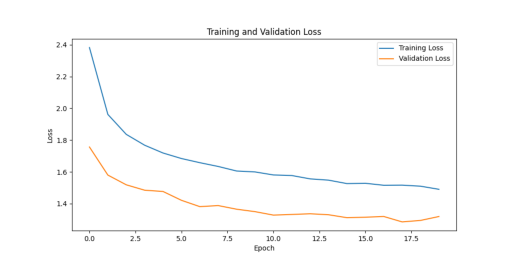

In [95]:
#forgot to show the trainign curve but saved it. therefore, will show it here
#import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('retrieval_loss.png')  # replace with your file name
plt.imshow(img)
plt.axis('off')

In [100]:
text_data[:2]

['<start> Two young guys with shaggy hair look at their hands while hanging out in the yard . <end>',
 '<start> Two young , White males are outside near many bushes . <end>']

In [101]:
print(model)

DualEncoder(
  (image_encoder): ImageEncoder(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=Tr

In [104]:
if __name__ == "__main__":
    results=evaluate_only()

Extracting features: 100%|██████████████████████████████████████████████████████████████████████| 4/4 [00:09<00:00,  2.38s/it]



Retrieval Results:
Image-to-Text:
R@1: 0.4000
R@5: 0.7000
R@10: 0.8417
Median Rank: 2.0

Text-to-Image:
R@1: 0.3333
R@5: 0.7083
R@10: 0.8500
Median Rank: 2.5



===== IMAGE TO TEXT RETRIEVAL =====


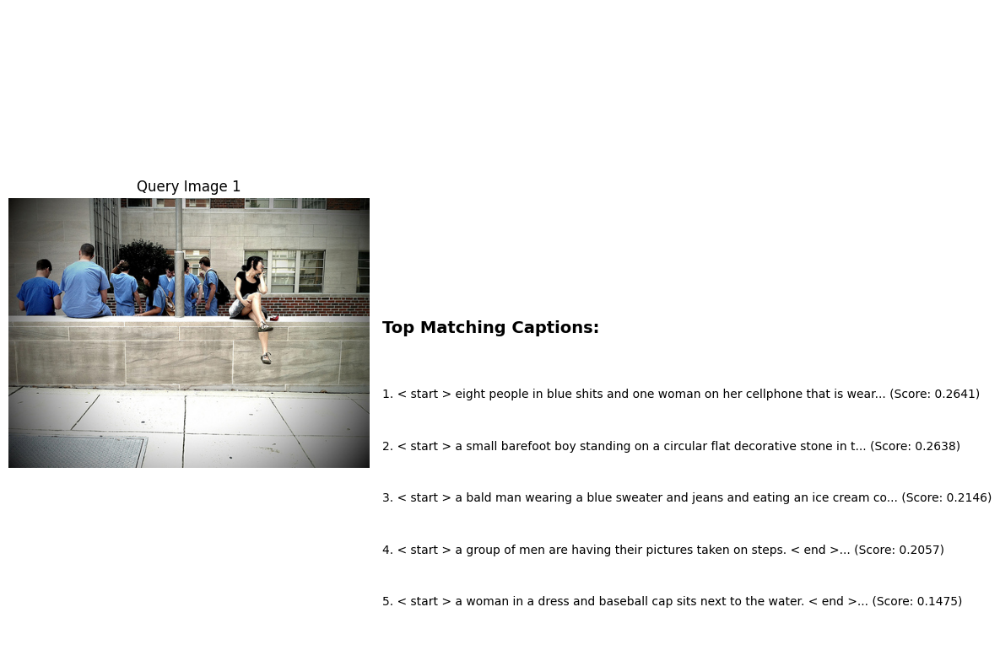

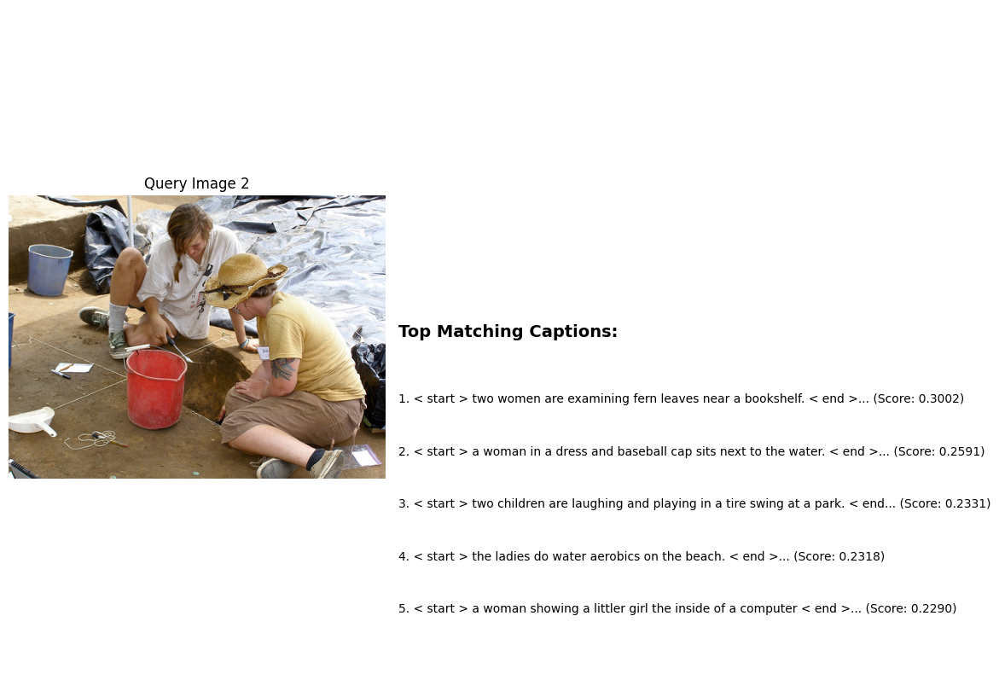

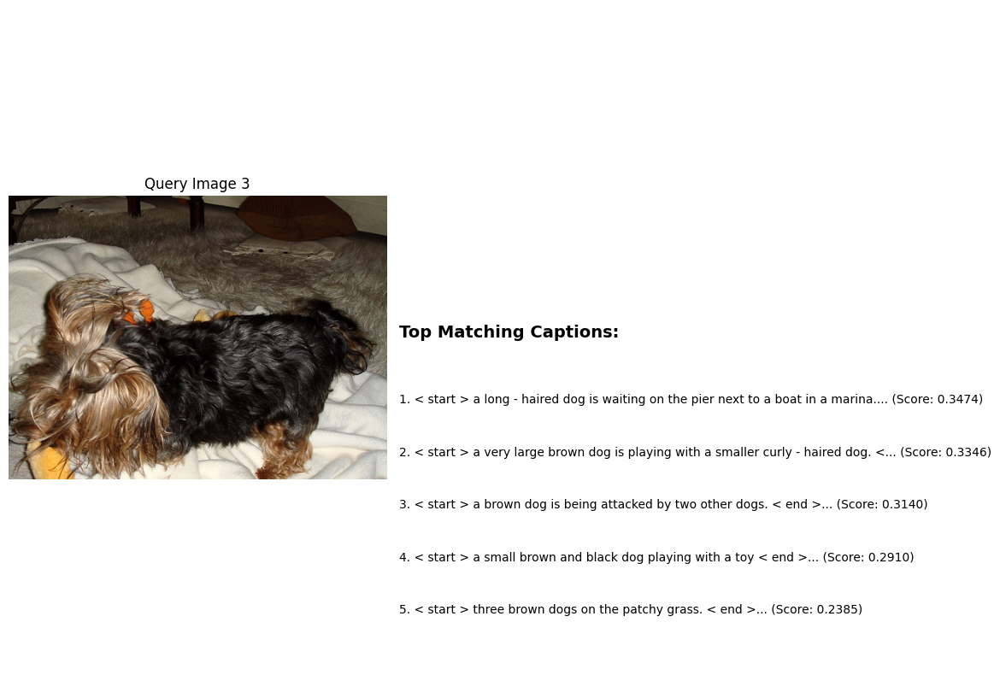

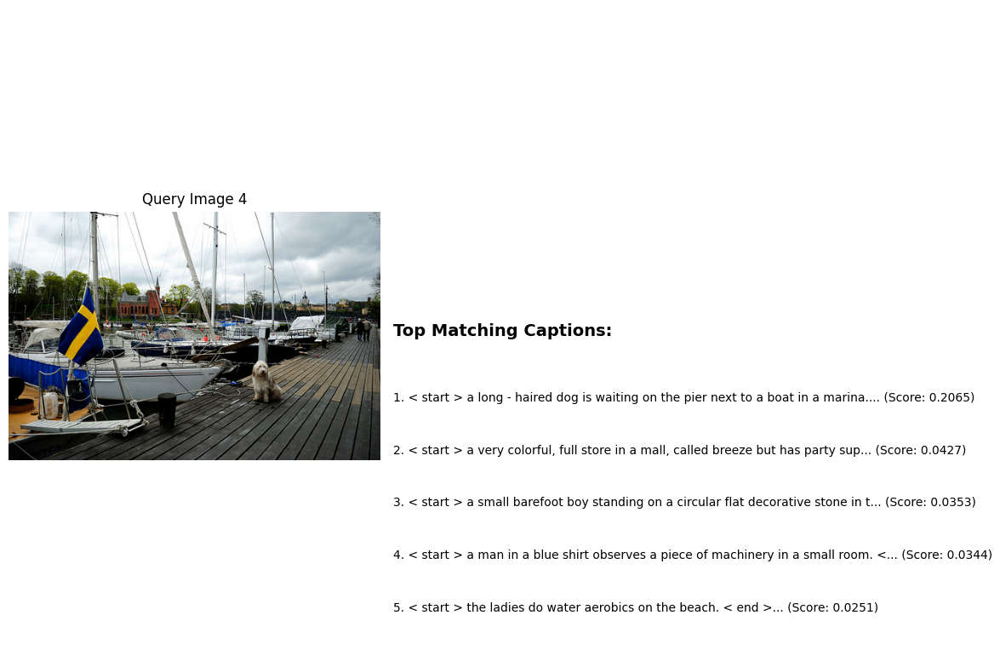

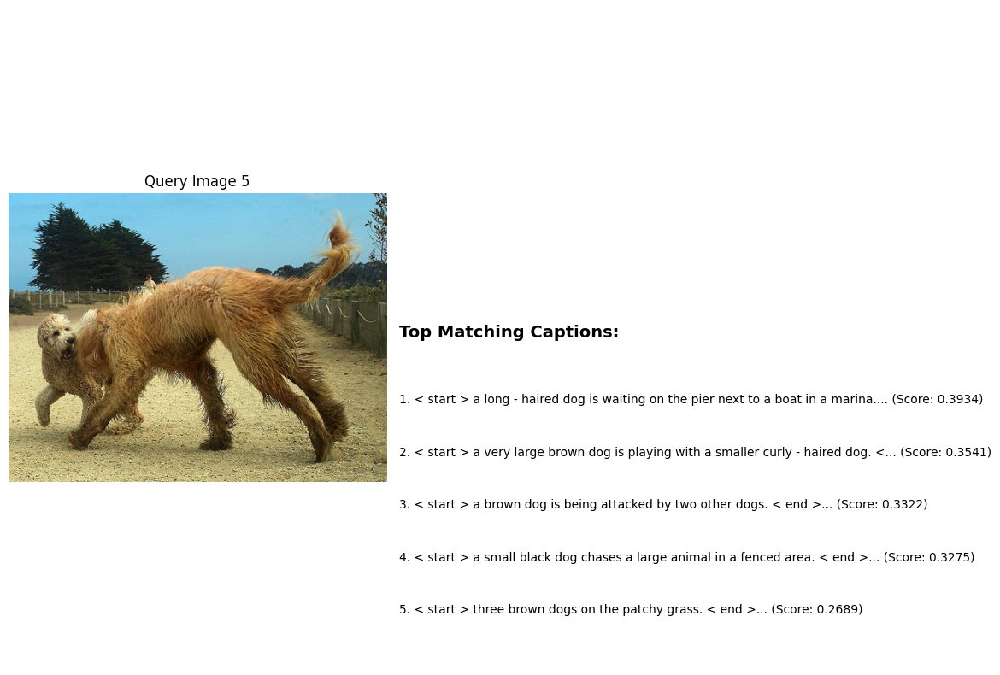


===== TEXT TO IMAGE RETRIEVAL =====


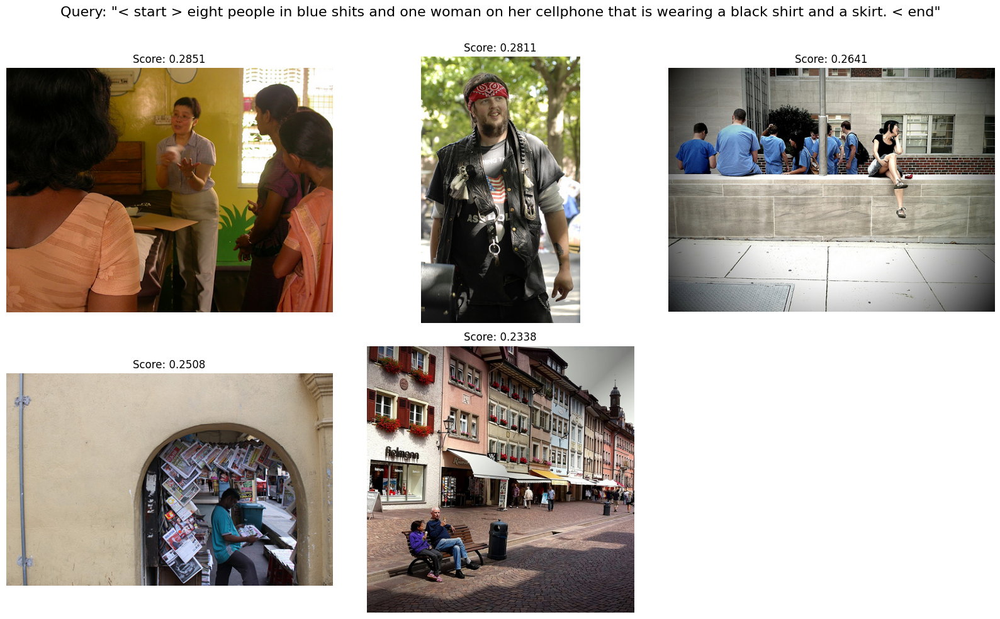

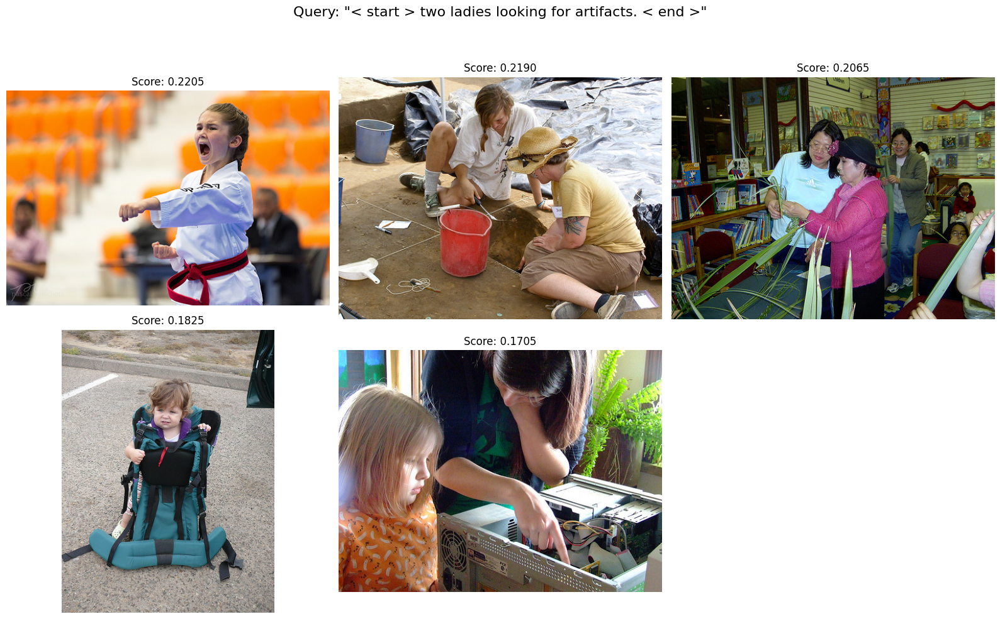

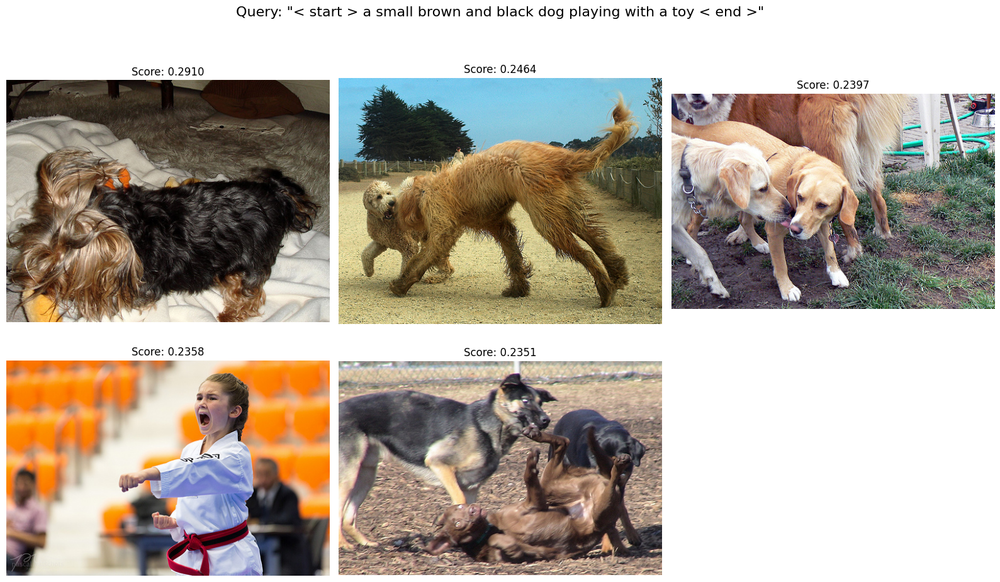

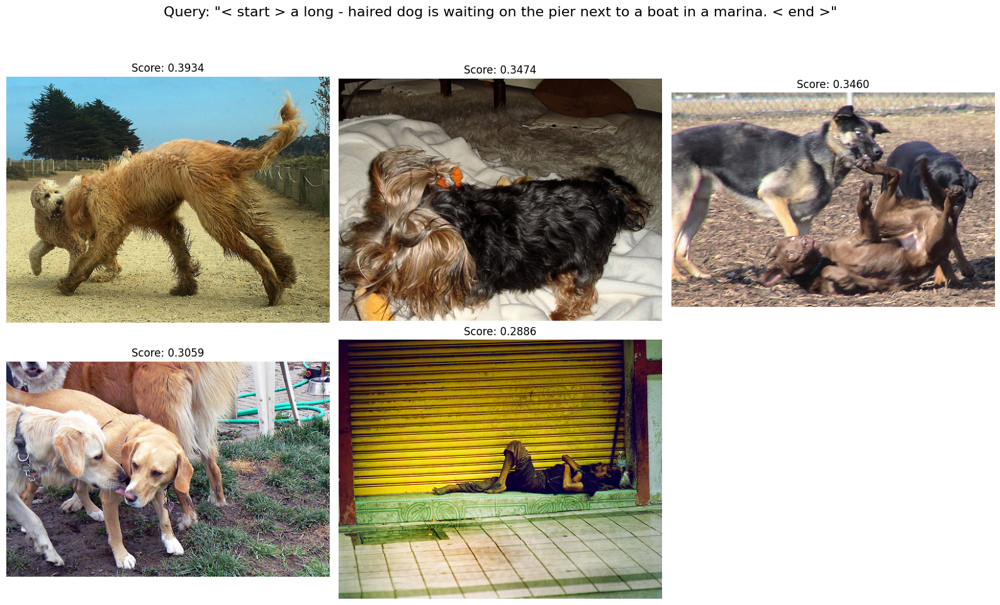

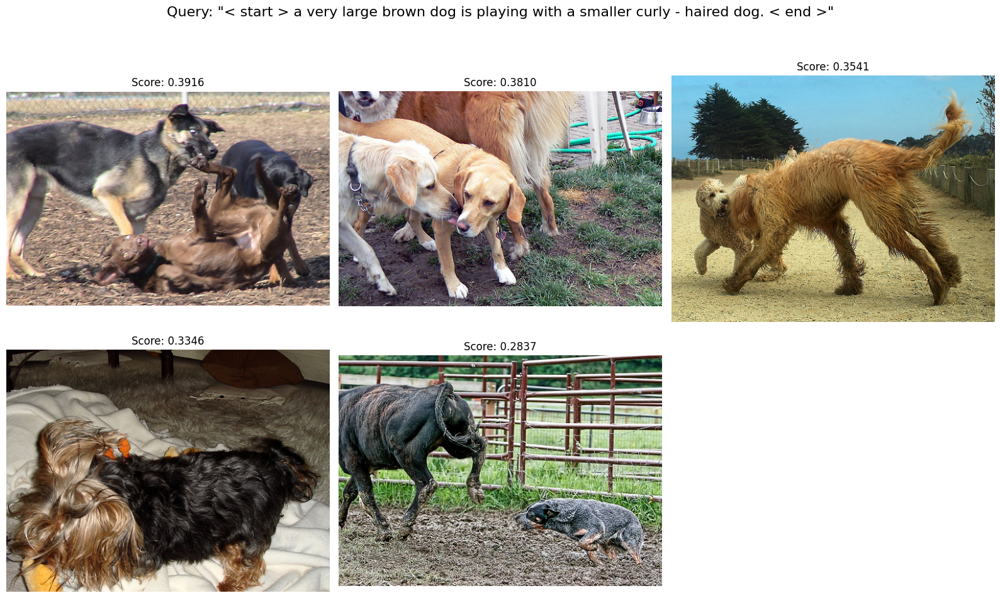

In [121]:
### Okay so we were showing the tranformed image to 224x224 resolution. Show the original image
def demo_retrieval_with_test_loader(model, test_loader, test_dataset, tokenizer, device, k=5):
    """
    Demonstrate retrieval using samples from the test loader.
    Displays original high-quality images instead of transformed ones.
    
    Args:
        model: Trained dual encoder model
        test_loader: DataLoader for test data
        test_dataset: Test dataset with access to original image paths
        tokenizer: BERT tokenizer
        device: Device to run model on
        k: Number of top matches to show
    """
    model.eval()
    
    # Get a batch from the test loader and keep track of indices
    batch_idx = 0
    for images, captions in test_loader:
        # Calculate the absolute indices in the dataset for this batch
        batch_size = images.shape[0]
        dataset_indices = list(range(batch_idx * batch_size, (batch_idx * batch_size) + batch_size))
        
        # Move to device
        images = images.to(device)
        
        # Check what kind of caption format we have
        if isinstance(captions, torch.Tensor):
            # If captions is just token IDs without attention mask
            input_ids = captions.to(device)
            attention_mask = torch.ones_like(input_ids).to(device)
        else:
            # If your loader returns something else, adjust accordingly
            print(f"Unexpected caption format: {type(captions)}")
            continue
        
        # Get all features
        with torch.no_grad():
            image_features, text_features = model(images, input_ids, attention_mask)
        
        # Convert features to CPU for processing
        image_features = image_features.cpu()
        text_features = text_features.cpu()
        
        break  # We only need one batch
    
    # Compute full similarity matrix
    similarity = torch.matmul(image_features, text_features.T)
    
    # Get a few random indices for demo
    num_samples = min(5, len(images))
    sample_indices = random.sample(range(len(images)), num_samples)
    
    # Demo 1: Image to Text Retrieval
    print("\n===== IMAGE TO TEXT RETRIEVAL =====")
    for i, idx in enumerate(sample_indices):
        # Get the dataset index for this image
        dataset_idx = dataset_indices[idx]
        
        # Get original image path (adjust based on your dataset structure)
        # You may need to modify this based on how your dataset is structured
        image_path = test_dataset.image_paths[dataset_idx]
        
        # Load original high-quality image
        try:
            original_img = Image.open(image_path).convert('RGB')
        except Exception as e:
            print(f"Error loading original image {image_path}: {e}")
            # Fall back to transformed image if original can't be loaded
            img = images[idx].cpu()
            original_img = transforms.ToPILImage()(img)
        
        # Get similarity scores for this image with all texts
        img_text_sim = similarity[idx]
        
        # Get top k matches
        values, indices = img_text_sim.topk(k)
        
        # Display image
        plt.figure(figsize=(12, 8))
        plt.subplot(1, 2, 1)
        plt.imshow(original_img)
        plt.title(f"Query Image {i+1}")
        plt.axis('off')
        
        # Display retrieved captions
        plt.subplot(1, 2, 2)
        plt.axis('off')
        plt.text(0, 0.5, "Top Matching Captions:", fontsize=14, fontweight='bold')
        
        for j, (score, text_idx) in enumerate(zip(values, indices)):
            caption = tokenizer.decode(input_ids[text_idx], skip_special_tokens=True)
            plt.text(0, 0.4 - j*0.08, f"{j+1}. {caption[:80]}... (Score: {score:.4f})")
        
        plt.tight_layout()
        plt.show()
    
    # Demo 2: Text to Image Retrieval
    print("\n===== TEXT TO IMAGE RETRIEVAL =====")
    for i, idx in enumerate(sample_indices):
        # Get a caption
        caption = tokenizer.decode(input_ids[idx], skip_special_tokens=True)
        
        # Get similarity scores for this text with all images
        text_img_sim = similarity[:, idx]
        
        # Get top k matches
        values, indices = text_img_sim.topk(k)
        
        # Display caption and retrieved images
        plt.figure(figsize=(16, 10))
        plt.suptitle(f'Query: "{caption}"', fontsize=16)
        
        for j, (score, img_idx) in enumerate(zip(values, indices)):
            # Get the dataset index for this image
            dataset_img_idx = dataset_indices[img_idx]
            
            # Get original image path
            image_path = test_dataset.image_paths[dataset_img_idx]
            
            # Load original high-quality image
            try:
                original_img = Image.open(image_path).convert('RGB')
                plt.subplot(2, 3, j+1)
                plt.imshow(original_img)
                plt.title(f"Score: {score:.4f}")
                plt.axis('off')
            except Exception as e:
                print(f"Error loading original image {image_path}: {e}")
                # Fall back to transformed image
                img = images[img_idx].cpu()
                plt.subplot(2, 3, j+1)
                plt.imshow(transforms.ToPILImage()(img))
                plt.title(f"Score: {score:.4f} (low-res fallback)")
                plt.axis('off')
        
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()

demo_retrieval_with_test_loader(model, test_loader, test_dataset, tokenizer, device)

In [84]:
## In the above cell we can see the model performance is pretty realiable. The model can retrieve caption for an image 
## that capture the context with reasonable R score. 

In [85]:
## Details of the scoring metrices.


# Recall at K (R@K): The percentage of queries where the correct match appears in the top K results.

# R@1: Percentage of queries where the correct match is the top result
# R@5: Percentage of queries where the correct match is in the top 5 results
# R@10: Percentage of queries where the correct match is in the top 10 results


# Median Rank: The median position of the correct match in the ranked results list.

# Lower is better (1 would be perfect)
# Less sensitive to outliers than mean rank


# Interpretation:

# Higher R@K values mean better retrieval performance
# R@1 is the most stringent metric (perfect R@1 = 100% means the system always puts the correct match first)
# R@5 and R@10 give credit if the correct match is among the top few results


# Directionality:

# Image-to-Text: Given an image, find the correct caption
# Text-to-Image: Given a caption, find the correct image
# Both directions are evaluated separately, as performance can differ

### 2. Visual Question Answering (VQA): We will use VQA dataset to train a model that can answer questions related to an image

In [13]:
from transformers import AutoTokenizer
import json
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as transforms
from transformers import BertModel

2025-04-04 23:50:17.319655: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-04 23:50:20.632620: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743832221.040874 3481808 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743832221.180906 3481808 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-04 23:50:22.810600: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

In [14]:
import torch.optim as optim
from tqdm import tqdm

In [24]:
# Let's see what the questions and annonations data looks like
with open('vqa_dataset/v2_OpenEnded_mscoco_train2014_questions.json', 'r') as f:
    questions_data = json.load(f)
with open('vqa_dataset/v2_mscoco_train2014_annotations.json', 'r') as f:
    annotations_data = json.load(f)
print(questions_data.keys())
print(annotations_data.keys())

dict_keys(['info', 'task_type', 'data_type', 'license', 'data_subtype', 'questions'])
dict_keys(['info', 'license', 'data_subtype', 'annotations', 'data_type'])


In [25]:
print(len(questions_data['questions']))
print(len(annotations_data['annotations']))

443757
443757


In [26]:
# let's check the first question and annotation
questions_data['questions'][0]

{'image_id': 458752,
 'question': 'What is this photo taken looking through?',
 'question_id': 458752000}

In [27]:
annotations_data['annotations'][0]

{'question_type': 'what is this',
 'multiple_choice_answer': 'net',
 'answers': [{'answer': 'net', 'answer_confidence': 'maybe', 'answer_id': 1},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 2},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 3},
  {'answer': 'netting', 'answer_confidence': 'yes', 'answer_id': 4},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 5},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 6},
  {'answer': 'mesh', 'answer_confidence': 'maybe', 'answer_id': 7},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 8},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 9},
  {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 10}],
 'image_id': 458752,
 'answer_type': 'other',
 'question_id': 458752000}

In [28]:
# The dataset is quite interesting and has a lot of information. For one question (ID: 458752000), there are 10 entries for 
# for answers along with question type, answer type, confidence of answer etc. 

In [32]:
### Let's understand the data. Plot answer, questions distributions

Total answers: 4437570
Total unique answers: 162496
Top 10 answers cover 50.37% of all answers
Top 100 answers cover 66.72% of all answers
Top 1000 answers cover 83.08% of all answers
Top 3000 answers cover 88.87% of all answers
Top 5000 answers cover 91.00% of all answers


<Figure size 1500x600 with 0 Axes>

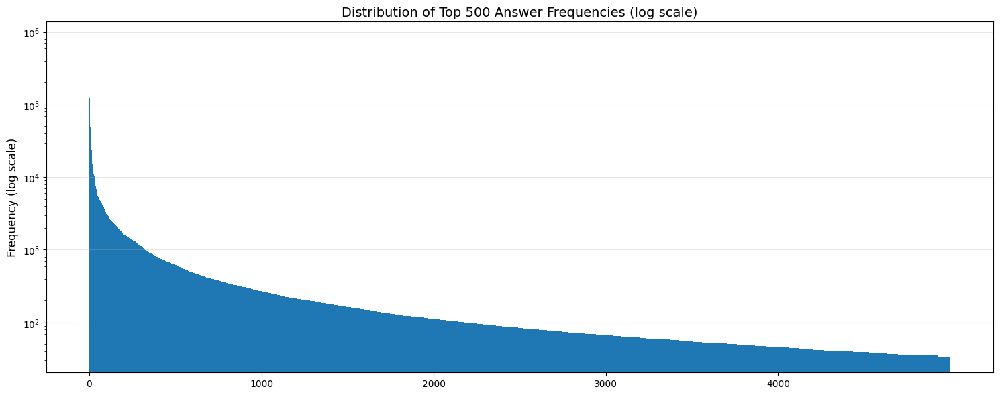

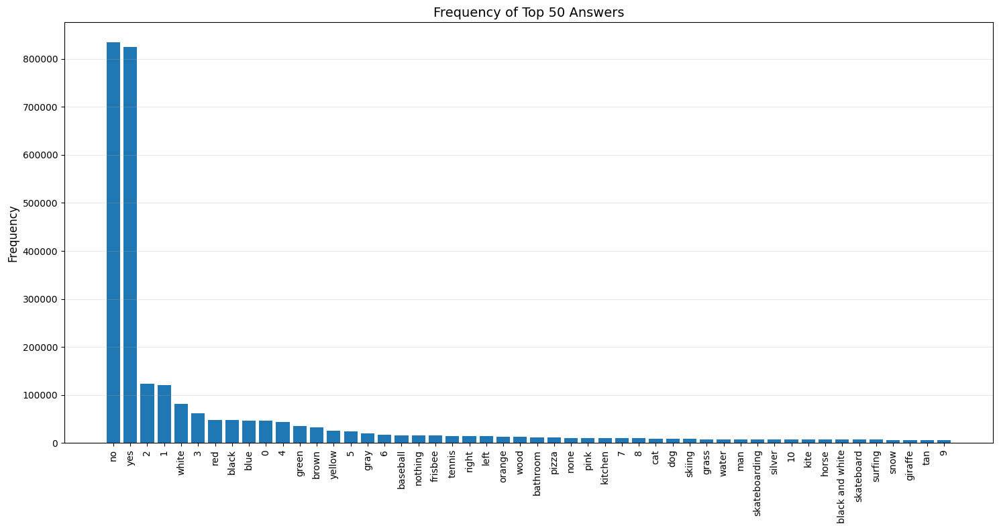

In [33]:
import json
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter
import pandas as pd

# Load the annotations file which contains all answers
with open('vqa_dataset/v2_mscoco_train2014_annotations.json', 'r') as f:
    annotations_data = json.load(f)

# Extract all answers
all_answers = [ans['answer'].lower() for ann in annotations_data['annotations'] 
               for ans in ann['answers']]

# Count unique answers and their frequencies
answer_counts = Counter(all_answers)
unique_answers = len(answer_counts)

# Print statistics
print(f"Total answers: {len(all_answers)}")
print(f"Total unique answers: {unique_answers}")

# Calculate coverage statistics
total_count = len(all_answers)
for k in [10, 100, 1000, 3000, 5000]:
    if k > unique_answers:
        break
    top_k_count = sum(count for _, count in answer_counts.most_common(k))
    print(f"Top {k} answers cover {top_k_count / total_count * 100:.2f}% of all answers")


# Create a better sorted bar plot
plt.figure(figsize=(15, 6))
counts = [count for _, count in answer_counts.most_common()]


# Also create a log-scale version to better see the distribution
plt.figure(figsize=(15, 6))
tick_positions = list(range(0,5000,1000))
plt.bar(range(5000), counts[:5000], width=1.0)
plt.ylabel('Frequency (log scale)', fontsize=12)
plt.title('Distribution of Top 500 Answer Frequencies (log scale)', fontsize=14)
plt.yscale('log')
plt.xticks(tick_positions, tick_positions)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('sorted_answer_frequencies_log.png')
plt.show()

# Create a zoomed-in view of the top 50 answers with their text labels
plt.figure(figsize=(15, 8))
top_50_answers = answer_counts.most_common(50)
labels = [ans for ans, _ in top_50_answers]
values = [count for _, count in top_50_answers]

plt.bar(range(len(values)), values)
plt.ylabel('Frequency', fontsize=12)
plt.title('Frequency of Top 50 Answers', fontsize=14)
plt.xticks(range(len(labels)), labels, rotation=90)
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.savefig('top_50_answers.png')
plt.show()

Total questions: 443757
Total unique images: 82783
Min questions per image: 3
Max questions per image: 275
Mean questions per image: 5.36
Median questions per image: 4.0


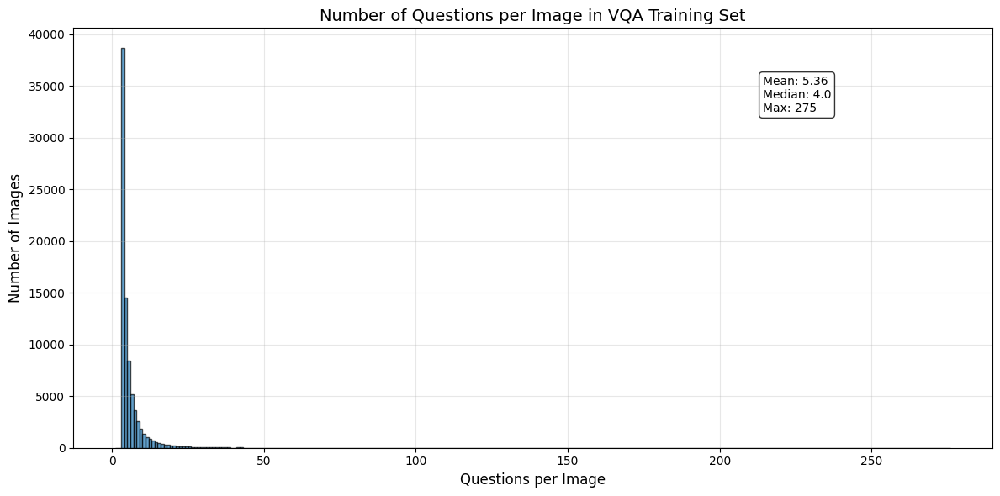


Detailed distribution of questions per image:
3 questions: 38674 images (46.72%)
4 questions: 14534 images (17.56%)
5 questions: 8445 images (10.20%)
6 questions: 5214 images (6.30%)
7 questions: 3637 images (4.39%)
8 questions: 2573 images (3.11%)
9 questions: 1807 images (2.18%)
10 questions: 1375 images (1.66%)
11 questions: 1056 images (1.28%)
12 questions: 838 images (1.01%)


In [10]:
import json
#import matplotlib.pyplot as plt
#import numpy as np
from collections import Counter

# Load the training questions JSON file
with open('vqa_dataset/v2_OpenEnded_mscoco_train2014_questions.json', 'r') as f:
    train_questions = json.load(f)

# Count questions per image
image_question_counts = Counter()
for question in train_questions['questions']:
    image_id = question['image_id']
    image_question_counts[image_id] += 1

# Get statistics
counts = list(image_question_counts.values())

# Print some statistics
print(f"Total questions: {len(train_questions['questions'])}")
print(f"Total unique images: {len(image_question_counts)}")
print(f"Min questions per image: {min(counts)}")
print(f"Max questions per image: {max(counts)}")
print(f"Mean questions per image: {np.mean(counts):.2f}")
print(f"Median questions per image: {np.median(counts)}")

# Create histogram
plt.figure(figsize=(12, 6))
plt.hist(counts, bins=range(1, max(counts) + 2), alpha=0.7, edgecolor='black')
plt.title('Number of Questions per Image in VQA Training Set', fontsize=14)
plt.xlabel('Questions per Image', fontsize=12)
plt.ylabel('Number of Images', fontsize=12)
plt.grid(alpha=0.3)

# Add summary statistics as text
stats_text = f"Mean: {np.mean(counts):.2f}\nMedian: {np.median(counts)}\nMax: {max(counts)}"
plt.annotate(stats_text, xy=(0.75, 0.8), xycoords='axes fraction', 
            bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8))

plt.tight_layout()
plt.show()

# Optional: Print detailed distribution
print("\nDetailed distribution of questions per image:")
question_dist = Counter(counts)
for num_q, num_images in sorted(question_dist.items()):
    percentage = (num_images / len(image_question_counts)) * 100
    if percentage > 1.0:  # Only show categories with >1% of images
        print(f"{num_q} questions: {num_images} images ({percentage:.2f}%)")

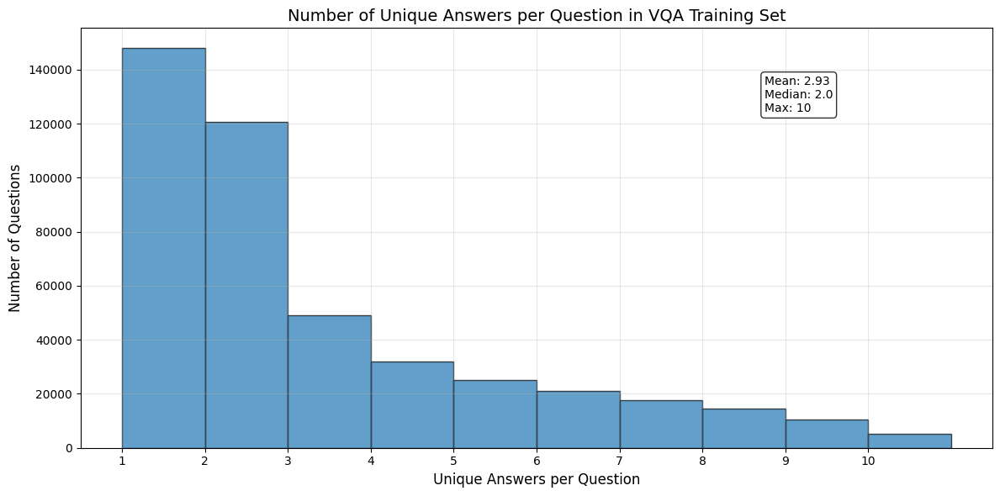


Distribution of unique answers per question:
1 unique answers: 148013 questions (33.35%)
2 unique answers: 120812 questions (27.22%)
3 unique answers: 48939 questions (11.03%)
4 unique answers: 31907 questions (7.19%)
5 unique answers: 25110 questions (5.66%)
6 unique answers: 21069 questions (4.75%)
7 unique answers: 17782 questions (4.01%)
8 unique answers: 14583 questions (3.29%)
9 unique answers: 10395 questions (2.34%)
10 unique answers: 5147 questions (1.16%)

Analyzing annotator agreement:


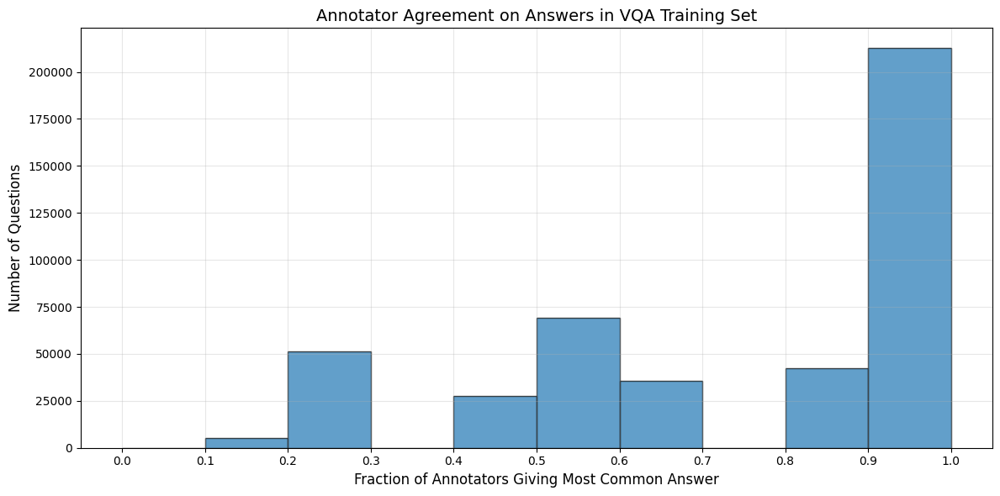


Distribution of annotator agreement:
0.0-0.1: 0 questions (0.00%)
0.1-0.2: 5147 questions (1.16%)
0.2-0.3: 51276 questions (11.55%)
0.3-0.4: 0 questions (0.00%)
0.4-0.5: 27688 questions (6.24%)
0.5-0.6: 69056 questions (15.56%)
0.6-0.7: 35650 questions (8.03%)
0.7-0.8: 0 questions (0.00%)
0.8-0.9: 42203 questions (9.51%)
0.9-1.0: 212737 questions (47.94%)


In [34]:
import json
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

# Load the annotations file which contains the answers
with open('vqa_dataset/v2_mscoco_train2014_annotations.json', 'r') as f:
    annotations = json.load(f)

# Count unique answers per question
unique_answers_per_question = []

for ann in annotations['annotations']:
    # Extract all answers for this question
    answers = [a['answer'].lower().strip() for a in ann['answers']]
    
    # Count unique answers (case insensitive)
    unique_count = len(set(answers))
    unique_answers_per_question.append(unique_count)

# Calculate statistics
mean_unique = np.mean(unique_answers_per_question)
median_unique = np.median(unique_answers_per_question)
max_unique = np.max(unique_answers_per_question)

# Create histogram
plt.figure(figsize=(12, 6))
plt.hist(unique_answers_per_question, bins=range(1, max_unique + 2), alpha=0.7, edgecolor='black')
plt.title('Number of Unique Answers per Question in VQA Training Set', fontsize=14)
plt.xlabel('Unique Answers per Question', fontsize=12)
plt.ylabel('Number of Questions', fontsize=12)
plt.grid(alpha=0.3)
plt.xticks(range(1, max_unique + 1))

# Add summary statistics as text
stats_text = f"Mean: {mean_unique:.2f}\nMedian: {median_unique:.1f}\nMax: {max_unique}"
plt.annotate(stats_text, xy=(0.75, 0.8), xycoords='axes fraction', 
            bbox=dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8))

plt.tight_layout()
plt.show()

# Print detailed distribution
print("\nDistribution of unique answers per question:")
answer_dist = Counter(unique_answers_per_question)
for num_a, num_questions in sorted(answer_dist.items()):
    percentage = (num_questions / len(unique_answers_per_question)) * 100
    print(f"{num_a} unique answers: {num_questions} questions ({percentage:.2f}%)")

# Additionally, you can analyze agreement among annotators
print("\nAnalyzing annotator agreement:")
agreement_scores = []

for ann in annotations['annotations']:
    answers = [a['answer'].lower().strip() for a in ann['answers']]
    answer_counts = Counter(answers)
    
    # Calculate the percentage of annotators who gave the most common answer
    most_common_answer_count = answer_counts.most_common(1)[0][1]
    agreement_score = most_common_answer_count / len(ann['answers'])
    agreement_scores.append(agreement_score)

# Plot agreement distribution
plt.figure(figsize=(12, 6))
plt.hist(agreement_scores, bins=np.linspace(0, 1, 11), alpha=0.7, edgecolor='black')
plt.title('Annotator Agreement on Answers in VQA Training Set', fontsize=14)
plt.xlabel('Fraction of Annotators Giving Most Common Answer', fontsize=12)
plt.ylabel('Number of Questions', fontsize=12)
plt.grid(alpha=0.3)
plt.xticks(np.linspace(0, 1, 11))

plt.tight_layout()
plt.show()

# Print agreement distribution
print("\nDistribution of annotator agreement:")
agreement_ranges = [(0.1*i, 0.1*(i+1)) for i in range(10)]
for lower, upper in agreement_ranges:
    count = sum(1 for score in agreement_scores if lower <= score < upper)
    if upper == 1.0:  # Include 1.0 in the last bin
        count = sum(1 for score in agreement_scores if lower <= score <= upper)
    percentage = (count / len(agreement_scores)) * 100
    print(f"{lower:.1f}-{upper:.1f}: {count} questions ({percentage:.2f}%)")

In [35]:
# let's build a dataset: Build a vocabulary set with top 3000 most frequent answers (as that covers around 90% of the total answers)
#and leave other as unknown. Transform the  image and tokenize the questions. Make "1 image-1 questions" a datapoint along with 
#a answer weight distribution. So total datapoint would be same as number of questions. Also we can see that there are about 



In [37]:
class VQADataset(Dataset):
    def __init__(self, questions_file, annotations_file, image_dir, transform=None, tokenizer=None, max_length=32, answer_top_k=3000):
        # Load questions
        with open(questions_file, 'r') as f:
            self.questions = json.load(f)['questions']
            
        # Load annotations if available (not for test set)
        self.has_annotations = annotations_file is not None
        if self.has_annotations:
            with open(annotations_file, 'r') as f:
                self.annotations = json.load(f)['annotations']
            
            # Create answer vocabulary (top k most frequent answers)
            all_answers = [ans['answer'] for ann in self.annotations for ans in ann['answers']]
            answer_counts = pd.Series(all_answers).value_counts()
            self.answer_vocab = {ans: idx for idx, ans in enumerate(answer_counts.index[:answer_top_k])}
            self.unk_ans_idx = len(self.answer_vocab)
        
        self.image_dir = image_dir
        self.transform = transform or transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        self.tokenizer = tokenizer or AutoTokenizer.from_pretrained('bert-base-uncased')
        self.max_length = max_length
        
    def __len__(self):
        return len(self.questions)
    
    # def __getitem__(self, idx):
    #     # Get question and image info
    #     question_data = self.questions[idx]
    #     question_id = question_data['question_id']
    #     image_id = question_data['image_id']
    #     question_text = question_data['question']
        
        # Load and transform image
        #image_filename = f"COCO_train2014_{image_id:012d}.jpg"  # COCO format
        #image_path = os.path.join(self.image_dir, image_filename)
        #image = Image.open(image_path).convert('RGB')
    def __getitem__(self, idx):
        # Get question and image info
        question_data = self.questions[idx]
        question_id = question_data['question_id']
        image_id = question_data['image_id']
        question_text = question_data['question']
        
        # Determine the correct image filename format based on the directory
        if 'train' in self.image_dir:
            image_filename = f"COCO_train2014_{image_id:012d}.jpg"
        elif 'val' in self.image_dir:
            image_filename = f"COCO_val2014_{image_id:012d}.jpg"
        else:
            # For test or other directories
            image_filename = f"COCO_test2015_{image_id:012d}.jpg"  # Adjust as needed
        
        image_path = os.path.join(self.image_dir, image_filename)
        
        # Add error handling for missing images
        try:
            image = Image.open(image_path).convert('RGB')
        except FileNotFoundError:
            print(f"Warning: Image not found at {image_path}. Trying alternative format...")
            # Try alternative format as fallback
            image_filename = f"{image_id:012d}.jpg"
            image_path = os.path.join(self.image_dir, image_filename)
            image = Image.open(image_path).convert('RGB')
        
        
        
        image = self.transform(image)
        
        # Tokenize question
        question_tokens = self.tokenizer(
            question_text,
            padding='max_length',
            truncation=True,
            max_length=self.max_length,
            return_tensors='pt'
        )
        
        # Extract tokens and attention mask
        input_ids = question_tokens['input_ids'].squeeze(0)
        attention_mask = question_tokens['attention_mask'].squeeze(0)
        
        # If we have annotations, prepare answer target
        if self.has_annotations:
            # Find corresponding annotation
            annotation = next(ann for ann in self.annotations if ann['question_id'] == question_id)
            
            # Create answer target (multi-hot encoding)
            answers = [ans['answer'] for ans in annotation['answers']]
            answer_weights = torch.zeros(len(self.answer_vocab) + 1)  # +1 for unknown
            
            for answer in answers:
                if answer in self.answer_vocab:
                    ans_idx = self.answer_vocab[answer]
                    # Normalize by number of annotators (usually 10)
                    answer_weights[ans_idx] += 1.0 / len(answers)
                else:
                    # Unknown answer
                    answer_weights[self.unk_ans_idx] += 1.0 / len(answers)
                    
            return {
                'image': image,
                'input_ids': input_ids,
                'attention_mask': attention_mask,
                'answer_weights': answer_weights,
                'question_id': question_id
            }
        else:
            # For test set, we don't have annotations
            return {
                'image': image,
                'input_ids': input_ids,
                'attention_mask': attention_mask,
                'question_id': question_id
            }

            

In [38]:
# Data setup
train_dataset = VQADataset(
    questions_file='vqa_dataset/v2_OpenEnded_mscoco_train2014_questions.json',
    annotations_file='vqa_dataset/v2_mscoco_train2014_annotations.json',
    image_dir='vqa_dataset/train2014'
)

val_dataset = VQADataset(
    questions_file='vqa_dataset/v2_OpenEnded_mscoco_val2014_questions.json',
    annotations_file='vqa_dataset/v2_mscoco_val2014_annotations.json',
    image_dir='vqa_dataset/val2014',
    answer_top_k=train_dataset.unk_ans_idx  # Use same vocabulary as training
)

# Load test dataset (without annotations)
test_dataset = VQADataset(
    questions_file='vqa_dataset/v2_OpenEnded_mscoco_test2015_questions.json',
    annotations_file=None,  # No annotations for test set
    image_dir='vqa_dataset/test2015'
)

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Print number of batches and samples in the train_loader
num_batches = len(train_loader)
num_samples = len(train_dataset)
batch_size = train_loader.batch_size

print(f"Training DataLoader:")
print(f"Total samples: {num_samples}")
print(f"Batch size: {batch_size}")
print(f"Number of batches: {num_batches}")

# To get a sample batch and print its dimensions
sample_batch = next(iter(train_loader))
print("\nSample batch dimensions:")
for key, value in sample_batch.items():
    if isinstance(value, torch.Tensor):
        print(f"{key}: {value.shape}")
    else:
        print(f"{key}: {type(value)}")

Training DataLoader:
Total samples: 443757
Batch size: 64
Number of batches: 6934

Sample batch dimensions:
image: torch.Size([64, 3, 224, 224])
input_ids: torch.Size([64, 32])
attention_mask: torch.Size([64, 32])
answer_weights: torch.Size([64, 3001])
question_id: torch.Size([64])


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

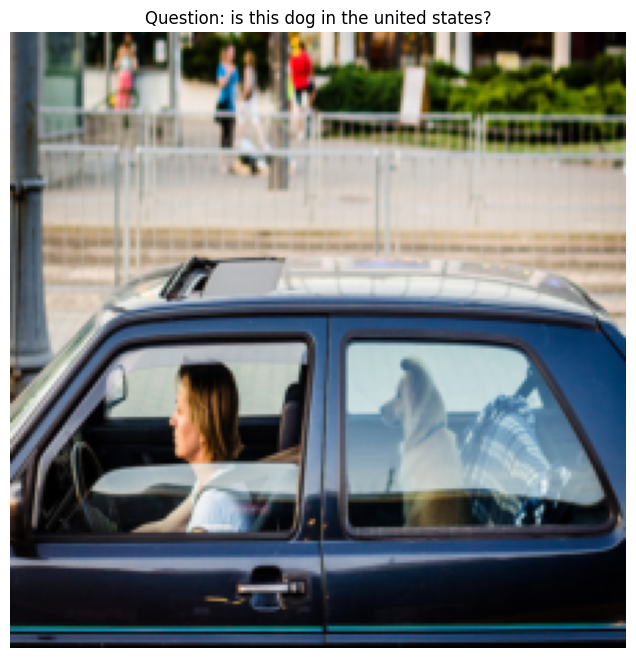

Question: is this dog in the united states?


In [65]:
## Let's see what we have in train_loader
# Get a batch from the train_loader
for batch in train_loader:
    # Extract the first example from the batch
    image = batch['image'][0]
    input_ids = batch['input_ids'][0]
    answer_weights = batch['answer_weights'][0] if 'answer_weights' in batch else None
    
    # Decode the question from input_ids
    question_text = tokenizer.decode(input_ids, skip_special_tokens=True)
    
    # Find top answers if answer_weights are available
    top_answers = []
    if answer_weights is not None:
        # Get indices of top 3 answers with highest weights
        top_indices = torch.topk(answer_weights, k=min(3, len(answer_weights))).indices
        for idx in top_indices:
            if idx in idx_to_answer:
                weight = answer_weights[idx].item()
                top_answers.append((idx_to_answer[idx], weight))
    
    # Display the image and information
    plt.figure(figsize=(10, 8))
    # Convert tensor to image for display
    img = image.permute(1, 2, 0).cpu().numpy()
    # Denormalize the image
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    
    plt.imshow(img)
    plt.title(f"Question: {question_text}")
    plt.axis('off')
    plt.show()
    
    print(f"Question: {question_text}")
    
    if top_answers:
        print("\nTop Answers:")
        for answer, weight in top_answers:
            print(f"- {answer} (weight: {weight:.4f})")
    
    # Only show one example and then break
    break

Building image_id index (first time only)...


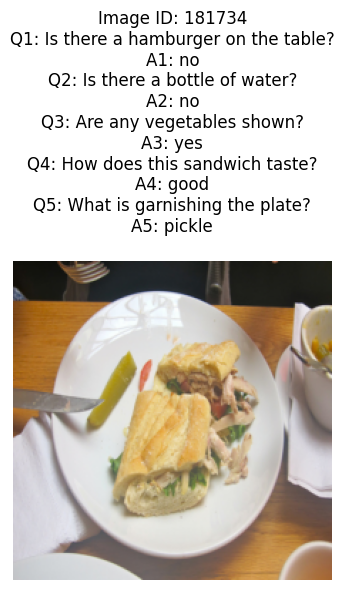

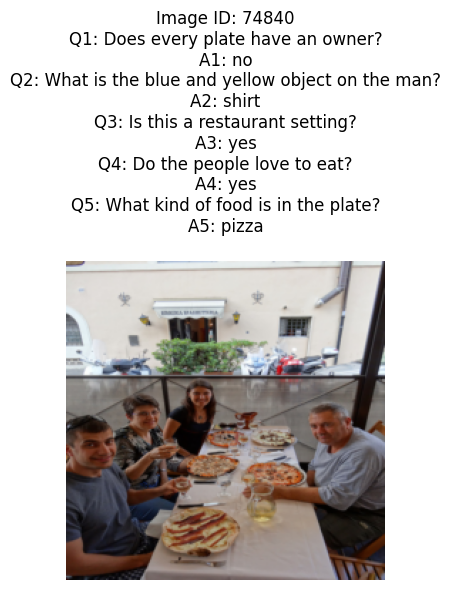

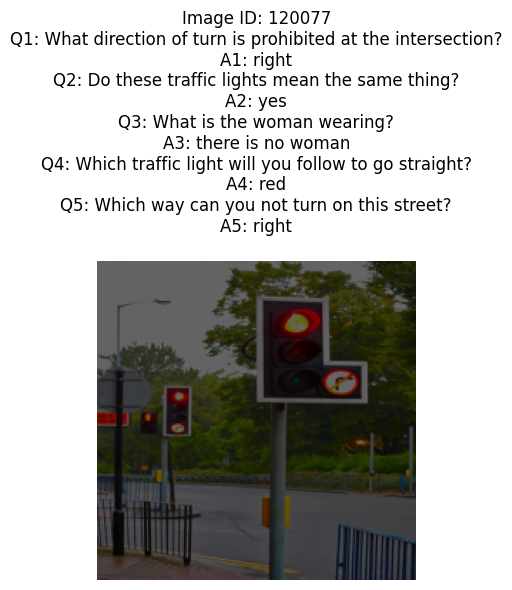

In [39]:
# Visualize some of the images: Function to denormalize image for visualization
def denormalize(tensor):
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
    return tensor * std + mean
    
def show_multiple_questions_efficiently(dataset, num_images=3, questions_per_image=5):
    # Create index lookup first (do this only once)
    if not hasattr(dataset, 'image_id_to_indices'):
        print("Building image_id index (first time only)...")
        dataset.image_id_to_indices = {}
        dataset.question_id_to_answers = {}
        
        # Pre-index questions by image_id
        for i, question_data in enumerate(dataset.questions):
            image_id = question_data['image_id']
            question_id = question_data['question_id']
            
            if image_id not in dataset.image_id_to_indices:
                dataset.image_id_to_indices[image_id] = []
            dataset.image_id_to_indices[image_id].append(i)
            
        # Pre-index answers by question_id if annotations exist
        if dataset.has_annotations:
            for ann in dataset.annotations:
                question_id = ann['question_id']
                answers = [a['answer'] for a in ann['answers']]
                most_common = max(set(answers), key=answers.count)
                dataset.question_id_to_answers[question_id] = most_common
    
    # Find images with enough questions
    image_ids_with_multiple = [
        img_id for img_id, indices in dataset.image_id_to_indices.items() 
        if len(indices) >= questions_per_image
    ]
    
    # Select random images
    selected_image_ids = random.sample(image_ids_with_multiple, min(num_images, len(image_ids_with_multiple)))
    
    # Display each image with its questions
    for img_id in selected_image_ids:
        # Get the first dataset index for this image
        sample_idx = dataset.image_id_to_indices[img_id][0]
        sample = dataset[sample_idx]
        
        # Get and denormalize image
        img = denormalize(sample['image'])
        img = img.permute(1, 2, 0).numpy()
        img = np.clip(img, 0, 1)
        
        # Get questions for this image
        question_indices = dataset.image_id_to_indices[img_id][:questions_per_image]
        questions_data = []
        
        for idx in question_indices:
            q_data = dataset.questions[idx]
            question_text = q_data['question']
            question_id = q_data['question_id']
            
            # Get answer if available
            answer = "N/A"
            if dataset.has_annotations and question_id in dataset.question_id_to_answers:
                answer = dataset.question_id_to_answers[question_id]
                
            questions_data.append({
                'question_text': question_text,
                'answer': answer
            })
        
        # Display image with questions
        plt.figure(figsize=(8, 6))
        plt.imshow(img)
        
        title = f"Image ID: {img_id}\n"
        for i, q_data in enumerate(questions_data):
            title += f"Q{i+1}: {q_data['question_text']}\nA{i+1}: {q_data['answer']}\n"
            
        plt.title(title)
        plt.axis('off')
        plt.tight_layout()
        plt.show()
        print("\n")

# Use the more efficient function
show_multiple_questions_efficiently(train_dataset, num_images=3, questions_per_image=5)

Image ID with most questions: 150435
Number of questions: 275


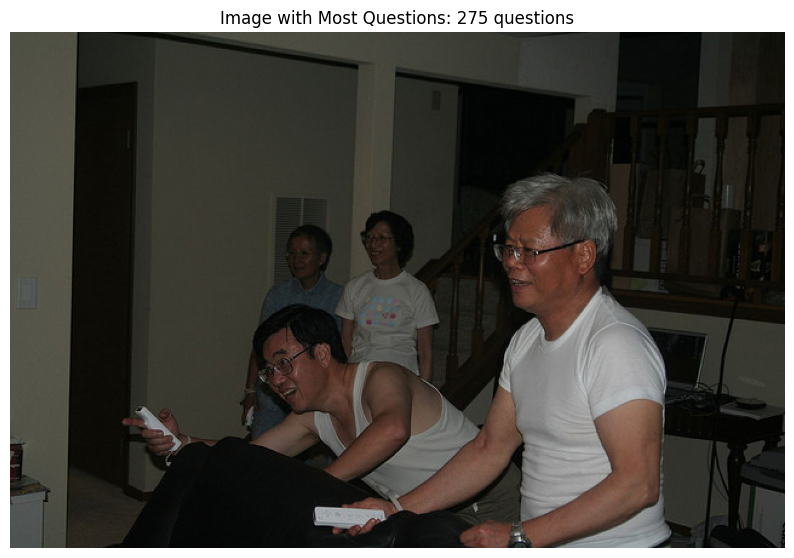


Questions and Answers for this image:
1. Q: Is this person alone?
   A: no (Most common of 1 unique answers)
2. Q: Is the man smiling?
   A: yes (Most common of 1 unique answers)
3. Q: Is this man writing?
   A: no (Most common of 1 unique answers)
4. Q: Who seems more happier?
   A: men (Most common of 8 unique answers)
5. Q: How many people in this photo appear to be holding gaming controllers?
   A: 2 (Most common of 2 unique answers)
6. Q: What is on the man's wrist?
   A: watch (Most common of 5 unique answers)
7. Q: What is in the guys hand?
   A: wii remote (Most common of 6 unique answers)
8. Q: Are they inside?
   A: yes (Most common of 1 unique answers)
9. Q: What color is his hair?
   A: gray (Most common of 3 unique answers)
10. Q: What part of this man's outfit is missing?
   A: shirt (Most common of 6 unique answers)
11. Q: Is this a test waiting room?
   A: no (Most common of 1 unique answers)
12. Q: Is the man wearing a tie?
   A: no (Most common of 1 unique answers)
1

In [147]:
### Show the image with maximum number of questions

import json
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from collections import Counter

# Load the questions and annotations files
with open('vqa_dataset/v2_OpenEnded_mscoco_train2014_questions.json', 'r') as f:
    questions_data = json.load(f)

with open('vqa_dataset/v2_mscoco_train2014_annotations.json', 'r') as f:
    annotations_data = json.load(f)

# Count questions per image
image_question_counts = Counter()
for question in questions_data['questions']:
    image_id = question['image_id']
    image_question_counts[image_id] += 1

# Find the image with the most questions
max_questions_image_id = image_question_counts.most_common(1)[0][0]
max_questions_count = image_question_counts[max_questions_image_id]

print(f"Image ID with most questions: {max_questions_image_id}")
print(f"Number of questions: {max_questions_count}")

# Find all questions for this image
image_questions = []
for question in questions_data['questions']:
    if question['image_id'] == max_questions_image_id:
        # Find the corresponding annotation to get answers
        for annotation in annotations_data['annotations']:
            if annotation['question_id'] == question['question_id']:
                # Get most common answer
                answers = [a['answer'] for a in annotation['answers']]
                most_common_answer = Counter(answers).most_common(1)[0][0]
                
                image_questions.append({
                    'question_id': question['question_id'],
                    'question': question['question'],
                    'most_common_answer': most_common_answer,
                    'all_answers': answers
                })
                break

# Load and display the image (adapt the path to your COCO images location)
image_filename = f"COCO_train2014_{max_questions_image_id:012d}.jpg"  # COCO 2014 format
image_path = f"vqa_dataset/train2014/{image_filename}"  # Adjust path as needed

try:
    img = Image.open(image_path)
    
    # Display image
    plt.figure(figsize=(10, 8))
    plt.imshow(np.asarray(img))
    plt.title(f"Image with Most Questions: {max_questions_count} questions")
    plt.axis('off')
    plt.show()
    
    # Print all questions and answers
    print("\nQuestions and Answers for this image:")
    for i, q in enumerate(image_questions):
        print(f"{i+1}. Q: {q['question']}")
        print(f"   A: {q['most_common_answer']} (Most common of {len(set(q['all_answers']))} unique answers)")
        
except FileNotFoundError:
    print(f"Image file not found at {image_path}. Please adjust the path to your COCO images.")

In [42]:
# Build a model now: ResNet to encode image. Bert to encode the questions. Use cross attention on image and text. Predict answer
# weight distribution and estimate how similar it is with the real distribution using BCEWithLogitsLoss loss function.

class CrossAttentionFusion(nn.Module):
    def __init__(self, hidden_size):
        super(CrossAttentionFusion, self).__init__()
        self.attention = nn.MultiheadAttention(hidden_size, num_heads=8)
        
    def forward(self, image_features, question_features):
        # Reshape for attention (seq_len, batch, features)
        image_features = image_features.unsqueeze(0)  # [1, batch, hidden]
        question_features = question_features.unsqueeze(0)  # [1, batch, hidden]
        
        # Cross-attention: question attends to image
        attn_output, _ = self.attention(
            query=question_features,
            key=image_features,
            value=image_features
        )
        
        # Return attended features
        return attn_output.squeeze(0)

In [43]:
class VQAModel(nn.Module):
    def __init__(self, num_answers, hidden_size=512):
        super(VQAModel, self).__init__()
        
        # Image Encoder (ResNet)
        resnet = models.resnet50(pretrained=True)
        modules = list(resnet.children())[:-1]  # Remove final FC layer
        self.image_encoder = nn.Sequential(*modules)
        
        # Question Encoder (BERT)
        self.question_encoder = BertModel.from_pretrained('bert-base-uncased')
        
        # Projection layers
        self.image_projection = nn.Linear(2048, hidden_size)
        self.question_projection = nn.Linear(768, hidden_size)
        
        # Cross-attention fusion
        self.cross_attention = CrossAttentionFusion(hidden_size)
        
        # Classification
        self.classifier = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(hidden_size, num_answers)
        )
        
    def forward(self, image, input_ids, attention_mask):
        # Image encoding
        batch_size = image.size(0)
        image_features = self.image_encoder(image).squeeze(-1).squeeze(-1)
        image_features = self.image_projection(image_features)
        
        # Question encoding
        question_outputs = self.question_encoder(
            input_ids=input_ids,
            attention_mask=attention_mask
        )
        question_features = question_outputs.pooler_output
        question_features = self.question_projection(question_features)
        
        # Cross-attention fusion
        fused_features = self.cross_attention(image_features, question_features)
        
        # Classification
        output = self.classifier(fused_features)
        return output

In [44]:
# Initialize model
model = VQAModel(num_answers=len(train_dataset.answer_vocab) + 1)  # +1 for unknown answers
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, factor=0.5)


In [45]:
print(model)

VQAModel(
  (image_encoder): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv

In [46]:
# Training loop with checkpointing
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=10):
    best_val_accuracy = 0.0
    t_loss=[]
    v_loss=[]
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        train_loss = 0.0
        
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
            # Get data
            images = batch['image'].to(device)
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            answer_weights = batch['answer_weights'].to(device)
            
            # Forward pass
            outputs = model(images, input_ids, attention_mask)
            loss = criterion(outputs, answer_weights)
            
            # Backward pass and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
        
        avg_train_loss = train_loss / len(train_loader)
        t_loss.append(avg_train_loss)
        # Validation phase
        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for batch in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Validation"):
                # Get data
                images = batch['image'].to(device)
                input_ids = batch['input_ids'].to(device)
                attention_mask = batch['attention_mask'].to(device)
                answer_weights = batch['answer_weights'].to(device)
                
                # Forward pass
                outputs = model(images, input_ids, attention_mask)
                loss = criterion(outputs, answer_weights)
                val_loss += loss.item()
                
                # Calculate accuracy (VQA accuracy metric)
                pred_indices = torch.argmax(outputs, dim=1)
                ground_truth_indices = torch.argmax(answer_weights, dim=1)
                correct += (pred_indices == ground_truth_indices).sum().item()
                total += images.size(0)
        
        avg_val_loss = val_loss / len(val_loader)
        val_accuracy = 100 * correct / total
        v_loss.append(avg_val_loss)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {avg_train_loss:.4f}")
        print(f"Validation Loss: {avg_val_loss:.4f}")
        print(f"Validation Accuracy: {val_accuracy:.2f}%")
        
        # Update learning rate
        scheduler.step(avg_val_loss)
        # Save model every 5 epochs
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_accuracy': val_accuracy,
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
                'answer_vocab': train_dataset.answer_vocab
            }, f'vqa_model_epoch_{epoch+1}.pth')
            print(f"Saved model checkpoint at epoch {epoch+1}")
        
        # Save best model
        if val_accuracy > best_val_accuracy:
            best_val_accuracy = val_accuracy
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_accuracy': val_accuracy,
                'answer_vocab': train_dataset.answer_vocab
            }, 'best_vqa_model.pth')
            print(f"Saved new best model with accuracy: {val_accuracy:.2f}%")
    
    return model, t_loss,v_loss

In [47]:
#training
model,train_loss,valid_loss = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=4)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Epoch 1/4
Training Loss: 0.0042
Validation Loss: 0.0018
Validation Accuracy: 19.74%
Saved new best model with accuracy: 19.74%


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks

Epoch 2/4
Training Loss: 0.0018
Validation Loss: 0.0019
Validation Accuracy: 20.20%
Saved new best model with accuracy: 20.20%


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Epoch 3/4
Training Loss: 0.0017
Validation Loss: 0.0019
Validation Accuracy: 20.14%


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
TOKENIZERS_PARALLELISM=(true | false)iable 
TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, afte

Epoch 4/4
Training Loss: 0.0017
Validation Loss: 0.0019
Validation Accuracy: 20.13%


In [49]:
## Run few more steps as the validation accuracy is bad
# checkpoint = torch.load('best_vqa_model.pth')
# model.load_state_dict(checkpoint['model_state_dict'])
# optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
#model, more_train_loss, more_valid_loss = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=5)  # Add 6 more epochs


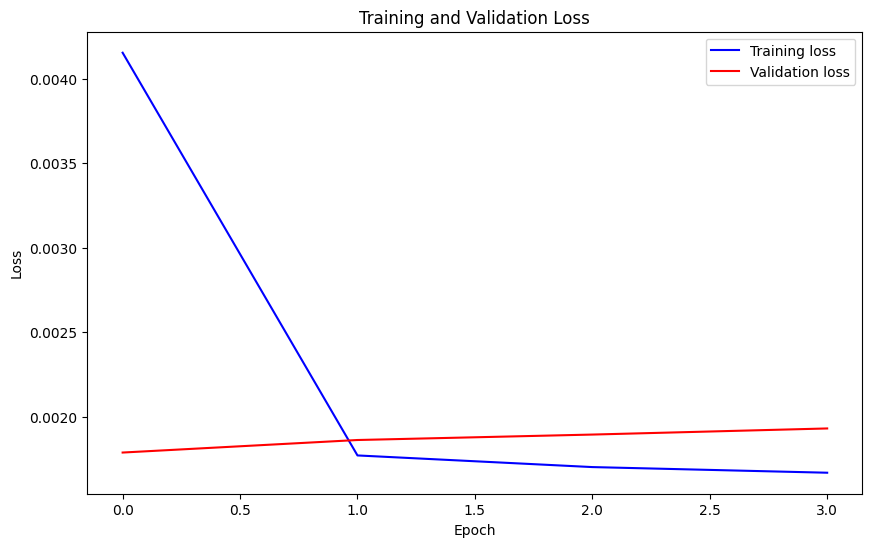

In [48]:
#The accurcay looks better now. plot losses

# train_loss_all=train_loss+more_train_loss # combine from 2 stages of training
# valid_loss_all=valid_loss+more_valid_loss

# plt.plot(train_loss_all, 'b', label='Training loss')
# plt.plot(valid_loss_all, 'r', label='Validation loss')
plt.figure(figsize=(10, 6))
plt.plot(train_loss, 'b', label='Training loss')
plt.plot(valid_loss, 'r', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [50]:
## Use a standard accuracy matrix for this model. For each questions there are 10 answer. If there are >1 unique answers, what is
## right answer to use? In training we use a probablity distribution. But for accuracy estimation the standard approach is if =>3 
## annotators gave the same answer for a question, that's the right answer. Therefore, we use following equation
## min(number of annotations gave that answer/3 ,1). So if 3 or >3 humans gave that answer, accuracy is 1, else, that number/3. 
## This way we get a very intuitive accuracy estimation.

def vqa_accuracy(predicted, target):
    """
    VQA accuracy metric: min(#humans who gave that answer / 3, 1)
    """
    batch_size = predicted.size(0)
    accuracy = 0.0
    
    for i in range(batch_size):
        # Get predicted answer
        pred_idx = torch.argmax(predicted[i]).item()
        
        # Check if this matches any ground truth answer
        accuracy += min(target[i, pred_idx].item() * 3, 1.0)
    
    return accuracy / batch_size

def evaluate_model(model, data_loader):
    model.eval()
    total_accuracy = 0.0
    num_batches = 0
    
    with torch.no_grad():
        for batch in tqdm(data_loader, desc="Evaluating"):
            # Get data
            images = batch['image'].to(device)
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            answer_weights = batch['answer_weights'].to(device)
            
            # Forward pass
            outputs = model(images, input_ids, attention_mask)
            
            # Calculate VQA accuracy
            batch_accuracy = vqa_accuracy(outputs, answer_weights)
            total_accuracy += batch_accuracy
            num_batches += 1
    
    return total_accuracy / num_batches

# Evaluate on validation set
val_accuracy = evaluate_model(model, val_loader)
print(f"Validation Accuracy: {val_accuracy:.4f}")



huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Validation Accuracy: 0.2528


In [105]:
###Validation accuracy is too low ~0.25. This is not surprising as we trained only for 4 epochs. Let's see how it performs
### on few of the example from the validation and test sets. 

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

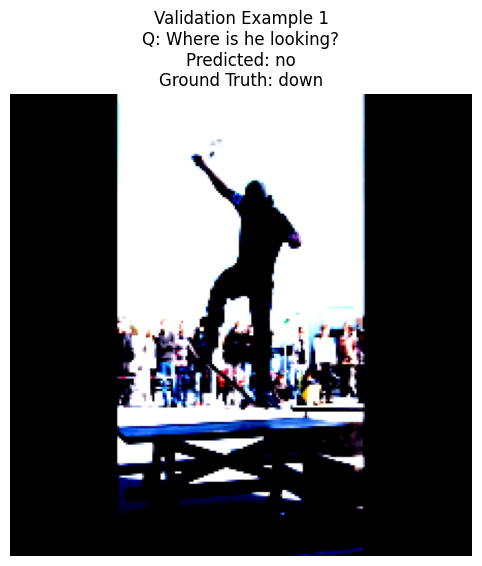

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.622571].


Validation Example 1:
Question ID: 262148000
Question: Where is he looking?
Predicted Answer: no
Ground Truth: down
---


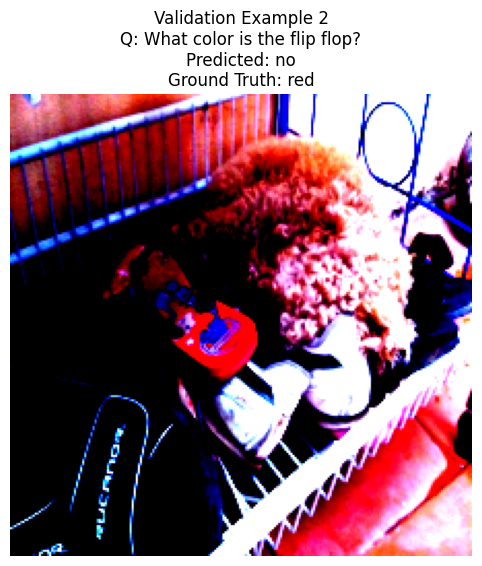

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.4110641].


Validation Example 2:
Question ID: 42002
Question: What color is the flip flop?
Predicted Answer: no
Ground Truth: red
---


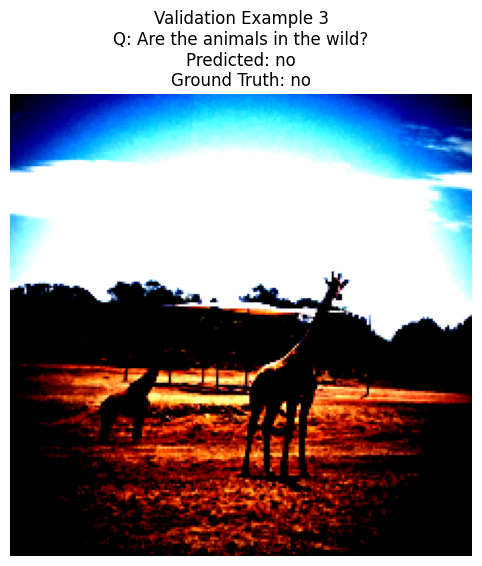

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.4831376].


Validation Example 3:
Question ID: 393282004
Question: Are the animals in the wild?
Predicted Answer: no
Ground Truth: no
---


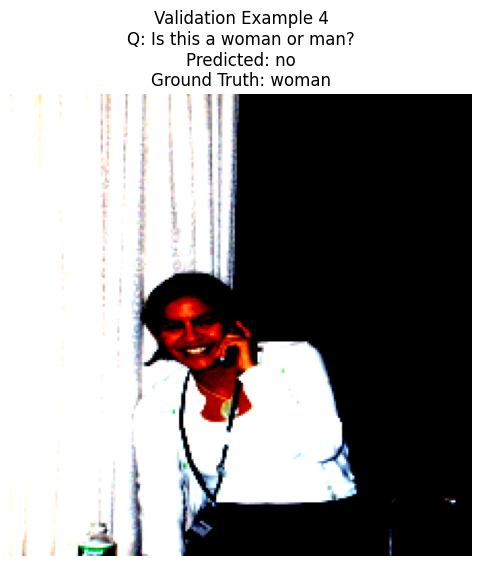

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..1.7865399].


Validation Example 4:
Question ID: 262235005
Question: Is this a woman or man?
Predicted Answer: no
Ground Truth: woman
---


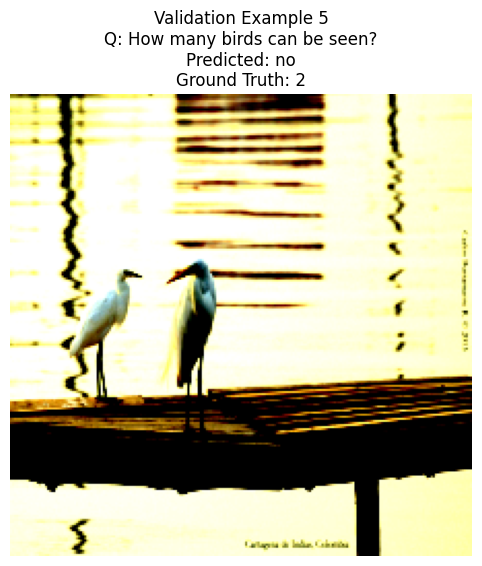

Validation Example 5:
Question ID: 131207001
Question: How many birds can be seen?
Predicted Answer: no
Ground Truth: 2
---


In [70]:
# Get a few examples from validation set
tokenizer = AutoTokenizer.from_pretrained('bert-base-uncased')

# Create index to answer mapping
idx_to_answer = {idx: ans for ans, idx in val_dataset.answer_vocab.items()}

val_examples = []
for i, batch in enumerate(val_loader):
    if i >= 5:  # Get 5 examples
        break
    
    # Get question_id to find the ground truth
    question_id = batch['question_id'][0].item()
    
    # Find matching question text for this question_id
    question_text = None
    for q in val_dataset.questions:
        if q['question_id'] == question_id:
            question_text = q['question']
            break
    
    # If question text not found, decode from input_ids as fallback
    if question_text is None:
        input_ids = batch['input_ids'][0]
        question_text = tokenizer.decode(input_ids, skip_special_tokens=True)
    
    # Find matching annotation for ground truth
    ground_truth = "Unknown"
    for ann in val_dataset.annotations:
        if ann['question_id'] == question_id:
            # Get most common answer
            answers = [a['answer'] for a in ann['answers']]
            from collections import Counter
            ground_truth = Counter(answers).most_common(1)[0][0]
            break
    
    val_examples.append({
        'image': batch['image'][0],
        'question_id': question_id,
        'question_text': question_text,
        'ground_truth': ground_truth
    })

# Run inference on validation examples
for i, example in enumerate(val_examples):
    # Get image and question
    image = example['image'].to(device)
    question = example['question_text']
    ground_truth = example['ground_truth']
    
    # Tokenize question
    question_tokens = tokenizer(
        question,
        padding='max_length',
        truncation=True,
        max_length=32,
        return_tensors='pt'
    )
    
    input_ids = question_tokens['input_ids'].to(device)
    attention_mask = question_tokens['attention_mask'].to(device)
    
    # Get prediction
    with torch.no_grad():
        output = model(image.unsqueeze(0), input_ids, attention_mask)
        predicted_idx = torch.argmax(output, dim=1).item()
    
    # Convert index to answer
    if predicted_idx in idx_to_answer:
        predicted_answer = idx_to_answer[predicted_idx]
    else:
        predicted_answer = "unknown"
    
    # Visualize
    plt.figure(figsize=(10, 6))
    plt.imshow(example['image'].permute(1, 2, 0).cpu())
    plt.title(f"Validation Example {i+1}\nQ: {question}\nPredicted: {predicted_answer}\nGround Truth: {ground_truth}")
    plt.axis('off')
    plt.show()
    
    print(f"Validation Example {i+1}:")
    print(f"Question ID: {example['question_id']}")
    print(f"Question: {question}")
    print(f"Predicted Answer: {predicted_answer}")
    print(f"Ground Truth: {ground_truth}")
    print("---")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.64].


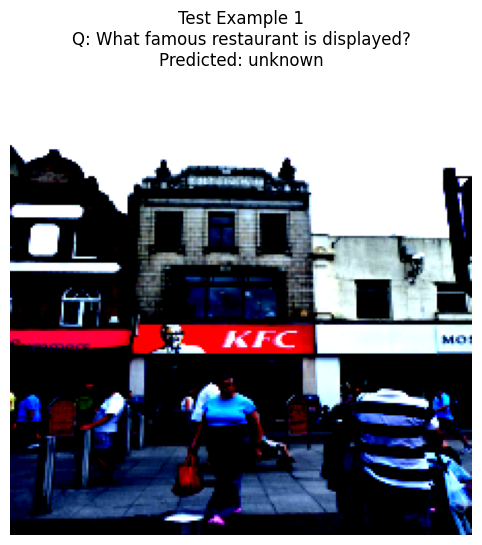

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.5179958].


Test Example 1:
Question ID: 426405003
Question: What famous restaurant is displayed?
Predicted Answer: unknown
---


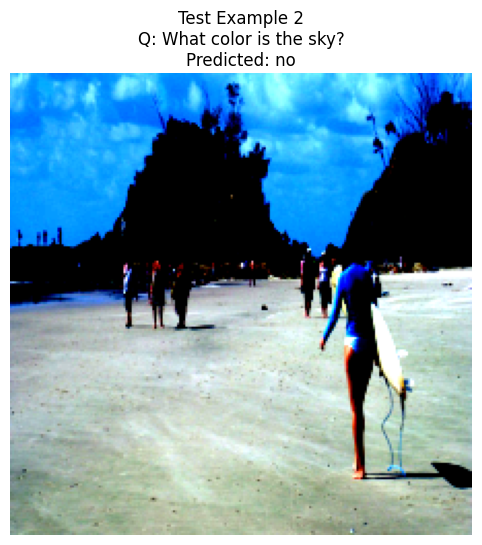

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0836544..2.4831376].


Test Example 2:
Question ID: 17568014
Question: What color is the sky?
Predicted Answer: no
---


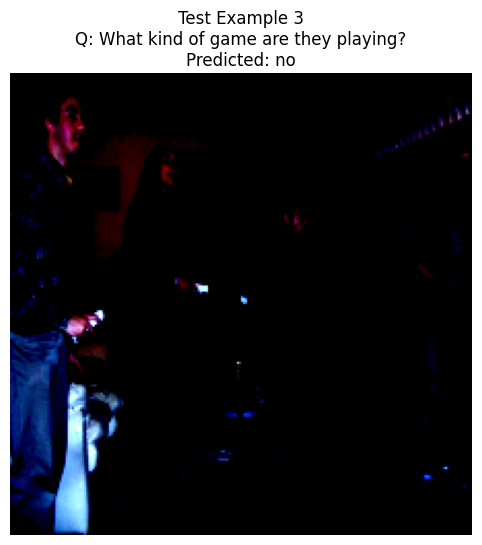

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].


Test Example 3:
Question ID: 314581014
Question: What kind of game are they playing?
Predicted Answer: no
---


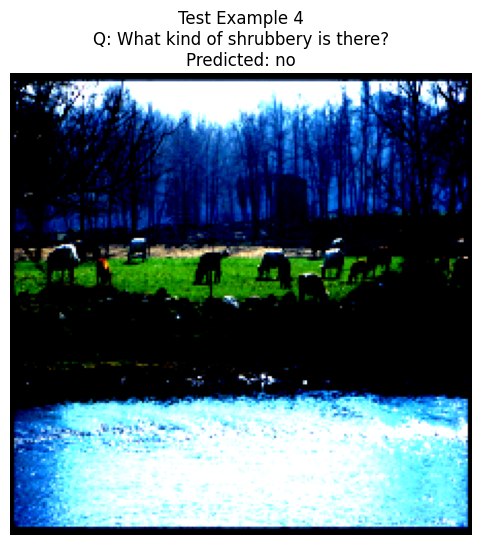

Test Example 4:
Question ID: 519261006
Question: What kind of shrubbery is there?
Predicted Answer: no
---


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].


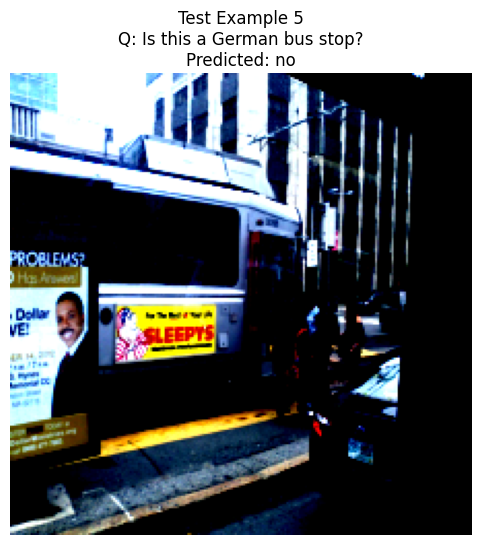

Test Example 5:
Question ID: 132602002
Question: Is this a German bus stop?
Predicted Answer: no
---


In [71]:
# Get a few examples from test set
tokenizer = AutoTokenizer.from_pretrained('bert-base-uncased')

# Create index to answer mapping
idx_to_answer = {idx: ans for ans, idx in train_dataset.answer_vocab.items()}

test_examples = []
for i, batch in enumerate(test_loader):
    if i >= 5:  # Get 5 examples
        break
    
    # Get question_id
    question_id = batch['question_id'][0].item()
    
    # Find matching question text for this question_id
    question_text = None
    for q in test_dataset.questions:
        if q['question_id'] == question_id:
            question_text = q['question']
            break
    
    # If question text not found, decode from input_ids as fallback
    if question_text is None and 'input_ids' in batch:
        input_ids = batch['input_ids'][0]
        question_text = tokenizer.decode(input_ids, skip_special_tokens=True)
    
    test_examples.append({
        'image': batch['image'][0],
        'question_id': question_id,
        'question_text': question_text
    })

# Run inference on test examples
for i, example in enumerate(test_examples):
    # Get image and question
    image = example['image'].to(device)
    question = example['question_text']
    
    # Tokenize question
    question_tokens = tokenizer(
        question,
        padding='max_length',
        truncation=True,
        max_length=32,
        return_tensors='pt'
    )
    
    input_ids = question_tokens['input_ids'].to(device)
    attention_mask = question_tokens['attention_mask'].to(device)
    
    # Get prediction
    with torch.no_grad():
        output = model(image.unsqueeze(0), input_ids, attention_mask)
        predicted_idx = torch.argmax(output, dim=1).item()
    
    # Convert index to answer
    if predicted_idx in idx_to_answer:
        predicted_answer = idx_to_answer[predicted_idx]
    else:
        predicted_answer = "unknown"
    
    # Visualize
    plt.figure(figsize=(10, 6))
    plt.imshow(example['image'].permute(1, 2, 0).cpu())
    plt.title(f"Test Example {i+1}\nQ: {question}\nPredicted: {predicted_answer}")
    plt.axis('off')
    plt.show()
    
    print(f"Test Example {i+1}:")
    print(f"Question ID: {example['question_id']}")
    print(f"Question: {question}")
    print(f"Predicted Answer: {predicted_answer}")
    print("---")

In [55]:
## Predict answer for an user provided image and questions. Can be any image and questions. How does it perform?

import requests
from io import BytesIO

def predict_answer(model, image_path, question, tokenizer, answer_vocab, device):
    # Load and preprocess image
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Handle both local paths and URLs
    if image_path.startswith('http'):
        response = requests.get(image_path)
        image = Image.open(BytesIO(response.content)).convert('RGB')
    else:
        image = Image.open(image_path).convert('RGB')
    
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Tokenize question
    question_tokens = tokenizer(
        question,
        padding='max_length',
        truncation=True,
        max_length=32,
        return_tensors='pt'
    )
    
    input_ids = question_tokens['input_ids'].to(device)
    attention_mask = question_tokens['attention_mask'].to(device)
    
    # Get prediction
    model.eval()
    with torch.no_grad():
        output = model(image_tensor, input_ids, attention_mask)
        predicted_idx = torch.argmax(output, dim=1).item()
    
    # Convert index to answer
    idx_to_answer = {idx: ans for ans, idx in answer_vocab.items()}
    if predicted_idx in idx_to_answer:
        answer = idx_to_answer[predicted_idx]
    else:
        answer = "unknown"
    
    # Visualize
    plt.figure(figsize=(10, 6))
    plt.imshow(image)
    plt.title(f"Q: {question}\nA: {answer}")
    plt.axis('off')
    plt.show()
    
    return answer

# Load checkpoint and answer vocabulary
checkpoint = torch.load('best_vqa_model.pth', map_location=device)
answer_vocab = checkpoint['answer_vocab']

# Load model with pretrained weights
model = VQAModel(num_answers=len(answer_vocab) + 1)
model.load_state_dict(checkpoint['model_state_dict'])
model.to(device)

# Example prediction
test_image = "generate_test.JPG"

tokenizer = AutoTokenizer.from_pretrained('bert-base-uncased')

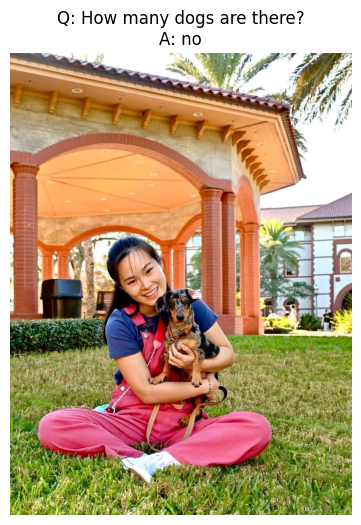

Predicted answer: no


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

In [57]:
test_question = "How many dogs are there?"
answer = predict_answer(model, test_image, test_question, tokenizer, answer_vocab, device)
print(f"Predicted answer: {answer}")
plt.figure(figsize=(10, 10))
#plt.imshow(image)

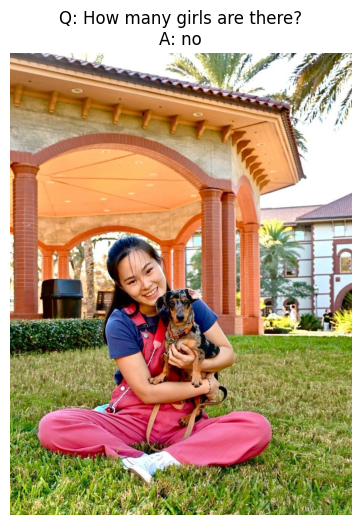

Predicted answer: no


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

In [58]:
test_question = "How many girls are there?"
answer = predict_answer(model, test_image, test_question, tokenizer, answer_vocab, device)
print(f"Predicted answer: {answer}")
plt.figure(figsize=(10, 10))
#plt.imshow(image)

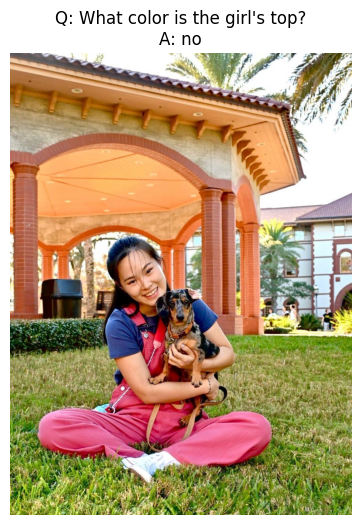

Predicted answer: no


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

In [59]:
test_question = "What color is the girl's top?"
answer = predict_answer(model, test_image, test_question, tokenizer, answer_vocab, device)
print(f"Predicted answer: {answer}")
plt.figure(figsize=(10, 10))


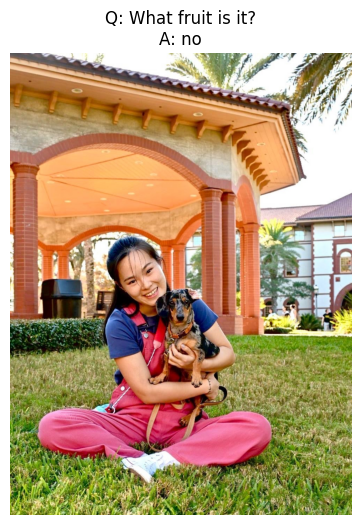

Predicted answer: no


<Figure size 1000x1000 with 0 Axes>

<Figure size 1000x1000 with 0 Axes>

In [60]:
## Ask an unrelevant question

test_question = "What fruit is it?"
answer = predict_answer(model, test_image, test_question, tokenizer, answer_vocab, device)
print(f"Predicted answer: {answer}")
plt.figure(figsize=(10, 10))


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

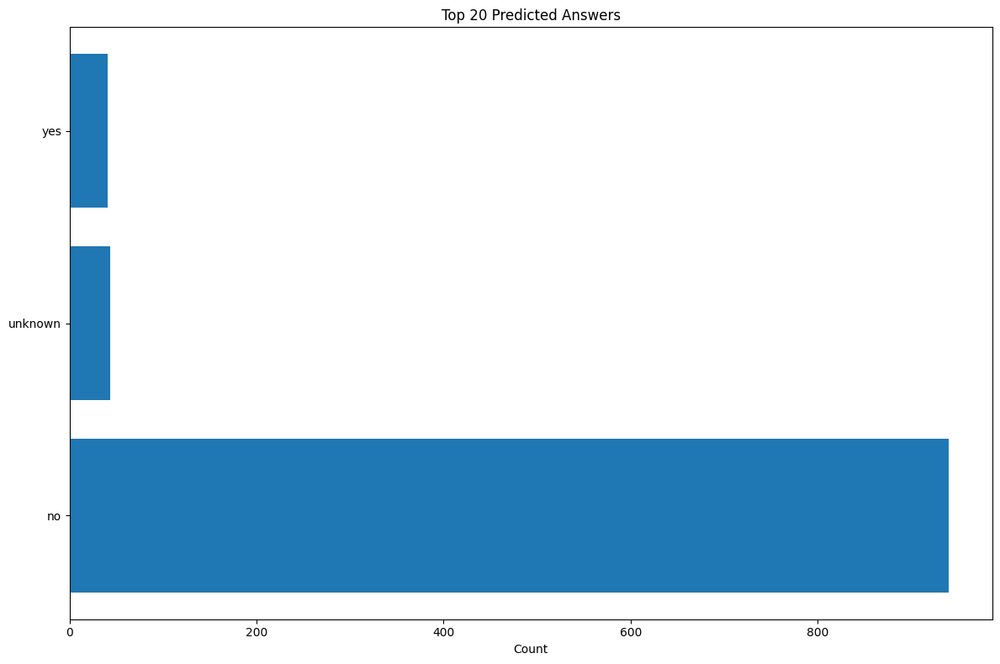

Total predictions analyzed: 1024
Unique answers predicted: 3
Top 10% of answers account for 0.00% of all predictions

Some specific answer frequencies:
'yes': 41 times
'no': 940 times
'2': 0 times
'red': 0 times
'blue': 0 times
'dog': 0 times
'cat': 0 times
'person': 0 times
'unknown': 43 times


In [72]:
### All seems "No" answer. let me see the distribution from trained model
import torch
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from collections import Counter

def analyze_prediction_distribution(model, data_loader, idx_to_answer, device, max_samples=1000):
    """Analyze the distribution of answers predicted by the model"""
    model.eval()
    predictions = []
    
    # Process batches
    with torch.no_grad():
        for i, batch in enumerate(tqdm(data_loader, desc="Analyzing predictions")):
            if i * batch['image'].size(0) >= max_samples:
                break
                
            # Get data
            images = batch['image'].to(device)
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            
            # Forward pass
            outputs = model(images, input_ids, attention_mask)
            
            # Get predicted answers
            pred_indices = torch.argmax(outputs, dim=1)
            
            # Convert to answer text
            for idx in pred_indices:
                idx = idx.item()
                if idx in idx_to_answer:
                    predictions.append(idx_to_answer[idx])
                else:
                    predictions.append("unknown")
    
    # Count predictions
    prediction_counts = Counter(predictions)
    
    # Plot top predictions
    top_k = 20  # Show top 20 most frequent answers
    top_predictions = prediction_counts.most_common(top_k)
    
    plt.figure(figsize=(12, 8))
    
    # Extract labels and values
    labels = [item[0] for item in top_predictions]
    values = [item[1] for item in top_predictions]
    
    # Create horizontal bar chart
    y_pos = np.arange(len(labels))
    plt.barh(y_pos, values)
    plt.yticks(y_pos, labels)
    plt.xlabel('Count')
    plt.title(f'Top {top_k} Predicted Answers')
    plt.tight_layout()
    plt.show()
    
    # Print statistics
    total_predictions = len(predictions)
    unique_predictions = len(prediction_counts)
    top_10_percent = sum(count for _, count in top_predictions[:int(unique_predictions * 0.1)])
    
    print(f"Total predictions analyzed: {total_predictions}")
    print(f"Unique answers predicted: {unique_predictions}")
    print(f"Top 10% of answers account for {top_10_percent/total_predictions:.2%} of all predictions")
    
    return prediction_counts

# Run the analysis on validation set
prediction_distribution = analyze_prediction_distribution(
    model=model,
    data_loader=val_loader,
    idx_to_answer=idx_to_answer,
    device=device,
    max_samples=1000  # Adjust as needed
)

# You can also look at specific predictions
print("\nSome specific answer frequencies:")
interesting_answers = ["yes", "no", "2", "red", "blue", "dog", "cat", "person", "unknown"]
for answer in interesting_answers:
    count = prediction_distribution.get(answer, 0)
    print(f"'{answer}': {count} times")

In [83]:
### The above model is not trained well. It's highly overfitted to "No" Answers for 940 cases of ~1024 cases. This is expected
### as we only trained it for 4 epochs and the Validation accuracy is very low ~20%. We need to train it more to predict
### meaningful answers. 

In [ ]:
### The above code is extremely inefficient, takes a very long time. Let's implement a more effient model. Use more efficience
### EfficientNet-B0  and DistilBERT for image and text respectively. Use mixed precision and a fewer layers. 

In [75]:
# Modified EfficientNet loading code
class VQAModel(nn.Module):
    def __init__(self, num_answers, hidden_size=512):
        super(VQAModel, self).__init__()
        
        # Image Encoder (EfficientNet-B0 instead of ResNet50)
        try:
            # First try to import directly from torchvision
            from torchvision.models import efficientnet_b0
            self.image_encoder = efficientnet_b0(pretrained=True)
            # Remove classifier layer
            self.image_encoder = nn.Sequential(*list(self.image_encoder.children())[:-1])
        except (ImportError, AttributeError):
            # Fallback to ResNet50 if EfficientNet isn't available
            print("EfficientNet not available, falling back to ResNet50")
            resnet = models.resnet50(pretrained=True)
            modules = list(resnet.children())[:-1]  # Remove final FC layer
            self.image_encoder = nn.Sequential(*modules)
            
        # Question Encoder (DistilBERT instead of BERT)
        from transformers import DistilBertModel
        self.question_encoder = DistilBertModel.from_pretrained('distilbert-base-uncased')
        
        # Projection layers
        # Check which backbone we're using to set the right input dimension
        if isinstance(self.image_encoder[0], models.resnet.ResNet):
            image_features_dim = 2048  # ResNet50
        else:
            image_features_dim = 1280  # EfficientNet-B0
            
        self.image_projection = nn.Linear(image_features_dim, hidden_size)
        self.question_projection = nn.Linear(768, hidden_size)
        
        # Cross-attention fusion
        self.cross_attention = CrossAttentionFusion(hidden_size)
        
        # Classification
        self.classifier = nn.Sequential(
            nn.Dropout(0.3),
            nn.Linear(hidden_size, hidden_size),
            nn.ReLU(),
            nn.Linear(hidden_size, num_answers)
        )
        
        # Initialize weights
        self._init_weights()
        
    def _init_weights(self):
        # Initialize linear layers with Xavier initialization
        for module in [self.image_projection, self.question_projection, self.classifier]:
            if isinstance(module, nn.Linear):
                nn.init.xavier_uniform_(module.weight)
                if module.bias is not None:
                    nn.init.zeros_(module.bias)
    
    def forward(self, image, input_ids, attention_mask):
        # Use mixed precision where supported
        with torch.cuda.amp.autocast(enabled=True):
            # Image encoding
            batch_size = image.size(0)
            image_features = self.image_encoder(image)
            if isinstance(image_features, tuple):
                image_features = image_features[0]
            image_features = image_features.reshape(batch_size, -1)
            image_features = self.image_projection(image_features)
            
            # Question encoding
            question_outputs = self.question_encoder(
                input_ids=input_ids,
                attention_mask=attention_mask
            )
            question_features = question_outputs.last_hidden_state[:, 0]  # Use first token features
            question_features = self.question_projection(question_features)
            
            # Cross-attention fusion
            fused_features = self.cross_attention(image_features, question_features)
            
            # Classification
            output = self.classifier(fused_features)
            
        return output

In [76]:
# Initialize model and train the model same way as we did earlier.

model = VQAModel(num_answers=len(train_dataset.answer_vocab) + 1)  # +1 for unknown answers
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Loss function and optimizer
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=3, factor=0.5)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /home/amondal2/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 90.2MB/s]


In [77]:
print(model)

VQAModel(
  (image_encoder): Sequential(
    (0): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU(inplace=True)
      )
      (1): Sequential(
        (0): MBConv(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
              (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): SiLU(inplace=True)
            )
            (1): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)
              (scale_activat

In [80]:
# Training loop with checkpointing
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=10):
    best_val_accuracy = 0.0
    t_loss=[]
    v_loss=[]
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        train_loss = 0.0
        
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
            # Get data
            images = batch['image'].to(device)
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            answer_weights = batch['answer_weights'].to(device)
            
            # Forward pass
            outputs = model(images, input_ids, attention_mask)
            loss = criterion(outputs, answer_weights)
            
            # Backward pass and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
        
        avg_train_loss = train_loss / len(train_loader)
        t_loss.append(avg_train_loss)
        # Validation phase
        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            for batch in tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Validation"):
                # Get data
                images = batch['image'].to(device)
                input_ids = batch['input_ids'].to(device)
                attention_mask = batch['attention_mask'].to(device)
                answer_weights = batch['answer_weights'].to(device)
                
                # Forward pass
                outputs = model(images, input_ids, attention_mask)
                loss = criterion(outputs, answer_weights)
                val_loss += loss.item()
                
                # Calculate accuracy (VQA accuracy metric)
                pred_indices = torch.argmax(outputs, dim=1)
                ground_truth_indices = torch.argmax(answer_weights, dim=1)
                correct += (pred_indices == ground_truth_indices).sum().item()
                total += images.size(0)
        
        avg_val_loss = val_loss / len(val_loader)
        val_accuracy = 100 * correct / total
        v_loss.append(avg_val_loss)
        print(f"Epoch {epoch+1}/{num_epochs}")
        print(f"Training Loss: {avg_train_loss:.4f}")
        print(f"Validation Loss: {avg_val_loss:.4f}")
        print(f"Validation Accuracy: {val_accuracy:.2f}%")
        
        # Update learning rate
        scheduler.step(avg_val_loss)
        # Save model every 5 epochs
        if (epoch + 1) % 5 == 0:
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_accuracy': val_accuracy,
                'train_loss': avg_train_loss,
                'val_loss': avg_val_loss,
                'answer_vocab': train_dataset.answer_vocab
            }, f'efficient_vqa_model_epoch_{epoch+1}.pth')
            print(f"Saved model checkpoint at epoch {epoch+1}")
        
        # Save best model
        if val_accuracy > best_val_accuracy:
            best_val_accuracy = val_accuracy
            torch.save({
                'epoch': epoch,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                'val_accuracy': val_accuracy,
                'answer_vocab': train_dataset.answer_vocab
            }, 'efficient_best_vqa_model.pth')
            print(f"Saved new best model with accuracy: {val_accuracy:.2f}%")
    
    return model, t_loss,v_loss

In [ ]:
#training
model,train_loss,valid_loss = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=20)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [ ]:
## Train 5 more epochs
#model, more_train_loss, more_valid_loss = train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs=5)  # Add 6 more epochs


In [ ]:
#The accurcay looks better now. plot losses

# train_loss_all=train_loss+more_train_loss # combine from 2 stages of training
# valid_loss_all=valid_loss+more_valid_loss

# plt.plot(train_loss_all, 'b', label='Training loss')
# plt.plot(valid_loss_all, 'r', label='Validation loss')
plt.figure(figsize=(10, 6))
plt.plot(train_loss, 'b', label='Training loss')
plt.plot(valid_loss, 'r', label='Validation loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# Evaluate on validation set
val_accuracy = evaluate_model(model, val_loader)
print(f"Validation Accuracy: {val_accuracy:.4f}")

In [ ]:
## How does it perform on the random 5 from the validation set? We do know the right answes here.
# Get a few examples from validation set
val_examples = []
for i, batch in enumerate(val_loader):
    if i >= 5:  # Get 5 examples
        break
    
    # Get question_id to find the ground truth
    question_id = batch['question_id'][0].item()
    
    # Find matching annotation for ground truth
    ground_truth = "Unknown"
    for ann in val_dataset.annotations:
        if ann['question_id'] == question_id:
            # Get most common answer
            answers = [a['answer'] for a in ann['answers']]
            from collections import Counter
            ground_truth = Counter(answers).most_common(1)[0][0]
            break
    
    val_examples.append({
        'image': batch['image'][0],
        'question_id': question_id,
        'question_text': val_dataset.questions[i]['question'],
        'ground_truth': ground_truth
    })

# Run inference on validation examples
for i, example in enumerate(val_examples):
    # Get image and question
    image = example['image'].to(device)
    question = example['question_text']
    ground_truth = example['ground_truth']
    
    # Tokenize question
    question_tokens = tokenizer(
        question,
        padding='max_length',
        truncation=True,
        max_length=32,
        return_tensors='pt'
    )
    
    input_ids = question_tokens['input_ids'].to(device)
    attention_mask = question_tokens['attention_mask'].to(device)
    
    # Get prediction
    with torch.no_grad():
        output = model(image.unsqueeze(0), input_ids, attention_mask)
        predicted_idx = torch.argmax(output, dim=1).item()
    
    # Convert index to answer
    if predicted_idx in idx_to_answer:
        predicted_answer = idx_to_answer[predicted_idx]
    else:
        predicted_answer = "unknown"
    
    # Visualize
    plt.figure(figsize=(10, 6))
    plt.imshow(example['image'].permute(1, 2, 0).cpu())
    plt.title(f"Validation Example {i+1}\nQ: {question}\nPredicted: {predicted_answer}\nGround Truth: {ground_truth}")
    plt.axis('off')
    plt.show()
    
    print(f"Validation Example {i+1}:")
    print(f"Question ID: {example['question_id']}")
    print(f"Question: {question}")
    print(f"Predicted Answer: {predicted_answer}")
    print(f"Ground Truth: {ground_truth}")
    print("---")